In [1]:
from matplotlib import pyplot as plt
from PIL import Image
import keras_ocr
import cv2
import math
from utils import *
import numpy as np
from segment_anything import SamPredictor, sam_model_registry
import json
import numpy as np
from helper_code.full_extraction_pipeline import do_analysis
from helper_code.bounding_box import *
import cv2
import numpy as np
import matplotlib.pyplot as plt
from roboflow import Roboflow
from helper_code.full_extraction_pipeline import is_valid_color
import matplotlib.patches as patches

In [2]:
sam = sam_model_registry["default"](checkpoint="../../../Downloads/sam_vit_h_4b8939.pth")
predictor = SamPredictor(sam)

In [3]:
rf = Roboflow(ROBOFLOW_API_KEY)
project = rf.workspace().project("legend_classified")
model = project.version(5).model

loading Roboflow workspace...
loading Roboflow project...


In [4]:
pipeline = keras_ocr.pipeline.Pipeline()

Looking for /Users/sejalgupta/.keras-ocr/craft_mlt_25k.h5
Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.BILINEAR...)` instead.
Looking for /Users/sejalgupta/.keras-ocr/crnn_kurapan.h5


In [5]:
def is_number(s):
    if s == '0':
        return True
    try:
        float(s)
        return True
    
    except ValueError:
        return False

def find_nearest_y_candidate(ocr_results, point):
    nearest = None
    min_distance = float('inf')

    for text, coords in ocr_results:
        x, y = get_mean_coordinate(coords)
        if x < point[0] and is_number(text):
            distance = abs(y - point[1])
            if distance < min_distance:
                min_distance = distance
                if text == 'o':
                    text = '0'
                nearest = {'text': text, 'coords': coords}

    return nearest

def find_nearest_x_candidate(ocr_results, point):
    nearest = None
    min_distance = float('inf')

    for text, coords in ocr_results:
        x, y = get_mean_coordinate(coords)
        if y >= point[1] and is_number(text):
            distance = abs(x - point[0])
            if distance < min_distance:
                min_distance = distance
                if text == 'o':
                    text = '0'
                nearest = {'text': text, 'coords': coords}

    return nearest

def get_mean_coordinate(coords):
    x, y = 0, 0
    for coord in coords:
        x += coord[0]
        y += coord[1]
    x /= len(coords)
    y /= len(coords)
    return (x, y)

def calculate_y_axis(ocr_results, bounding_box, chat_gpt_info):
    top_left = [bounding_box['topLeft'][0], bounding_box['topLeft'][1]]
    bottom_left = [bounding_box['topLeft'][0], bounding_box['bottomRight'][1]]

    rmax = find_nearest_y_candidate(ocr_results, top_left)
    rmin = find_nearest_y_candidate(ocr_results, bottom_left)

    if rmin and rmax:
        print("Y MIN", rmin["text"])
        print("Y MAX", rmax["text"])

        try:
            y_sb = float(rmin["text"])
        except ValueError:
            print("error with value on y min")
            y_sb = float(chat_gpt_info[0])

        try:
            y_sa = float(rmax["text"])
        except ValueError:
            print("error with value on y max")
            y_sa = float(chat_gpt_info[1])
        print("SEMANTIC Y MIN", y_sb)
        print("SEMANTIC Y MAX", y_sa)

        y_b_min = get_mean_coordinate(rmin['coords'])[1]
        y_a_max = get_mean_coordinate(rmax['coords'])[1]

        print("Y")
        print("OCR DIFF", y_a_max - y_b_min)
        print("SEM DIFF", y_sa - y_sb)
        
        ratio = (y_b_min - y_a_max)/(y_sb - y_sa)
        print("OCR RATIO", ratio)

        bounding_box_pixel_difference = bounding_box['topLeft'][1] - bounding_box['bottomRight'][1]
        real_difference = bounding_box_pixel_difference/ratio

        pixel_diff_from_base_point = (y_b_min - bounding_box['bottomRight'][1])
        print("PIXEL DIFF", pixel_diff_from_base_point)

        real_y_diff_from_base_point = pixel_diff_from_base_point/ratio 
        print("REAL DIFF FROM BASE POINT", real_y_diff_from_base_point)
        
        y_min = y_sb - real_y_diff_from_base_point
        y_max = y_min + real_difference

        print("Y_MIN", y_min)
        print("Y_MAX", y_max)

        return y_min, y_max, ratio
    else:
        return None, None, None

def calculate_x_axis(ocr_results, bounding_box, chat_gpt_info):
    bottom_left = [bounding_box['topLeft'][0], bounding_box['bottomRight'][1]]
    bottom_right = [bounding_box['bottomRight'][0], bounding_box['bottomRight'][1]]

    rmin = find_nearest_x_candidate(ocr_results, bottom_left)
    rmax = find_nearest_x_candidate(ocr_results, bottom_right)

    if rmin and rmax:
        try:
            x_sb = float(rmin["text"])
        except ValueError:
            print("error with value on x min")
            x_sb = float(chat_gpt_info[0])

        try:
            x_sa = float(rmax["text"])
        except ValueError:
            print("error with value on x max")
            x_sa = float(chat_gpt_info[1])

        print("SEMANTIC X MIN", x_sb)
        print("SEMANTIC X MAX", x_sa)

        x_b_min = get_mean_coordinate(rmin['coords'])[0]
        x_a_max = get_mean_coordinate(rmax['coords'])[0]

        print("X")
        print("OCR DIFF", x_a_max - x_b_min)
        print("SEM DIFF", x_sa - x_sb)

        ratio = (x_sa - x_sb)/(x_a_max - x_b_min)
        print("OCR RATIO", ratio)

        chart_width = bottom_right[0] - bottom_left[0]
        real_difference = chart_width * ratio

        pixel_diff_from_base_point = (x_b_min - bounding_box['topLeft'][0])
        print("PIXEL DIFF", pixel_diff_from_base_point)
        
        real_x_diff_from_base_point = pixel_diff_from_base_point * ratio 
        print("REAL DIFF FROM BASE POINT", real_x_diff_from_base_point)
        
        x_min = x_sb - real_x_diff_from_base_point
        x_max = x_min + real_difference

        print("X_MIN", x_min)
        print("X_MAX", x_max)
        
        return x_min, x_max, ratio
    else:
        return None, None, None

In [6]:
def get_true_range(image_name, boundingBox, ocr_pipeline, chat_gpt_info):
    img = keras_ocr.tools.read(image_name)
    prediction_groups = ocr_pipeline.recognize([img])
    ocr_results = prediction_groups[0]

    # Assuming 'img' is your loaded image and 'ocr_results' contains the OCR results.
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img)

    for text, box in ocr_results:
        # Extract the bounding box coordinates
        start_point = box[0]
        end_point = box[2]
        box_width = end_point[0] - start_point[0]
        box_height = end_point[1] - start_point[1]
        
        # Create a Rectangle patch
        rect = patches.Rectangle(start_point, box_width, box_height, linewidth=1, edgecolor='r', facecolor='none')
        
        # Add the rectangle to the Axes
        ax.add_patch(rect)
        
        # Annotate the image with the OCR'ed text
        ax.text(start_point[0], start_point[1] - 10, text, bbox=dict(fill=False, edgecolor='red', linewidth=2), color='red')

    plt.axis('off')  # Turn off axis numbers and ticks
    plt.show()

    try:
        ymin, ymax, y_scale = calculate_y_axis(ocr_results, boundingBox, chat_gpt_info['y'])
    except:
        ymin, ymax = None, None

    try:
        xmin, xmax, x_scale = calculate_x_axis(ocr_results, boundingBox, chat_gpt_info['x'])
    except:
        xmin, xmax = None, None

    x_range = []
    for x in [xmin, xmax]:
        if x is None or np.isnan(x) or not np.isfinite(x):
            x_range = chat_gpt_info['x']
            print("x is in fault condition")
            break
        
        x_range.append(x)
    
    y_range = []
    for y in [ymin, ymax]:
        if y is None or np.isnan(y) or not np.isfinite(y):
            y_range = chat_gpt_info['y']
            print("y is in fault condition")
            break

        y_range.append(y)


    return x_range, y_range

In [7]:
def get_bounding_box(image_num, predictor):
    image_name, intersection_points = get_intersection_points(image_num)
    # Assuming we have four intersection points
    if len(intersection_points) == 4:
        # Sort points for consistency: [top-left, top-right, bottom-left, bottom-right]
        intersection_points.sort(key=lambda x: (x[1], x[0]))

        width = distance(intersection_points[0], intersection_points[1])
        height = distance(intersection_points[0], intersection_points[2])
        area = width * height

        image = cv2.imread(image_name)
        if area > .5 * image.shape[0] * image.shape[1]:
            topLeft = min(intersection_points, key=lambda p: (p[0], p[1]))
            bottomRight = max(intersection_points, key=lambda p: (p[0], p[1]))

            bounding_box = {'topLeft': topLeft, 'bottomRight': bottomRight}
            return image_name, bounding_box
    
    image_name, bounding_box = do_analysis(image_num, predictor)
    return image_name, bounding_box

In [8]:
from helper_code.color_detection import alter_image, get_color_masks
from helper_code.full_extraction_pipeline import get_points_new

def do_complete_analysis(wBox, hBox, metadata, image_name, boundingBox, ocr_pipeline, extra_info = None, image_alter = True, margin = 10):

    x_axis = metadata["x-axis"]["range"]
    y_axis = metadata["y-axis"]["range"]
    x_axis_title = metadata["x-axis"]["title"]
    y_axis_title = metadata["y-axis"]["title"]

    true_x_range, true_y_range = get_true_range(image_name, boundingBox, ocr_pipeline, {'x': x_axis, 'y': y_axis})
    
    print("X")
    print("Predicted", true_x_range)
    print("Chat GPT", x_axis)

    print("Y")
    print("Predicted", true_y_range)
    print("Chat GPT", y_axis)

    axis_labels = []
    rgb_colors = []
    coordinates = []
    for label, color in metadata["types"]:
        axis_labels.append(label)
        rgb_colors.append(color)
    
    image = None
    if image_alter:
        image = alter_image(image_name, "Contrast")
    else:
        image = alter_image(image_name, "")
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    
    color_masks, width, height, memo = get_color_masks(image, rgb_colors, boundingBox, margin)

    for color in rgb_colors:
        coordinates.append(get_points_new(color_masks, width, height, boundingBox, color, wBox, hBox, true_x_range, true_y_range, extra_info))

    return coordinates, x_axis_title, y_axis_title, axis_labels, rgb_colors, true_x_range, true_y_range, memo

In [9]:
from helper_code.legend_extraction import extracted_mask

def get_reconstructed_plot(image_num, sam_predictor, yolo_model, ocr_pipeline, image_alter, margin):
    prompt = {}
    with open('../plot_json/'+str(image_num)+'.json', 'r') as file:
        prompt = json.load(file)
    
    image_name, boundingBox = get_bounding_box(image_num, sam_predictor)

    image = cv2.imread(image_name)
    cv2.rectangle(image, boundingBox['topLeft'], boundingBox['bottomRight'], (0, 0, 255), 2)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f'Bounding Box in Image {image_num}')
    plt.show()
    
    extra_info = extracted_mask(image_name, yolo_model)
    coordinates, x_axis_title, y_axis_title, axis_labels, rgb_colors, x_range, y_range, memo = do_complete_analysis(1, 1, prompt, image_name, boundingBox, ocr_pipeline, extra_info, image_alter, margin)

    return coordinates, x_axis_title, y_axis_title, axis_labels, rgb_colors, x_range, y_range, memo

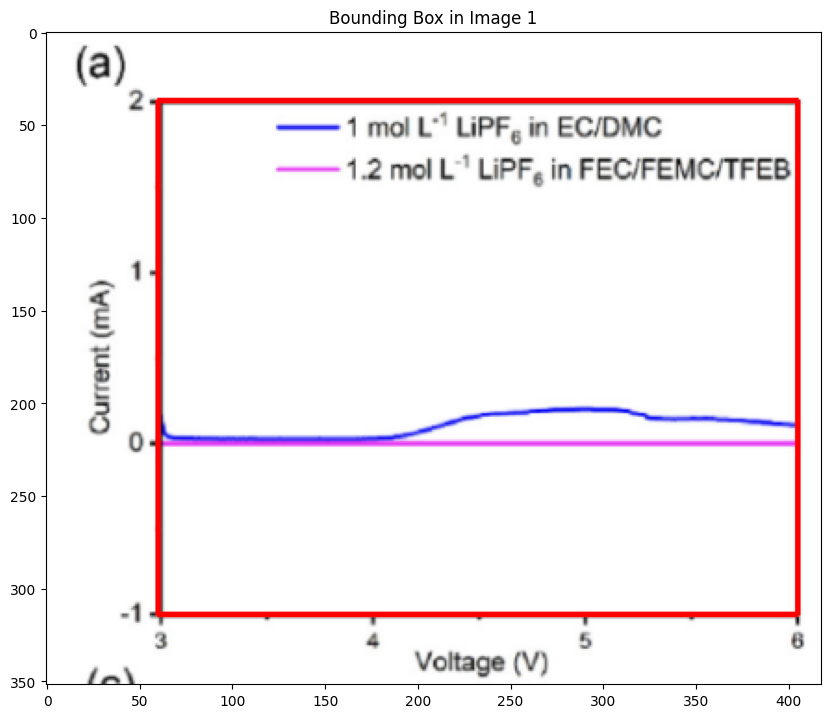

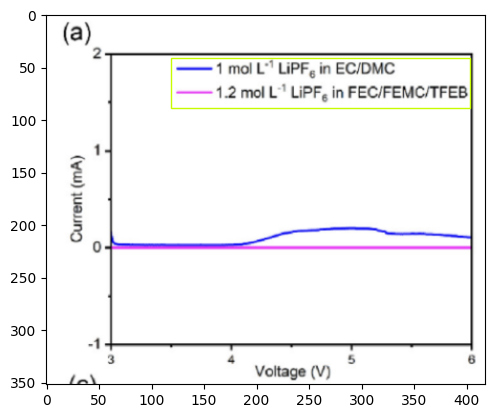

1/1 [==============================] - 2s 2s/step


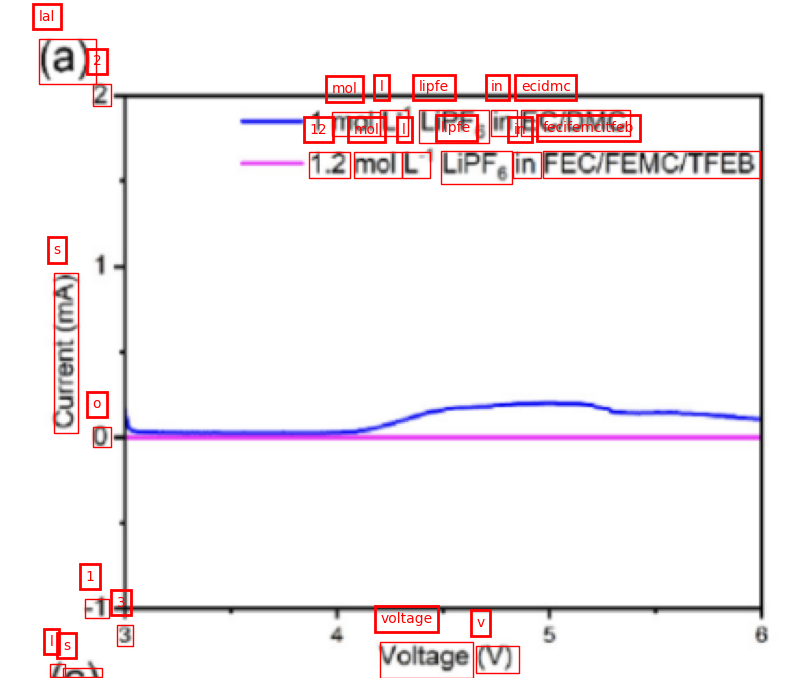

Y MIN 1
Y MAX 2
SEMANTIC Y MIN 1.0
SEMANTIC Y MAX 2.0
Y
OCR DIFF -277.0
SEM DIFF 1.0
OCR RATIO -277.0
PIXEL DIFF 0.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 1.0
Y_MAX 2.0
SEMANTIC X MIN 3.0
SEMANTIC X MAX 3.0
X
OCR DIFF 0.0
SEM DIFF 0.0
OCR RATIO nan
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT nan
X_MIN nan
X_MAX nan
x is in fault condition
X
Predicted [3, 6]
Chat GPT [3, 6]
Y
Predicted [1.0, 2.0]
Chat GPT [-1, 2]


invalid value encountered in scalar divide


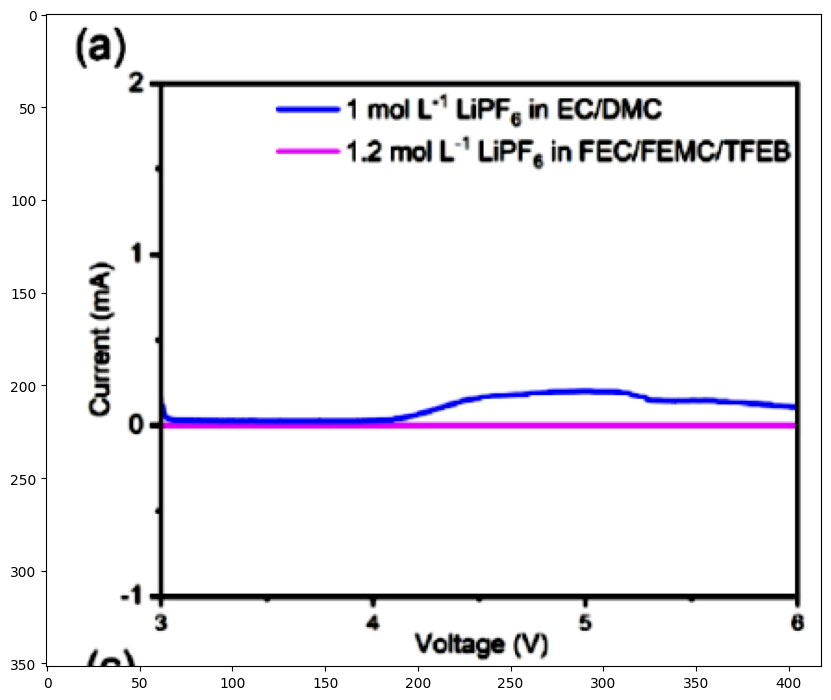

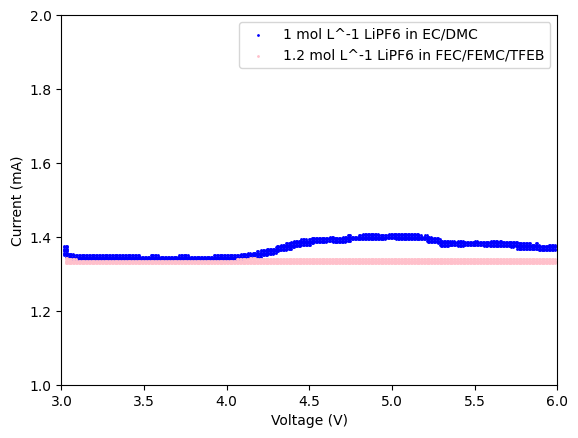

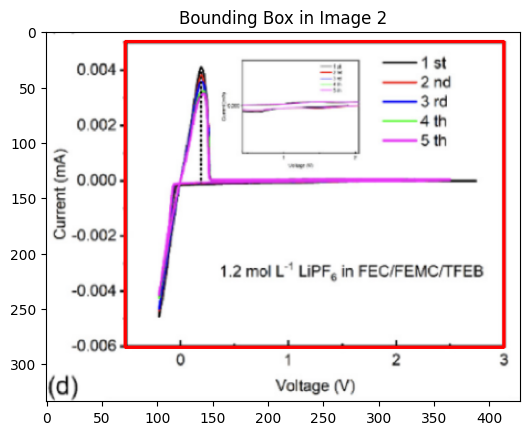

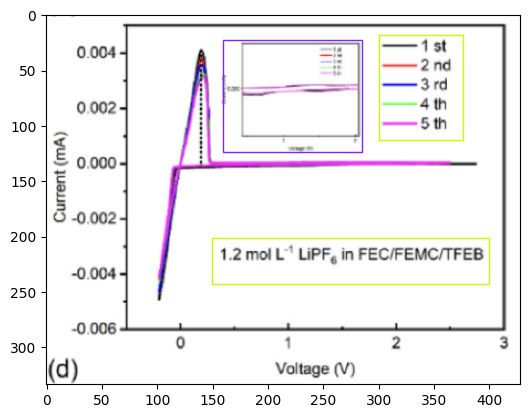

1/1 [==============================] - 1s 1s/step


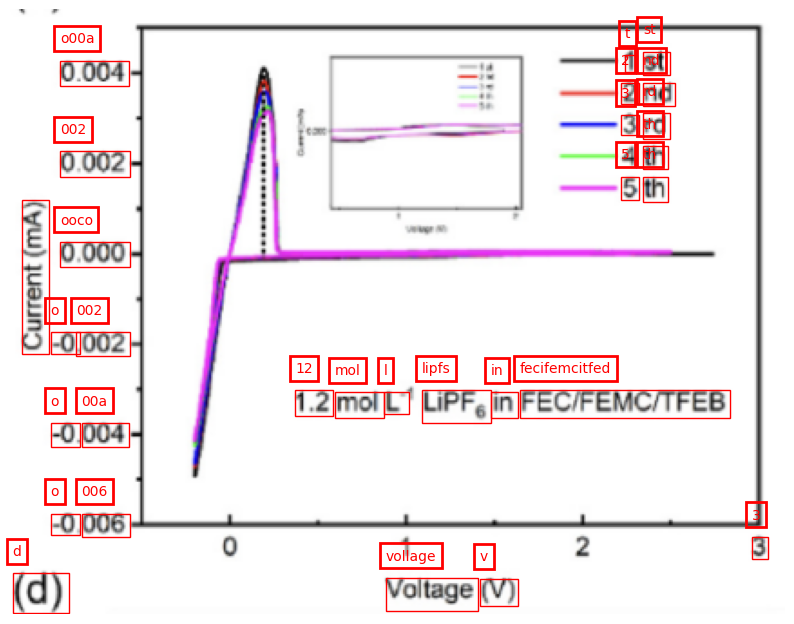

Y MIN 006
Y MAX 002
SEMANTIC Y MIN 6.0
SEMANTIC Y MAX 2.0
Y
OCR DIFF -199.5
SEM DIFF -4.0
OCR RATIO 49.875
PIXEL DIFF -0.5
REAL DIFF FROM BASE POINT -0.010025062656641603
Y_MIN 6.010025062656641
Y_MAX 0.4761904761904763
SEMANTIC X MIN 3.0
SEMANTIC X MAX 3.0
X
OCR DIFF 0.0
SEM DIFF 0.0
OCR RATIO nan
PIXEL DIFF 342.5
REAL DIFF FROM BASE POINT nan
X_MIN nan
X_MAX nan
x is in fault condition
X
Predicted [0, 3]
Chat GPT [0, 3]
Y
Predicted [6.010025062656641, 0.4761904761904763]
Chat GPT [-0.006, 0.004]


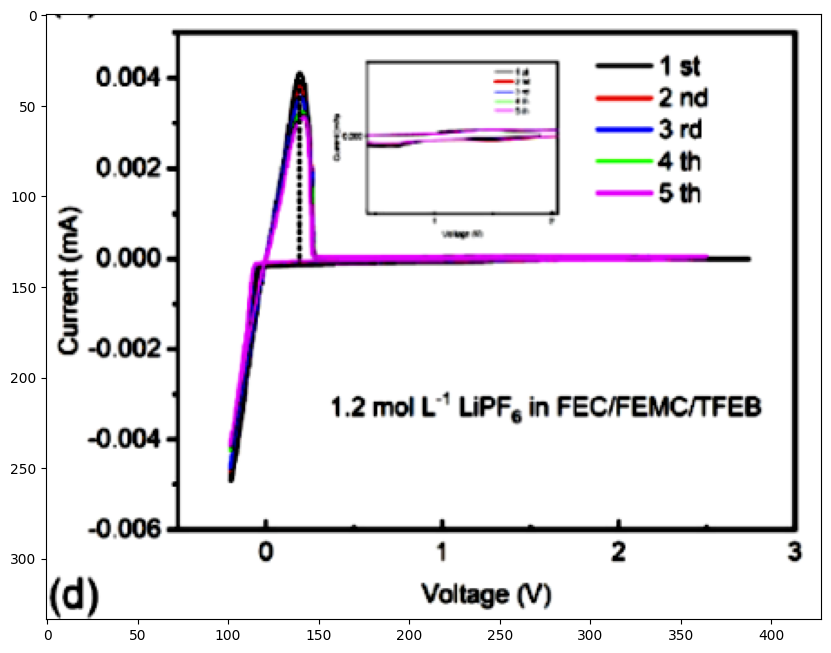

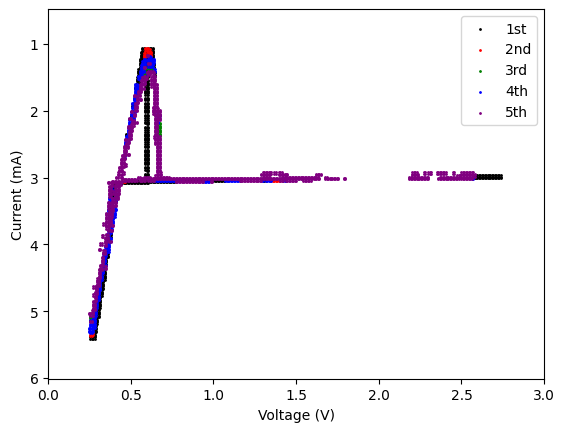

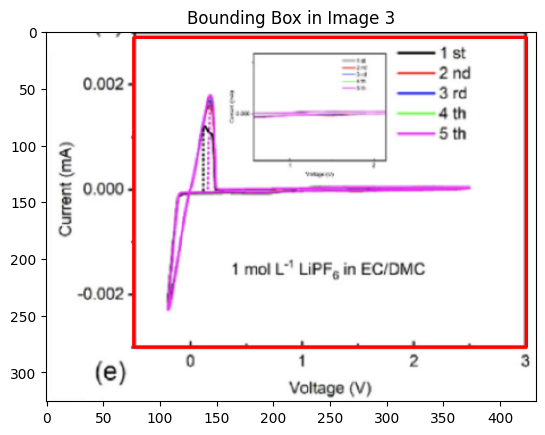

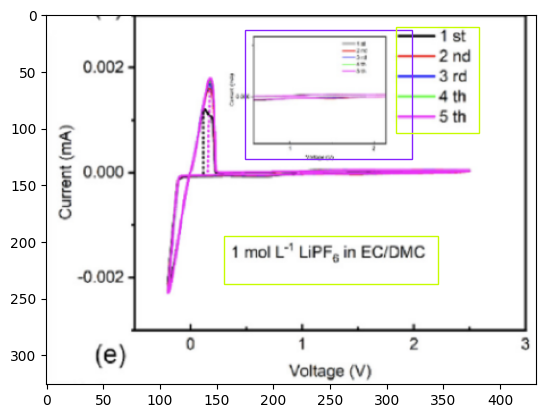

1/1 [==============================] - 1s 1s/step


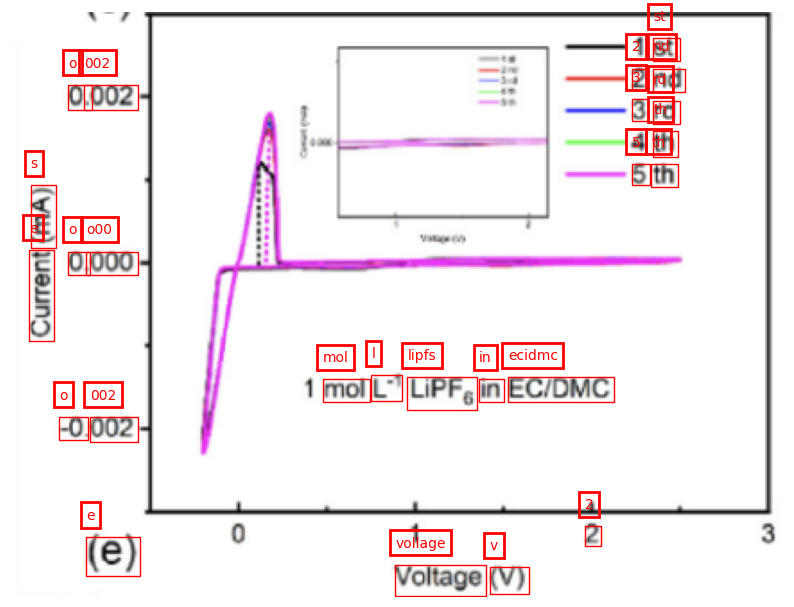

Y MIN 002
Y MAX 002
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 2.0
Y
OCR DIFF -185.0
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -46.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 2.0
Y_MAX 2.0
SEMANTIC X MIN 2.0
SEMANTIC X MAX 2.0
X
OCR DIFF 0.0
SEM DIFF 0.0
OCR RATIO nan
PIXEL DIFF 247.5
REAL DIFF FROM BASE POINT nan
X_MIN nan
X_MAX nan
x is in fault condition
X
Predicted [0, 3]
Chat GPT [0, 3]
Y
Predicted [2.0, 2.0]
Chat GPT [-0.002, 0.002]


divide by zero encountered in scalar divide
Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


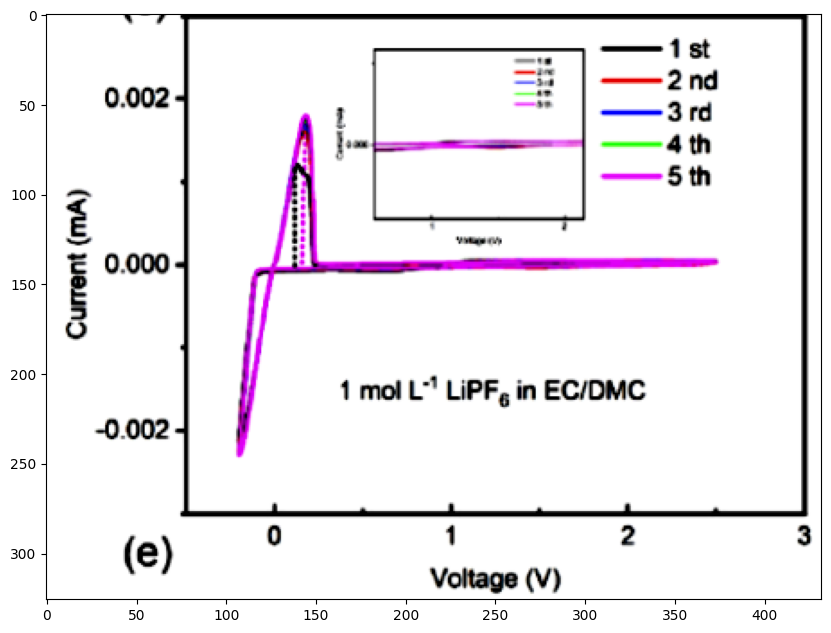

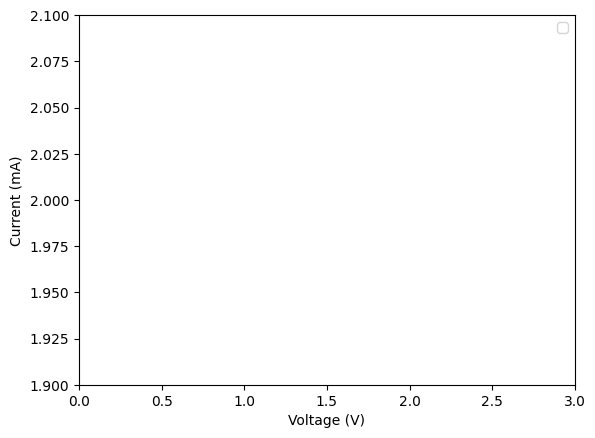

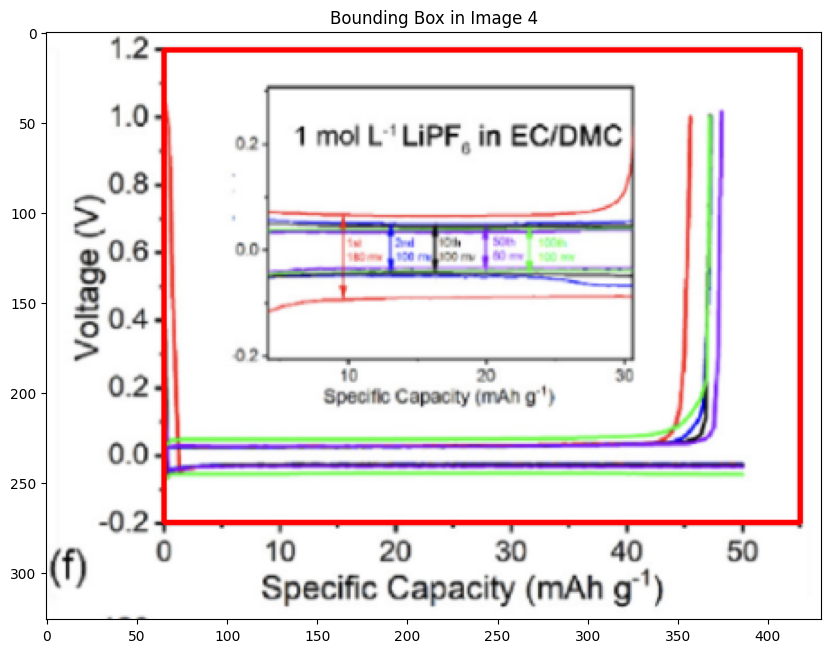

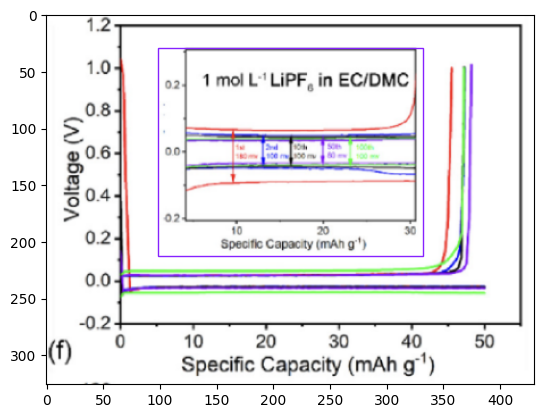

2/2 [==============================] - 2s 98ms/step


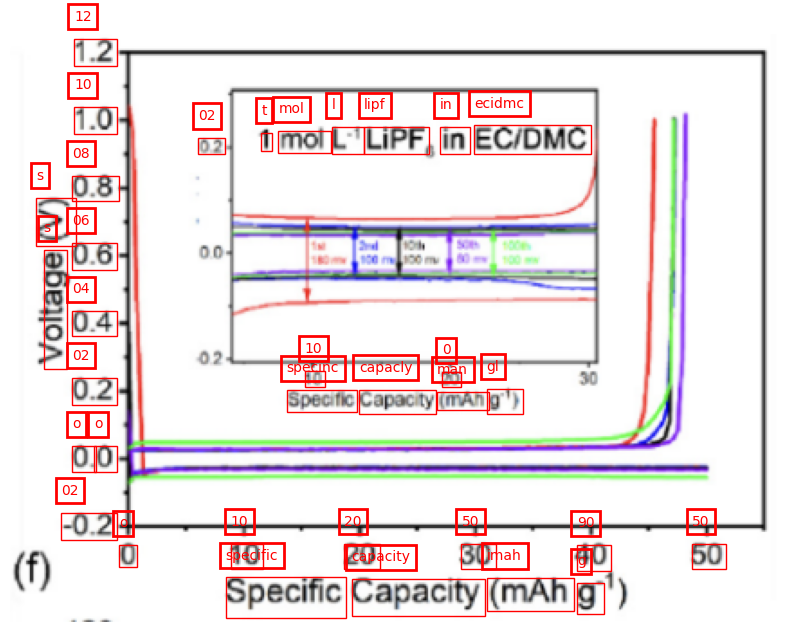

Y MIN 02
Y MAX 12
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 12.0
Y
OCR DIFF -263.0
SEM DIFF 10.0
OCR RATIO -26.3
PIXEL DIFF 0.5
REAL DIFF FROM BASE POINT -0.019011406844106463
Y_MIN 2.0190114068441063
Y_MAX 11.980988593155892
SEMANTIC X MIN 2.0
SEMANTIC X MAX 50.0
X
OCR DIFF 344.0
SEM DIFF 48.0
OCR RATIO 0.13953488372093023
PIXEL DIFF -21.5
REAL DIFF FROM BASE POINT -3.0
X_MIN 5.0
X_MAX 54.25581395348837
X
Predicted [5.0, 54.25581395348837]
Chat GPT [0, 50]
Y
Predicted [2.0190114068441063, 11.980988593155892]
Chat GPT [-0.2, 1.2]


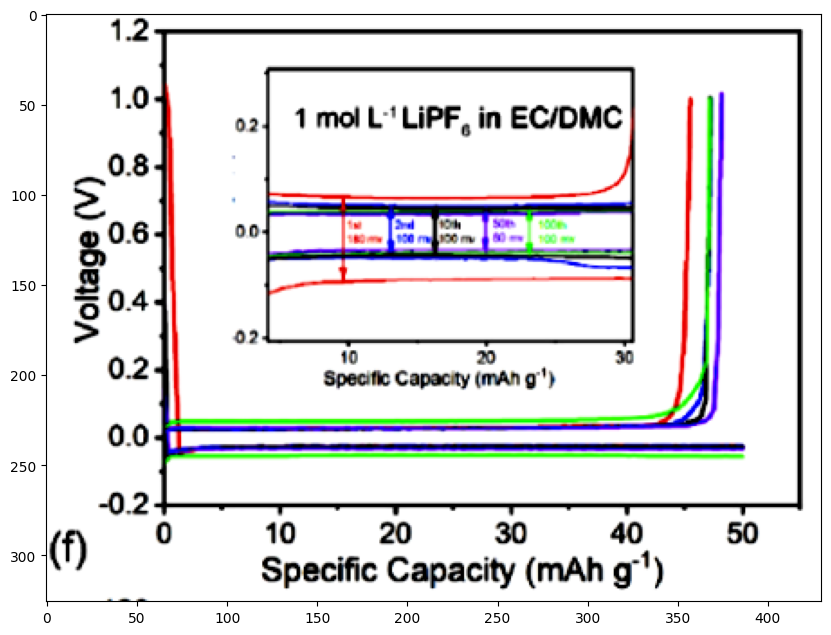

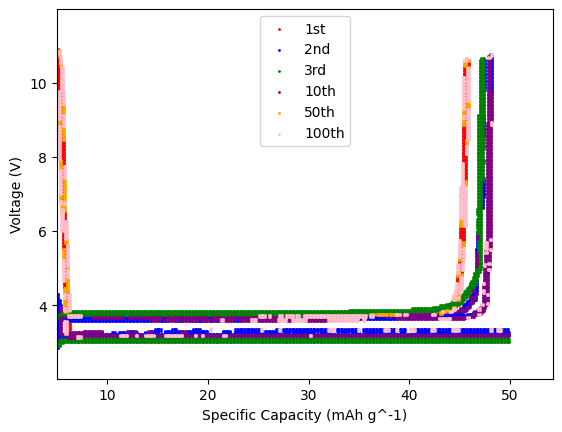

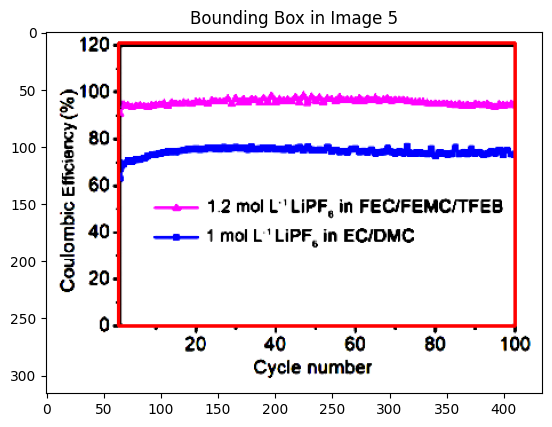

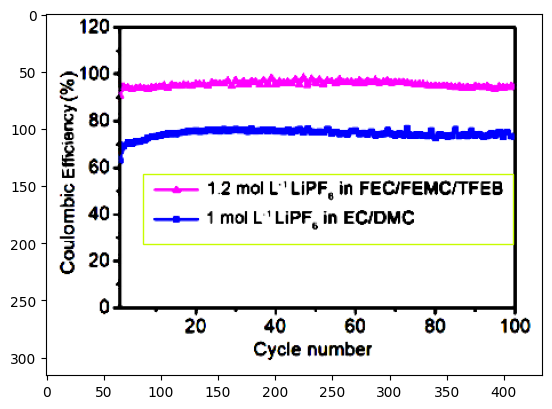

1/1 [==============================] - 1s 1s/step


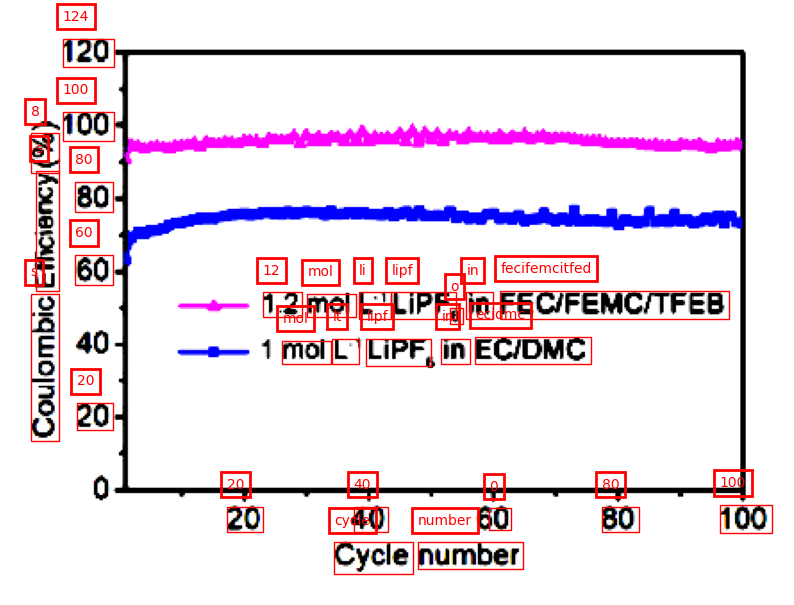

Y MIN 20
Y MAX 124
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 124.0
Y
OCR DIFF -203.5
SEM DIFF 104.0
OCR RATIO -1.9567307692307692
PIXEL DIFF -41.5
REAL DIFF FROM BASE POINT 21.208845208845208
Y_MIN -1.208845208845208
Y_MAX 125.02211302211303
SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 280.5
SEM DIFF 80.0
OCR RATIO 0.28520499108734404
PIXEL DIFF 68.0
REAL DIFF FROM BASE POINT 19.393939393939394
X_MIN 0.6060606060606055
X_MAX 99.57219251336899
X
Predicted [0.6060606060606055, 99.57219251336899]
Chat GPT [0, 100]
Y
Predicted [-1.208845208845208, 125.02211302211303]
Chat GPT [20, 120]


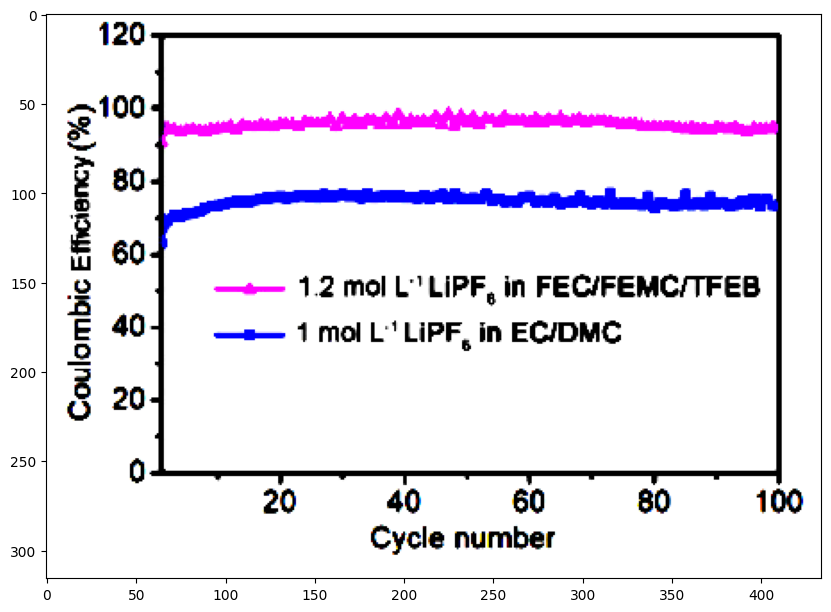

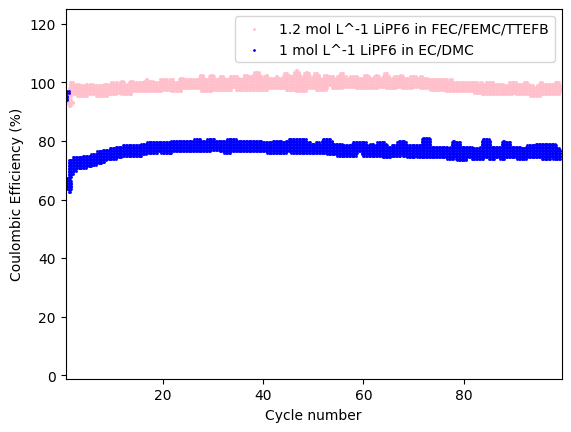

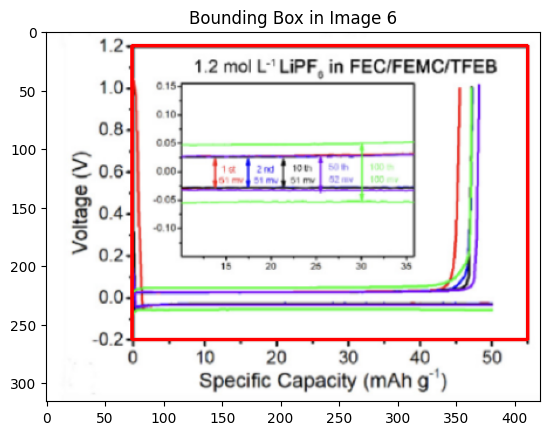

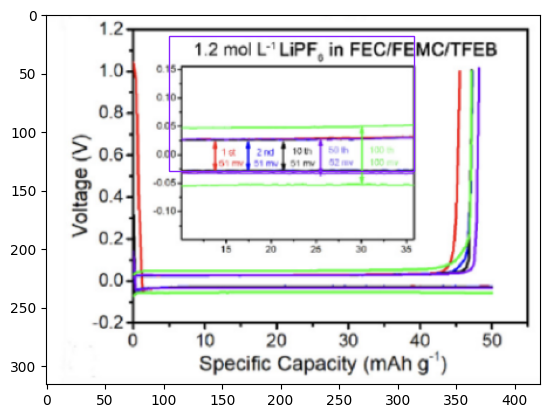

2/2 [==============================] - 1s 96ms/step


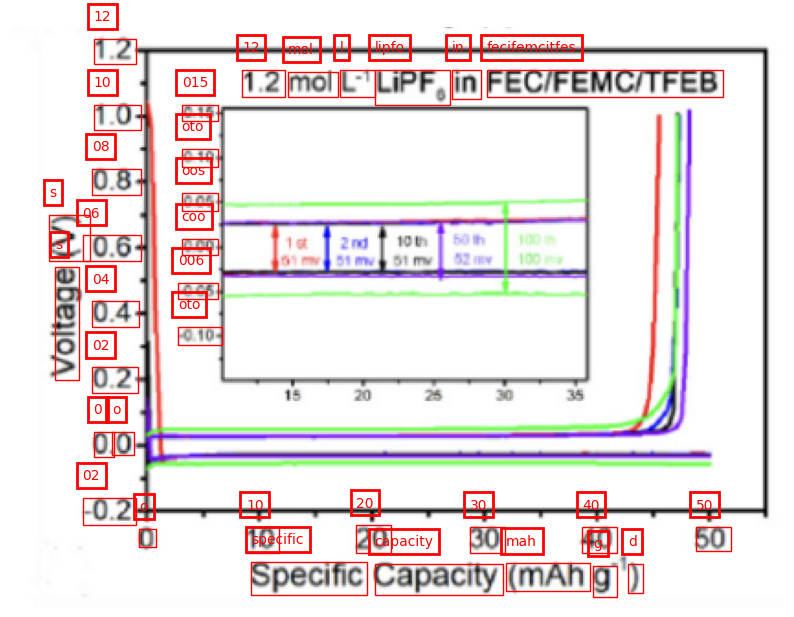

Y MIN 02
Y MAX 12
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 12.0
Y
OCR DIFF -250.5
SEM DIFF 10.0
OCR RATIO -25.05
PIXEL DIFF 0.5
REAL DIFF FROM BASE POINT -0.01996007984031936
Y_MIN 2.0199600798403194
Y_MAX 12.039920159680637
SEMANTIC X MIN 2.0
SEMANTIC X MAX 50.0
X
OCR DIFF 329.0
SEM DIFF 48.0
OCR RATIO 0.1458966565349544
PIXEL DIFF -19.5
REAL DIFF FROM BASE POINT -2.8449848024316107
X_MIN 4.844984802431611
X_MAX 54.1580547112462
X
Predicted [4.844984802431611, 54.1580547112462]
Chat GPT [0, 50]
Y
Predicted [2.0199600798403194, 12.039920159680637]
Chat GPT [-0.2, 1.2]


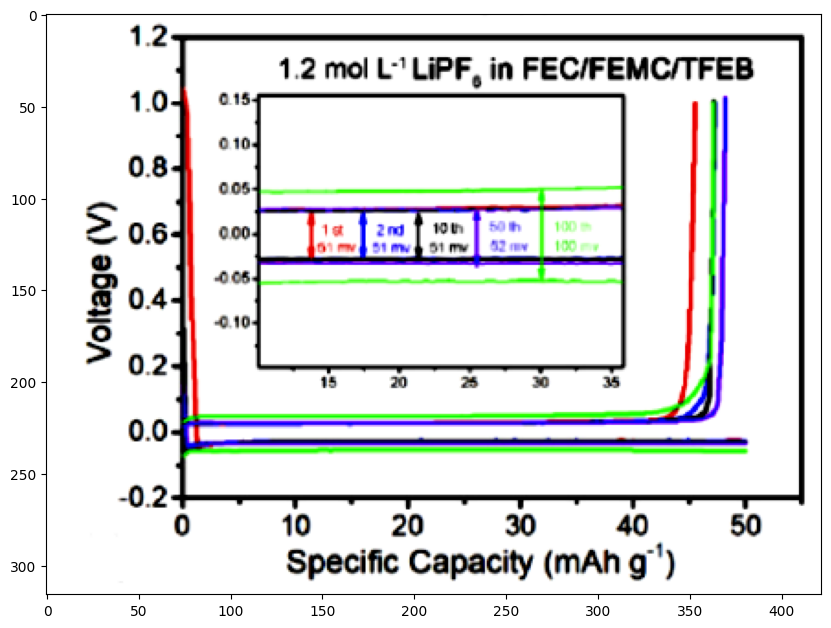

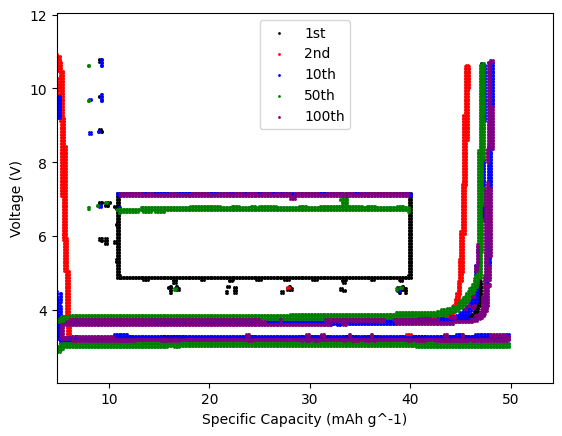

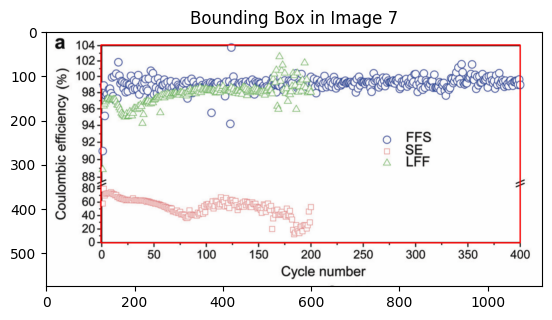

2/2 [==============================] - 2s 225ms/step


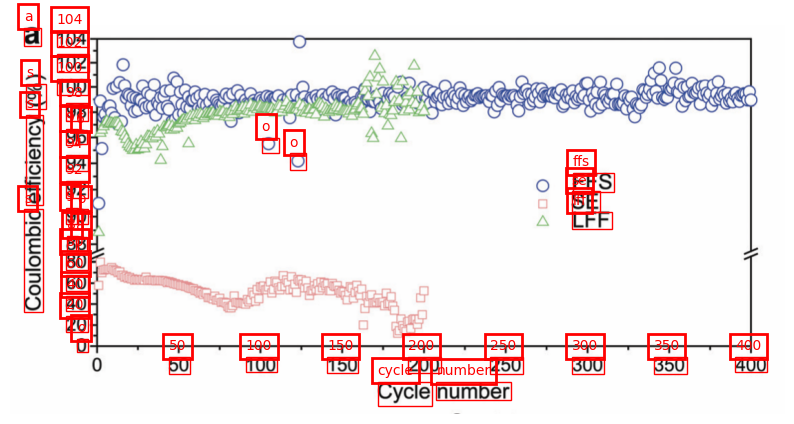

Y MIN 20
Y MAX 104
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 104.0
Y
OCR DIFF -413.81640625
SEM DIFF 84.0
OCR RATIO -4.926385788690476
PIXEL DIFF -32.900390625
REAL DIFF FROM BASE POINT 6.678403201903017
Y_MIN 13.321596798096984
Y_MAX 104.05748699698879
SEMANTIC X MIN 50.0
SEMANTIC X MAX 400.0
X
OCR DIFF 829.279296875
SEM DIFF 350.0
OCR RATIO 0.42205322298400105
PIXEL DIFF 121.326171875
REAL DIFF FROM BASE POINT 51.20610187215461
X_MIN -1.206101872154612
X_MAX 399.74445996264643
X
Predicted [-1.206101872154612, 399.74445996264643]
Chat GPT [0, 400]
Y
Predicted [13.321596798096984, 104.05748699698879]
Chat GPT [0, 104]


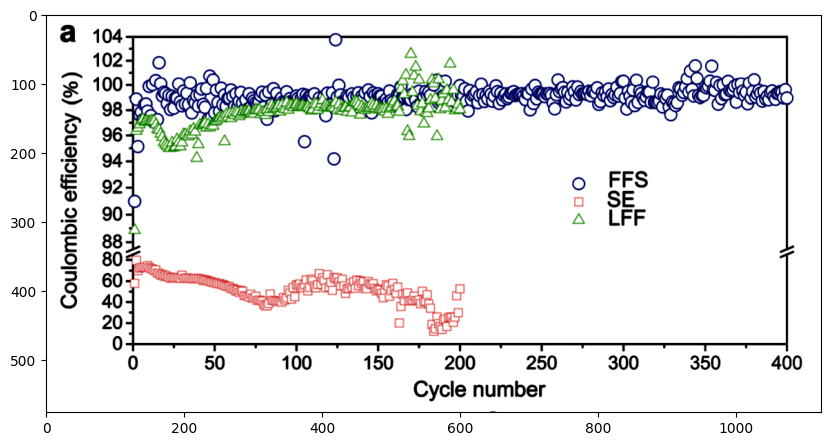

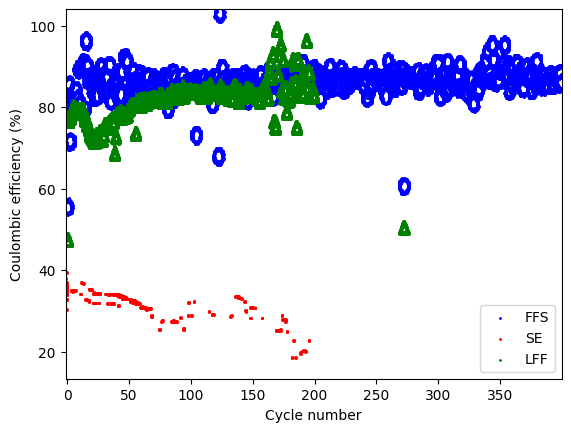

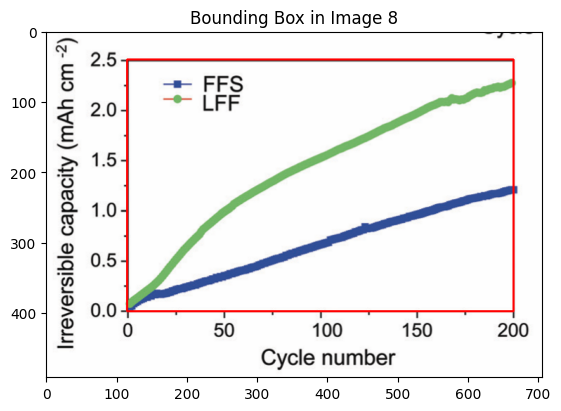

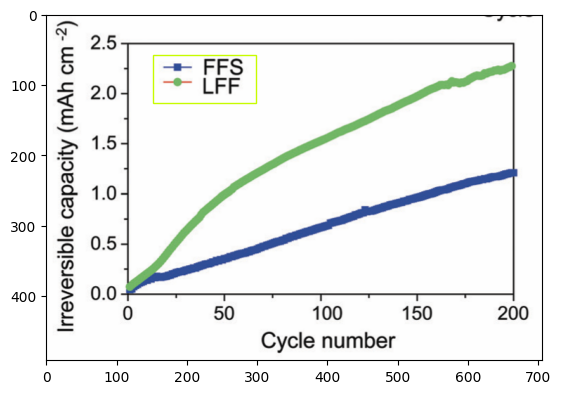

1/1 [==============================] - 1s 963ms/step


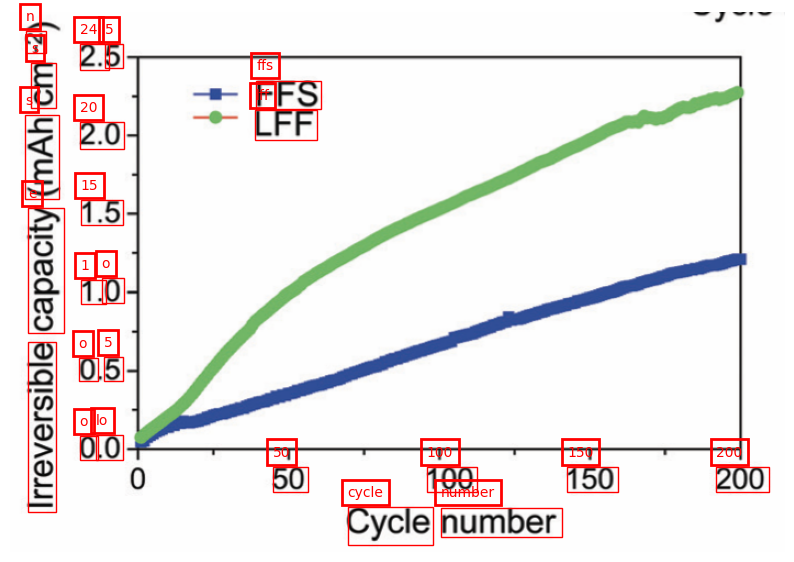

Y MIN 5
Y MAX 5
SEMANTIC Y MIN 5.0
SEMANTIC Y MAX 5.0
Y
OCR DIFF -285.0
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -73.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 5.0
Y_MAX 5.0
SEMANTIC X MIN 50.0
SEMANTIC X MAX 200.0
X
OCR DIFF 412.0
SEM DIFF 150.0
OCR RATIO 0.3640776699029126
PIXEL DIFF 140.0
REAL DIFF FROM BASE POINT 50.970873786407765
X_MIN -0.9708737864077648
X_MAX 199.27184466019418
X
Predicted [-0.9708737864077648, 199.27184466019418]
Chat GPT [0, 200]
Y
Predicted [5.0, 5.0]
Chat GPT [0, 2.5]


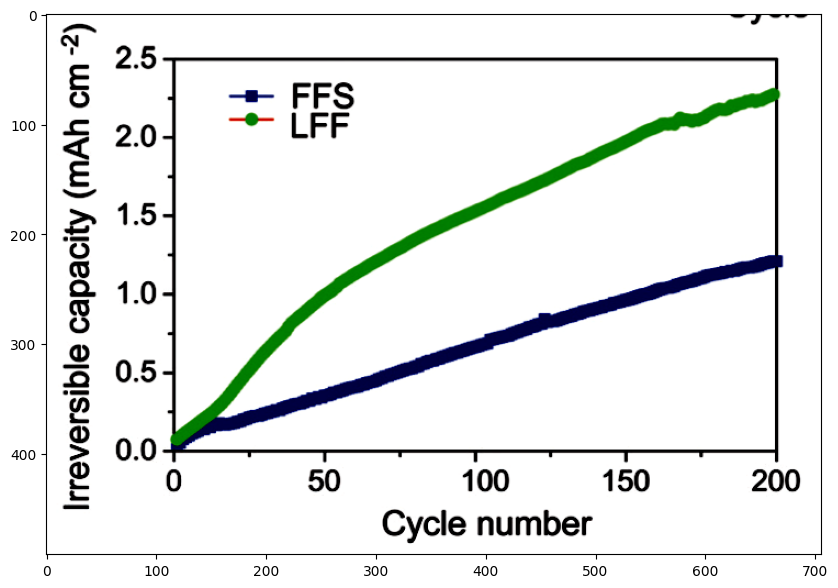

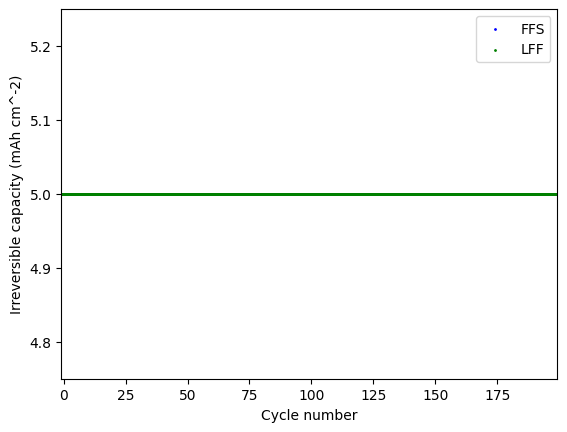

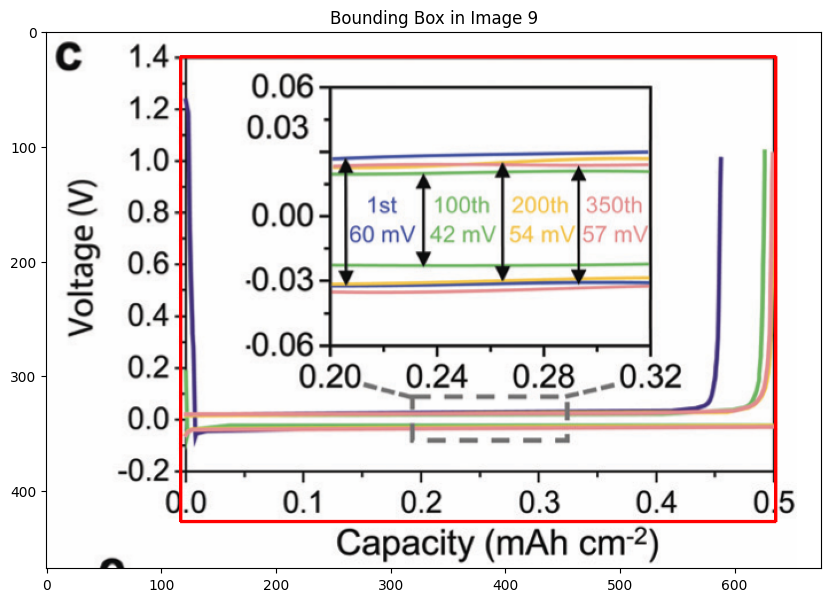

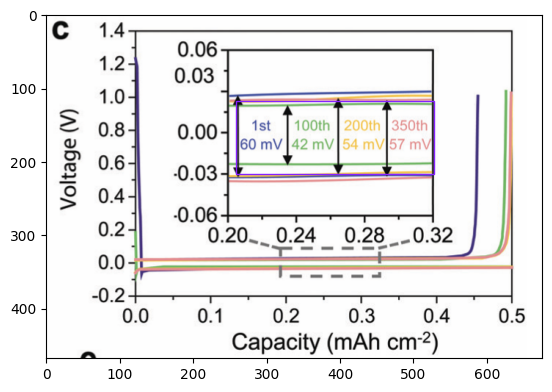

2/2 [==============================] - 2s 819ms/step


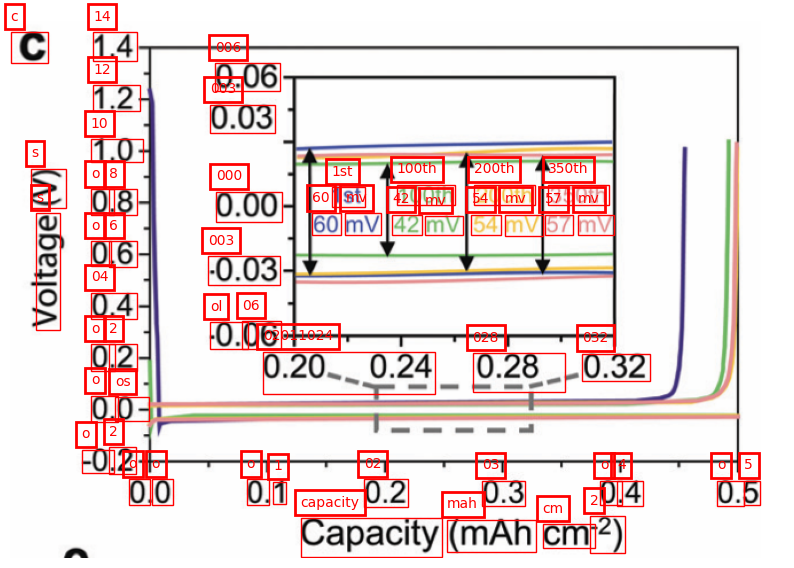

Y MIN 2
Y MAX 14
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 14.0
Y
OCR DIFF -361.0
SEM DIFF 12.0
OCR RATIO -30.083333333333332
PIXEL DIFF -44.5
REAL DIFF FROM BASE POINT 1.479224376731302
Y_MIN 0.520775623268698
Y_MAX 13.983379501385041
SEMANTIC X MIN 2.0
SEMANTIC X MAX 2.0
X
OCR DIFF 0.0
SEM DIFF 0.0
OCR RATIO nan
PIXEL DIFF 403.5
REAL DIFF FROM BASE POINT nan
X_MIN nan
X_MAX nan
x is in fault condition
X
Predicted [0, 0.5]
Chat GPT [0, 0.5]
Y
Predicted [0.520775623268698, 13.983379501385041]
Chat GPT [-0.2, 1.4]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


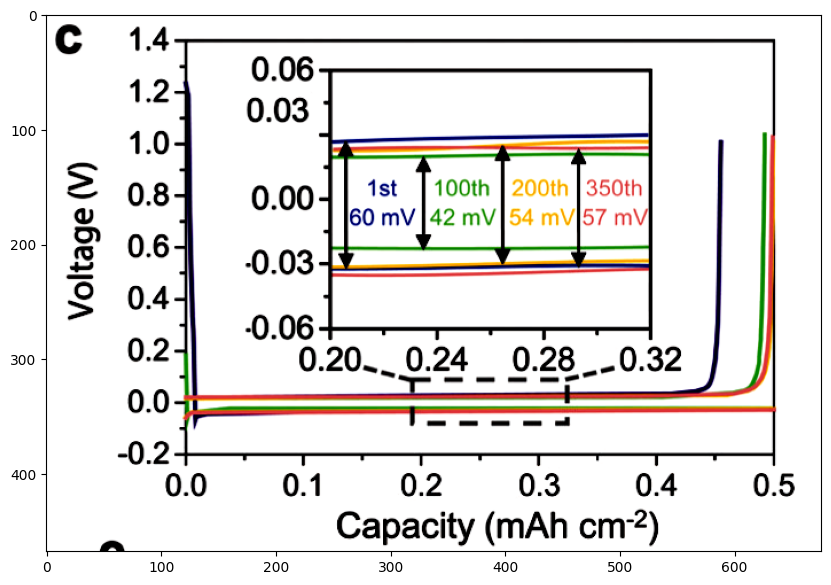

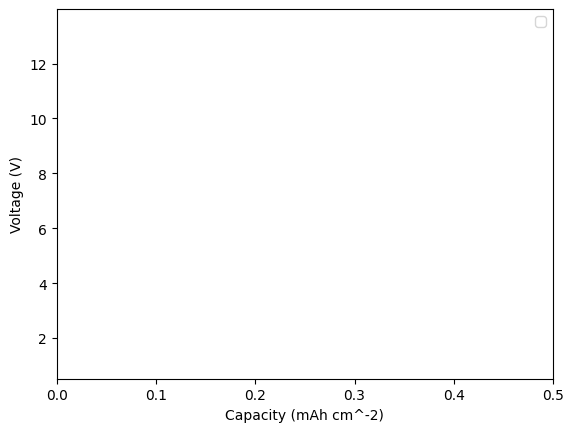

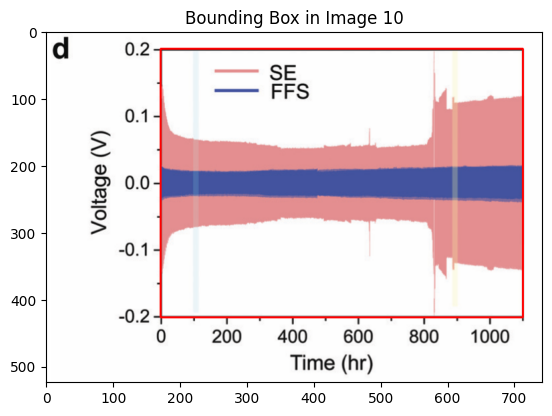

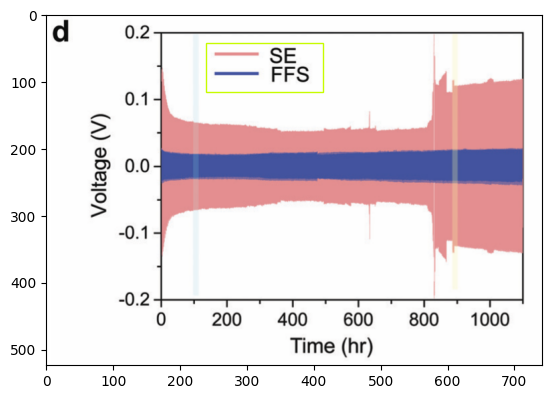

1/1 [==============================] - 1s 901ms/step


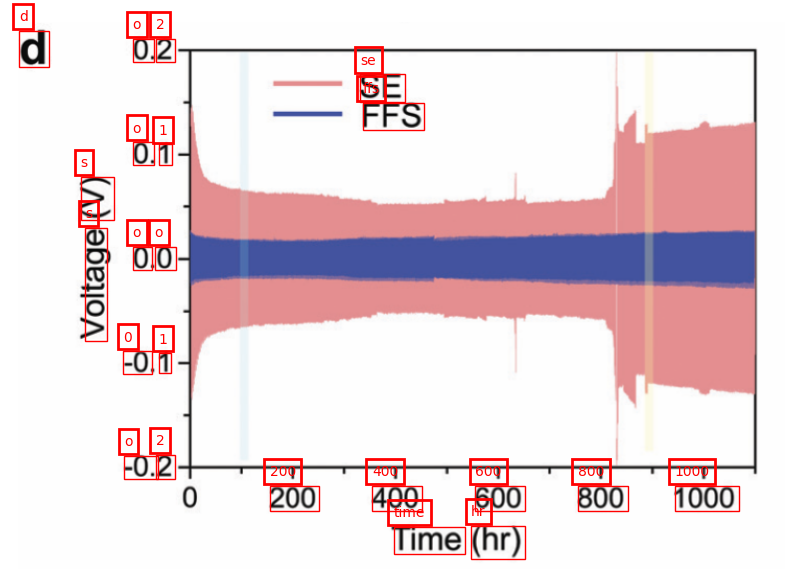

Y MIN 2
Y MAX 2
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 2.0
Y
OCR DIFF -398.5
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -1.5
REAL DIFF FROM BASE POINT -0.0
Y_MIN 2.0
Y_MAX 2.0
SEMANTIC X MIN 200.0
SEMANTIC X MAX 1000.0
X
OCR DIFF 395.0
SEM DIFF 800.0
OCR RATIO 2.0253164556962027
PIXEL DIFF 100.5
REAL DIFF FROM BASE POINT 203.54430379746836
X_MIN -3.544303797468359
X_MAX 1094.1772151898736
X
Predicted [-3.544303797468359, 1094.1772151898736]
Chat GPT [0, 1000]
Y
Predicted [2.0, 2.0]
Chat GPT [-0.2, 0.2]


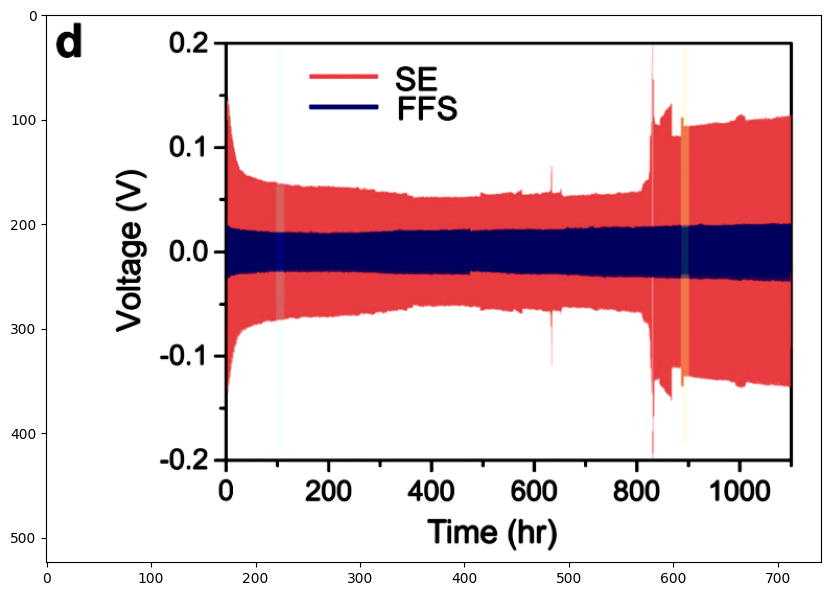

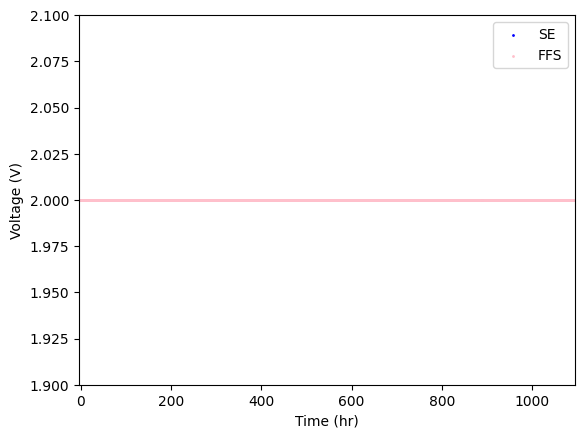

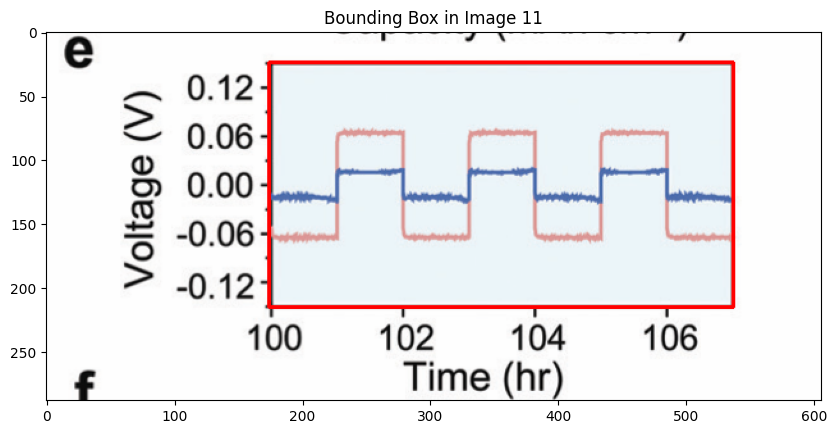

1/1 [==============================] - 1s 860ms/step


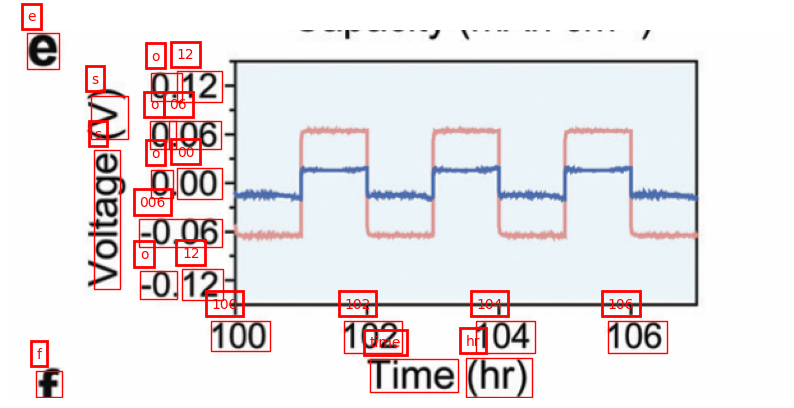

Y MIN 12
Y MAX 12
SEMANTIC Y MIN 12.0
SEMANTIC Y MAX 12.0
Y
OCR DIFF -155.0
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -16.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 12.0
Y_MAX 12.0
SEMANTIC X MIN 100.0
SEMANTIC X MAX 106.0
X
OCR DIFF 310.0
SEM DIFF 6.0
OCR RATIO 0.01935483870967742
PIXEL DIFF 6.0
REAL DIFF FROM BASE POINT 0.11612903225806452
X_MIN 99.88387096774194
X_MAX 106.90967741935485
X
Predicted [99.88387096774194, 106.90967741935485]
Chat GPT [100, 106]
Y
Predicted [12.0, 12.0]
Chat GPT [-0.12, 0.12]


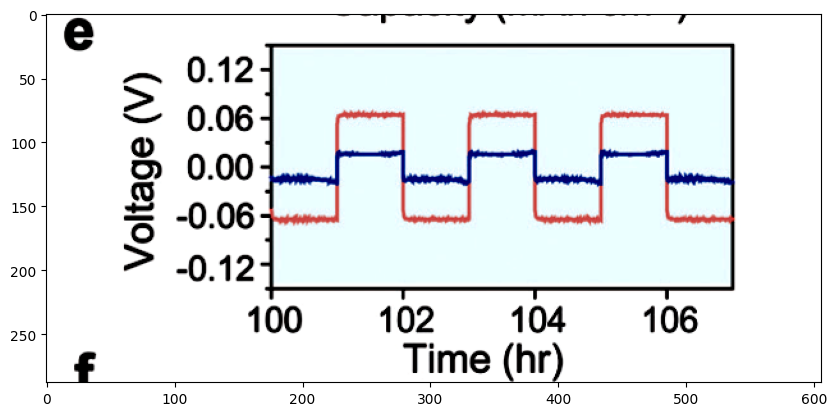

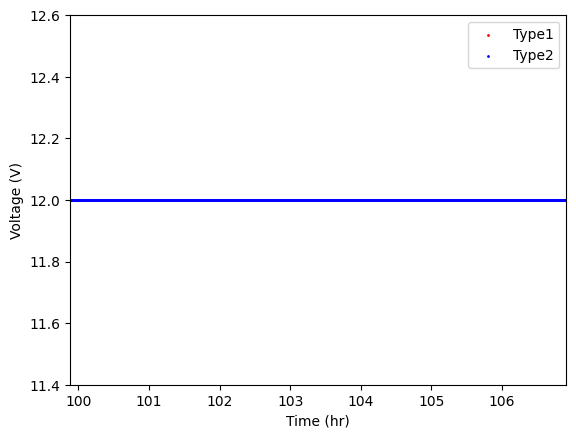

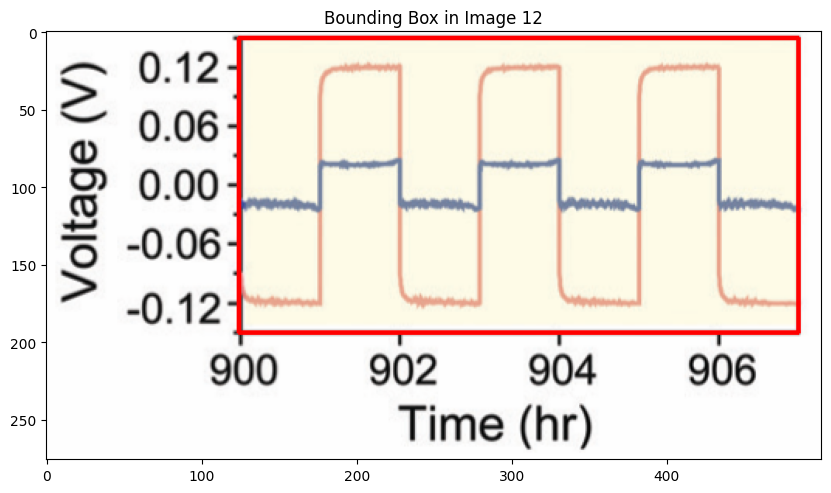

1/1 [==============================] - 1s 730ms/step


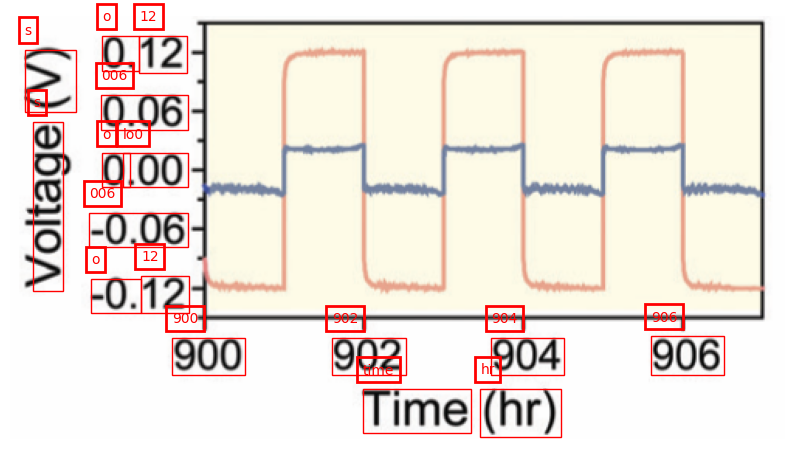

Y MIN 12
Y MAX 12
SEMANTIC Y MIN 12.0
SEMANTIC Y MAX 12.0
Y
OCR DIFF -155.0
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -15.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 12.0
Y_MAX 12.0
SEMANTIC X MIN 900.0
SEMANTIC X MAX 906.0
X
OCR DIFF 309.0
SEM DIFF 6.0
OCR RATIO 0.019417475728155338
PIXEL DIFF 3.5
REAL DIFF FROM BASE POINT 0.06796116504854369
X_MIN 899.9320388349514
X_MAX 906.9417475728155
X
Predicted [899.9320388349514, 906.9417475728155]
Chat GPT [900, 906]
Y
Predicted [12.0, 12.0]
Chat GPT [-0.12, 0.12]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


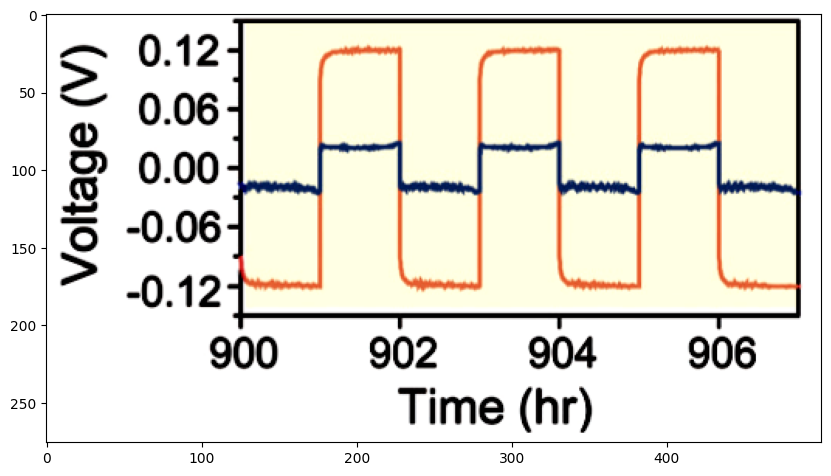

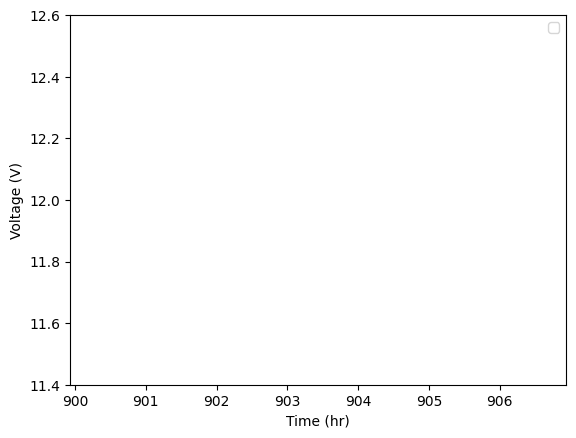

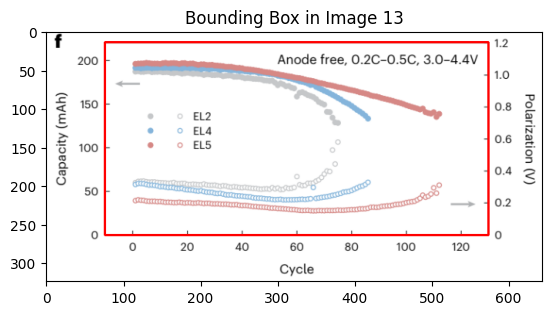

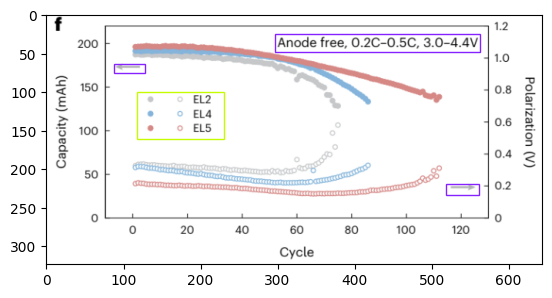

2/2 [==============================] - 2s 132ms/step


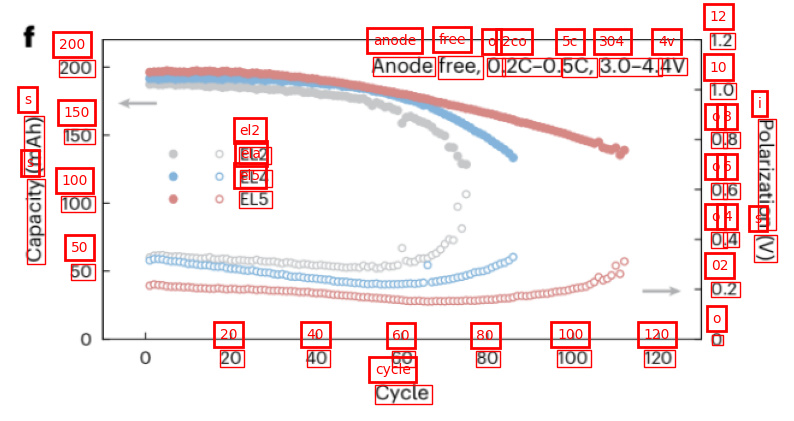

Y MIN 50
Y MAX 200
SEMANTIC Y MIN 50.0
SEMANTIC Y MAX 200.0
Y
OCR DIFF -169.0
SEM DIFF 150.0
OCR RATIO -1.1266666666666667
PIXEL DIFF -56.0
REAL DIFF FROM BASE POINT 49.70414201183432
Y_MIN 0.2958579881656789
Y_MAX 222.18934911242604
SEMANTIC X MIN 20.0
SEMANTIC X MAX 120.0
X
OCR DIFF 355.0
SEM DIFF 100.0
OCR RATIO 0.28169014084507044
PIXEL DIFF 108.0
REAL DIFF FROM BASE POINT 30.422535211267608
X_MIN -10.422535211267608
X_MAX 129.85915492957747
X
Predicted [-10.422535211267608, 129.85915492957747]
Chat GPT [0, 120]
Y
Predicted [0.2958579881656789, 222.18934911242604]
Chat GPT [0, 200]


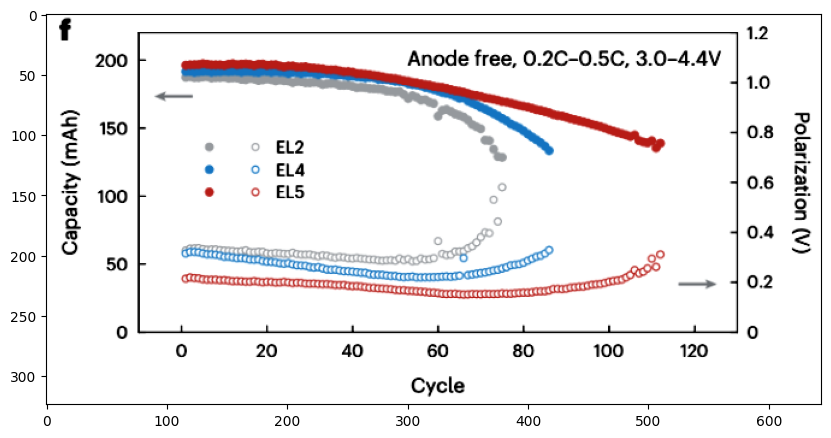

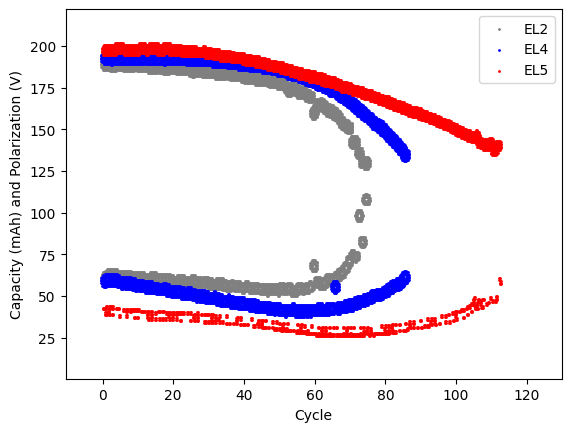

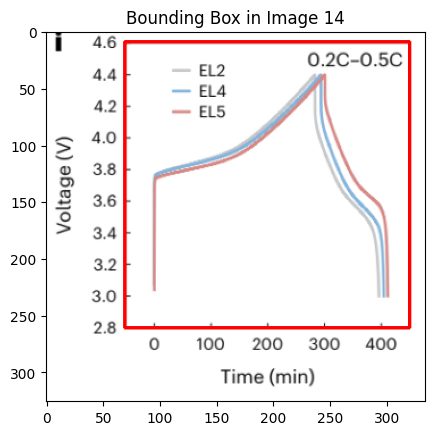

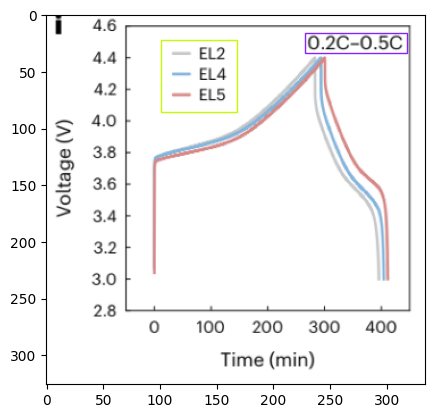

1/1 [==============================] - 1s 1s/step


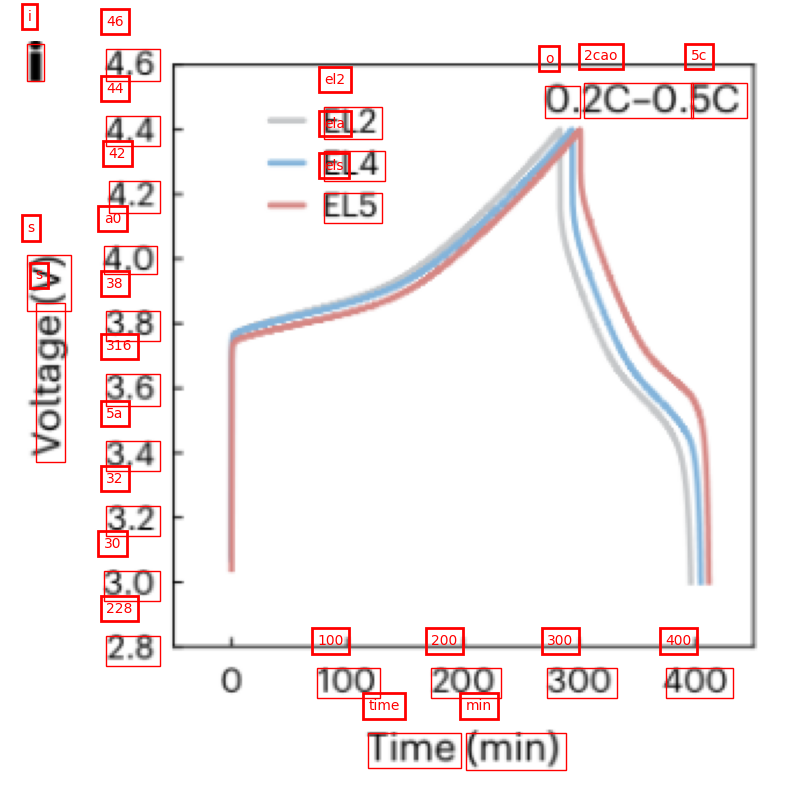

Y MIN 228
Y MAX 46
SEMANTIC Y MIN 228.0
SEMANTIC Y MAX 46.0
Y
OCR DIFF -252.5
SEM DIFF -182.0
OCR RATIO 1.3873626373626373
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT 1.0811881188118813
Y_MIN 226.9188118811881
Y_MAX 45.27920792079206
SEMANTIC X MIN 228.0
SEMANTIC X MAX 400.0
X
OCR DIFF 244.0
SEM DIFF 172.0
OCR RATIO 0.7049180327868853
PIXEL DIFF -16.5
REAL DIFF FROM BASE POINT -11.631147540983607
X_MIN 239.63114754098362
X_MAX 416.5655737704918
X
Predicted [239.63114754098362, 416.5655737704918]
Chat GPT [0, 400]
Y
Predicted [226.9188118811881, 45.27920792079206]
Chat GPT [2.8, 4.6]


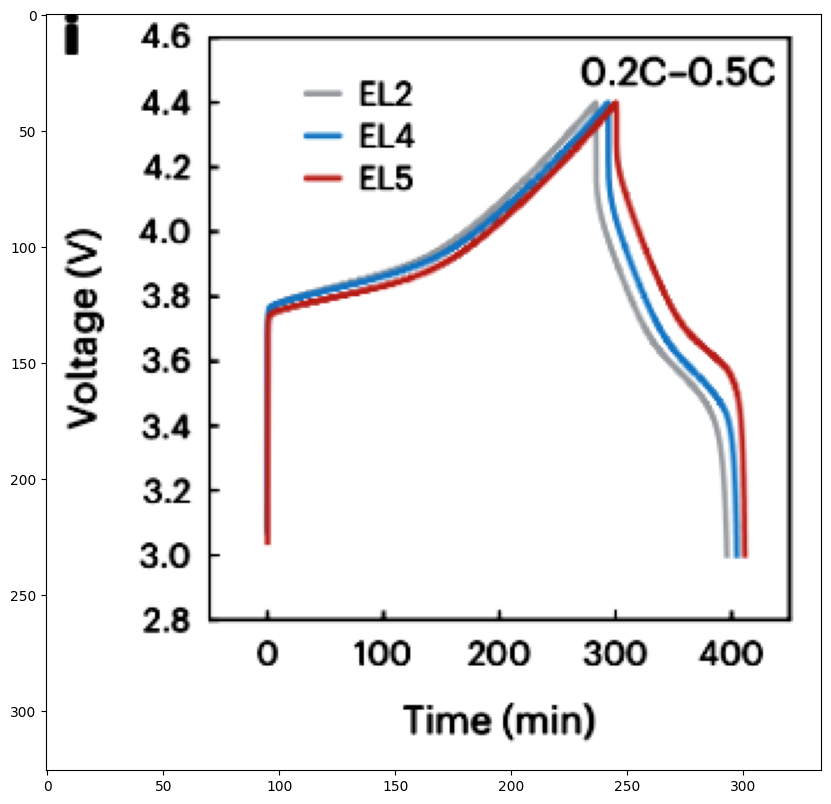

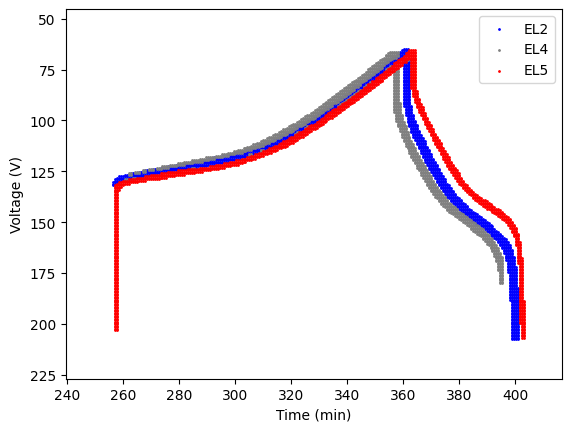

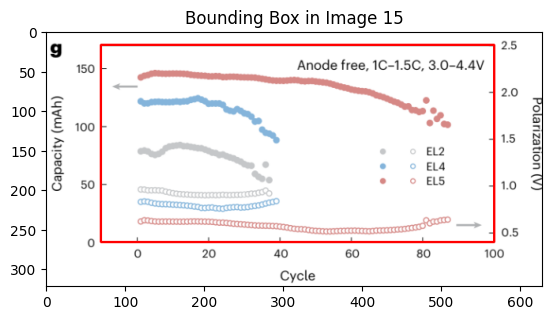

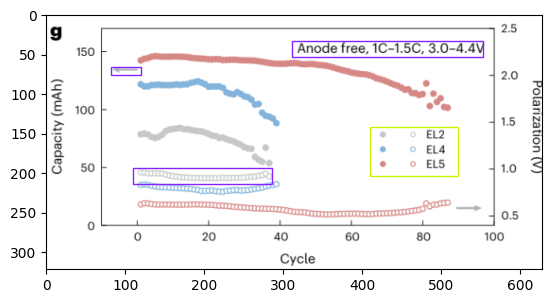

1/1 [==============================] - 1s 1s/step


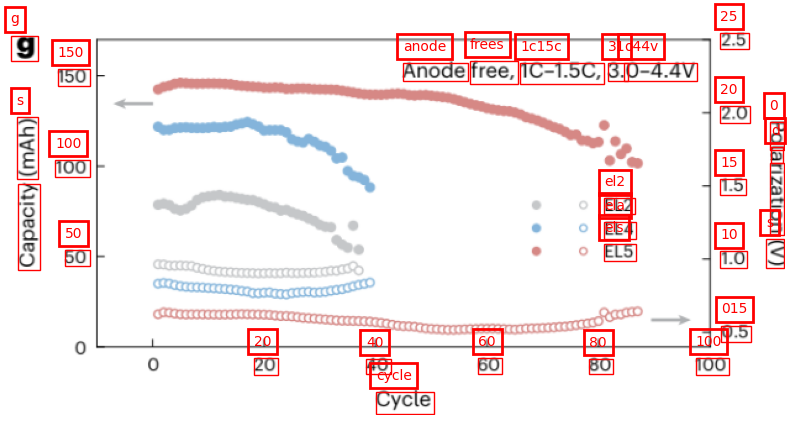

Y MIN 50
Y MAX 150
SEMANTIC Y MIN 50.0
SEMANTIC Y MAX 150.0
Y
OCR DIFF -146.5
SEM DIFF 100.0
OCR RATIO -1.465
PIXEL DIFF -71.5
REAL DIFF FROM BASE POINT 48.80546075085324
Y_MIN 1.1945392491467572
Y_MAX 171.160409556314
SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 361.5
SEM DIFF 80.0
OCR RATIO 0.22130013831258644
PIXEL DIFF 138.0
REAL DIFF FROM BASE POINT 30.539419087136928
X_MIN -10.539419087136928
X_MAX 99.66804979253112
X
Predicted [-10.539419087136928, 99.66804979253112]
Chat GPT [0, 100]
Y
Predicted [1.1945392491467572, 171.160409556314]
Chat GPT [0, 150]


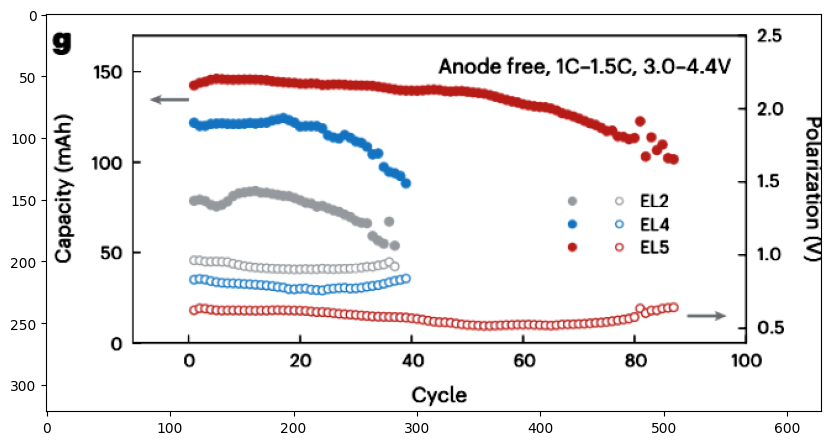

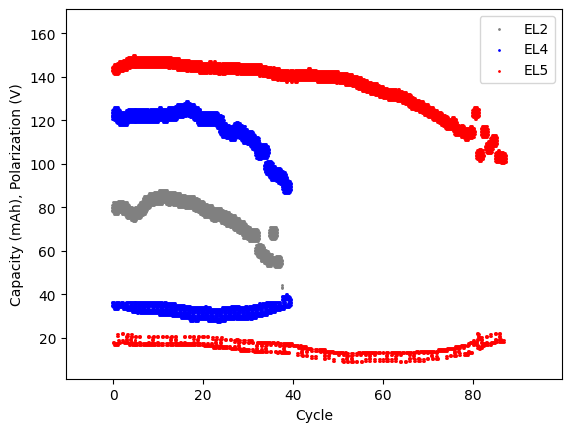

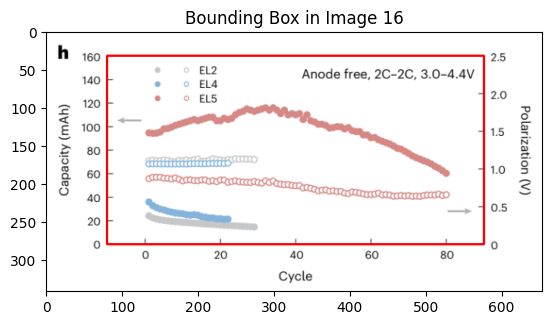

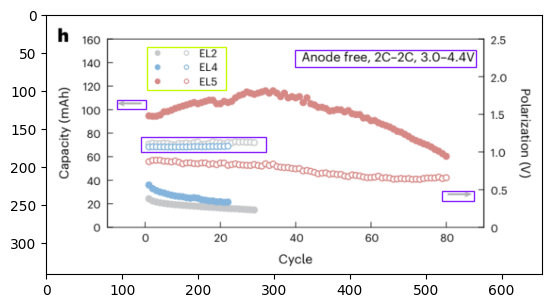

1/1 [==============================] - 1s 1s/step


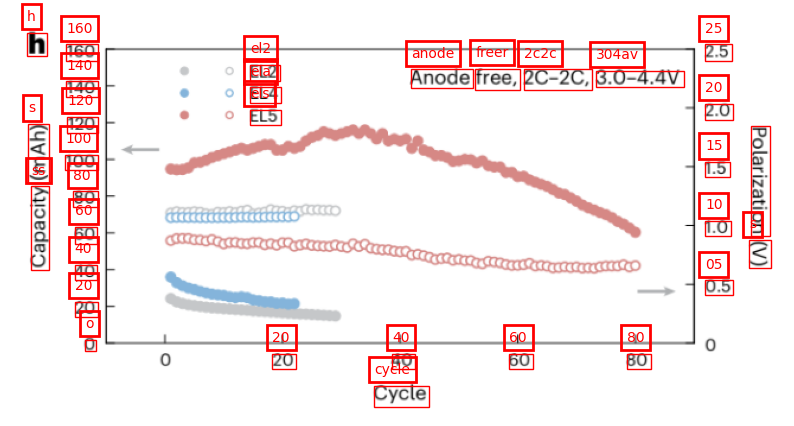

Y MIN 20
Y MAX 160
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -216.5
SEM DIFF 140.0
OCR RATIO -1.5464285714285715
PIXEL DIFF -28.5
REAL DIFF FROM BASE POINT 18.429561200923786
Y_MIN 1.5704387990762143
Y_MAX 161.93995381062356
SEMANTIC X MIN 20.0
SEMANTIC X MAX 80.0
X
OCR DIFF 299.0
SEM DIFF 60.0
OCR RATIO 0.20066889632107024
PIXEL DIFF 151.0
REAL DIFF FROM BASE POINT 30.301003344481607
X_MIN -10.301003344481607
X_MAX 89.4314381270903
X
Predicted [-10.301003344481607, 89.4314381270903]
Chat GPT [0, 80]
Y
Predicted [1.5704387990762143, 161.93995381062356]
Chat GPT [0, 160]


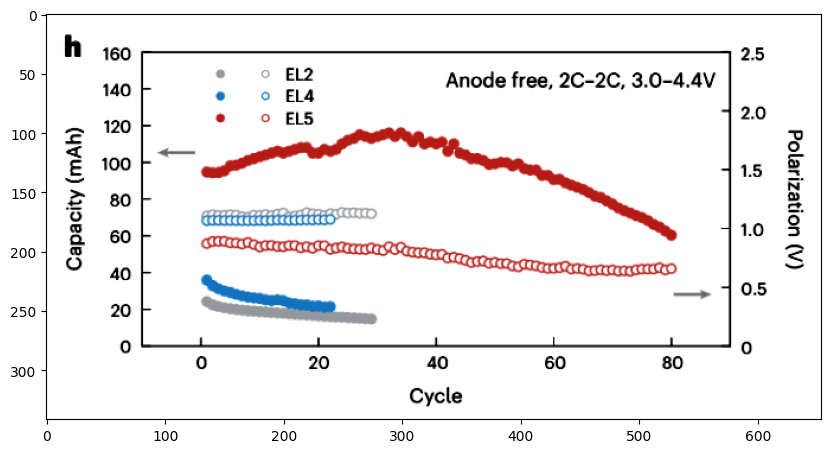

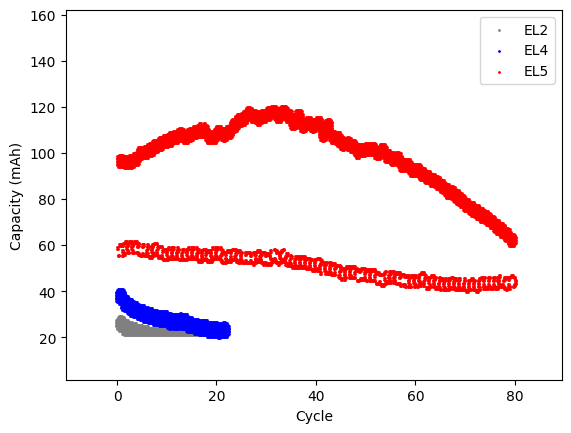

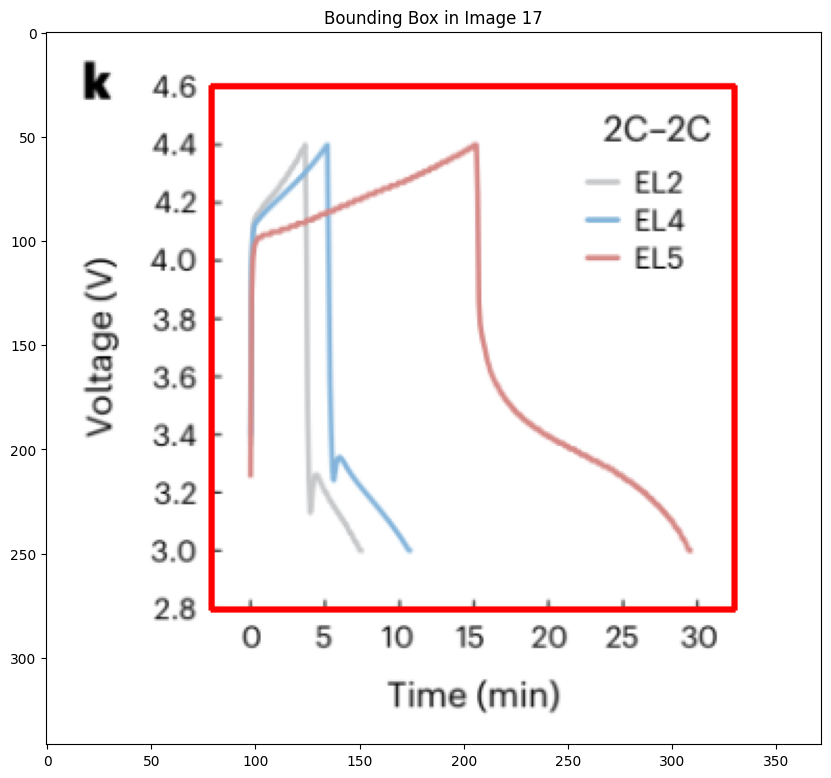

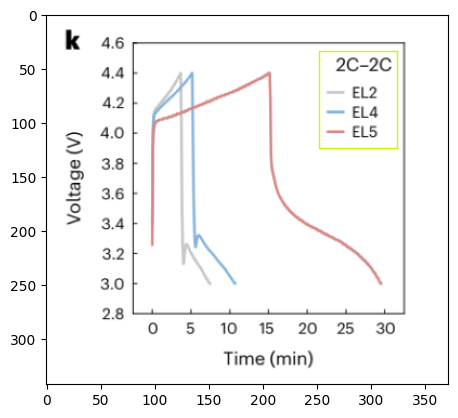

1/1 [==============================] - 1s 1s/step


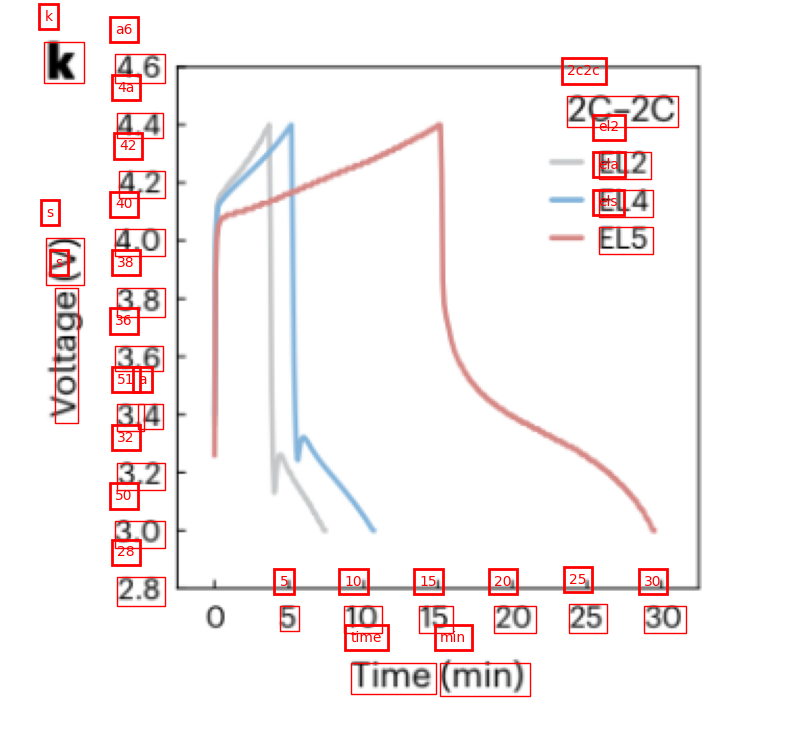

Y MIN 28
Y MAX 42
SEMANTIC Y MIN 28.0
SEMANTIC Y MAX 42.0
Y
OCR DIFF -195.5
SEM DIFF 14.0
OCR RATIO -13.964285714285714
PIXEL DIFF 1.0
REAL DIFF FROM BASE POINT -0.07161125319693094
Y_MIN 28.07161125319693
Y_MAX 46.0460358056266
SEMANTIC X MIN 28.0
SEMANTIC X MAX 30.0
X
OCR DIFF 251.5
SEM DIFF 2.0
OCR RATIO 0.007952286282306162
PIXEL DIFF -16.5
REAL DIFF FROM BASE POINT -0.13121272365805167
X_MIN 28.131212723658052
X_MAX 30.1272365805169
X
Predicted [28.131212723658052, 30.1272365805169]
Chat GPT [0, 30]
Y
Predicted [28.07161125319693, 46.0460358056266]
Chat GPT [2.8, 4.6]


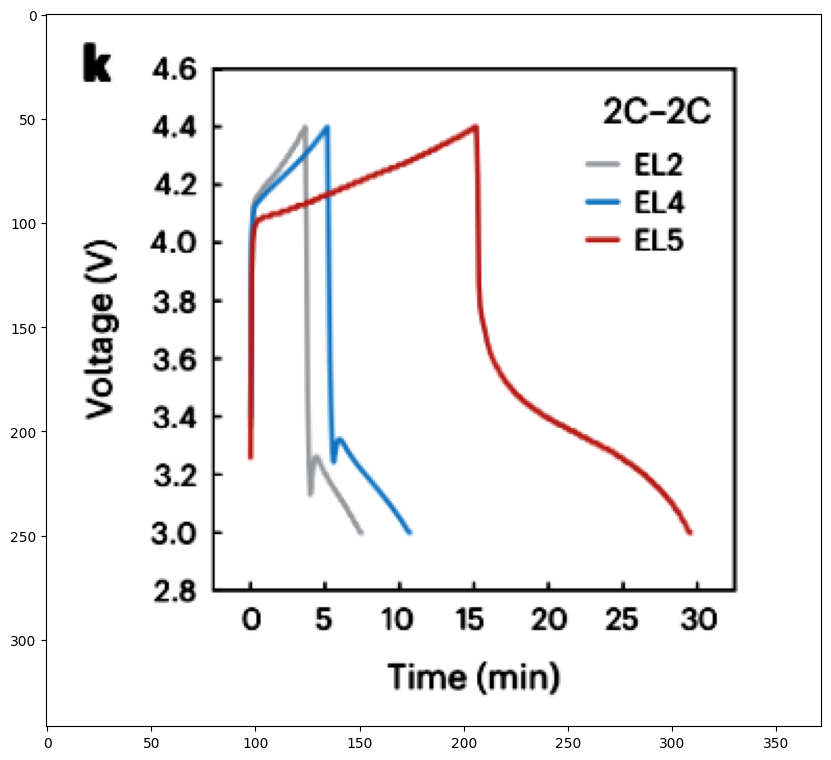

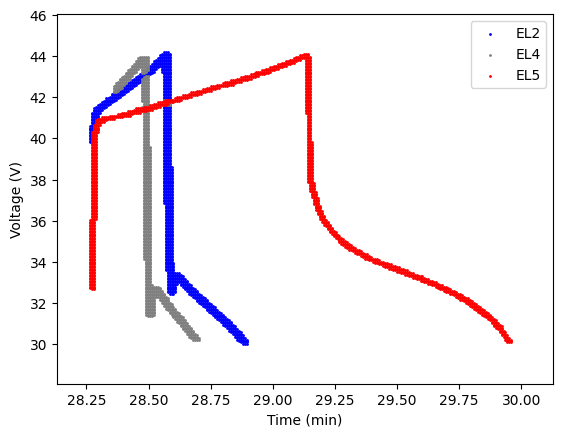

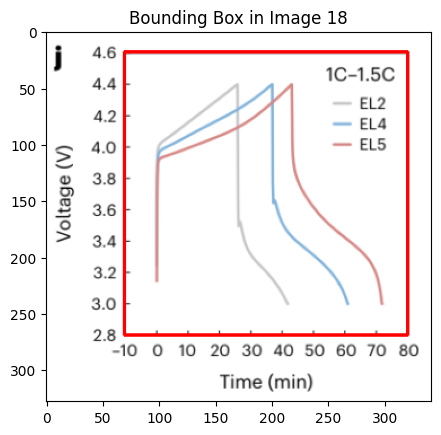

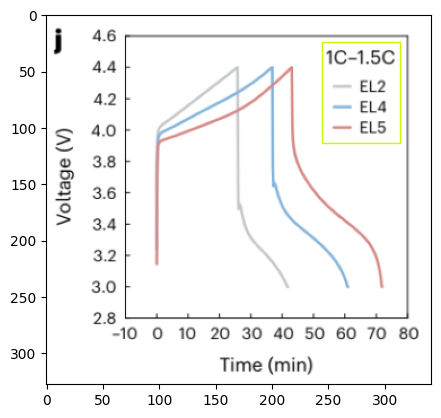

1/1 [==============================] - 1s 1s/step


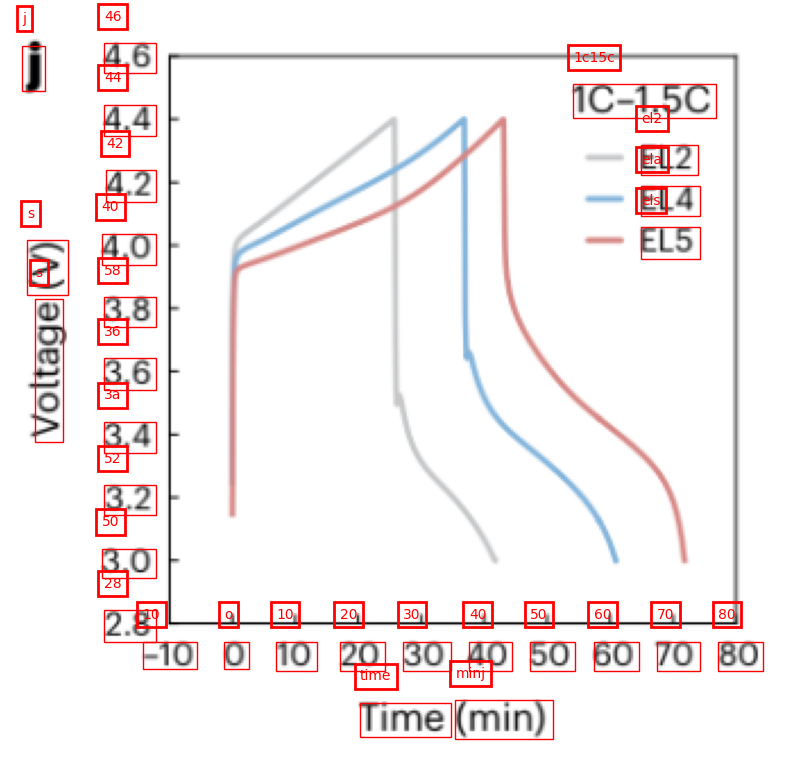

Y MIN 28
Y MAX 46
SEMANTIC Y MIN 28.0
SEMANTIC Y MAX 46.0
Y
OCR DIFF -250.5
SEM DIFF 18.0
OCR RATIO -13.916666666666666
PIXEL DIFF 1.0
REAL DIFF FROM BASE POINT -0.0718562874251497
Y_MIN 28.07185628742515
Y_MAX 46.10778443113772
SEMANTIC X MIN 10.0
SEMANTIC X MAX 80.0
X
OCR DIFF 252.0
SEM DIFF 70.0
OCR RATIO 0.2777777777777778
PIXEL DIFF 1.0
REAL DIFF FROM BASE POINT 0.2777777777777778
X_MIN 9.722222222222221
X_MAX 79.44444444444446
X
Predicted [9.722222222222221, 79.44444444444446]
Chat GPT [-10, 70]
Y
Predicted [28.07185628742515, 46.10778443113772]
Chat GPT [3.0, 4.6]


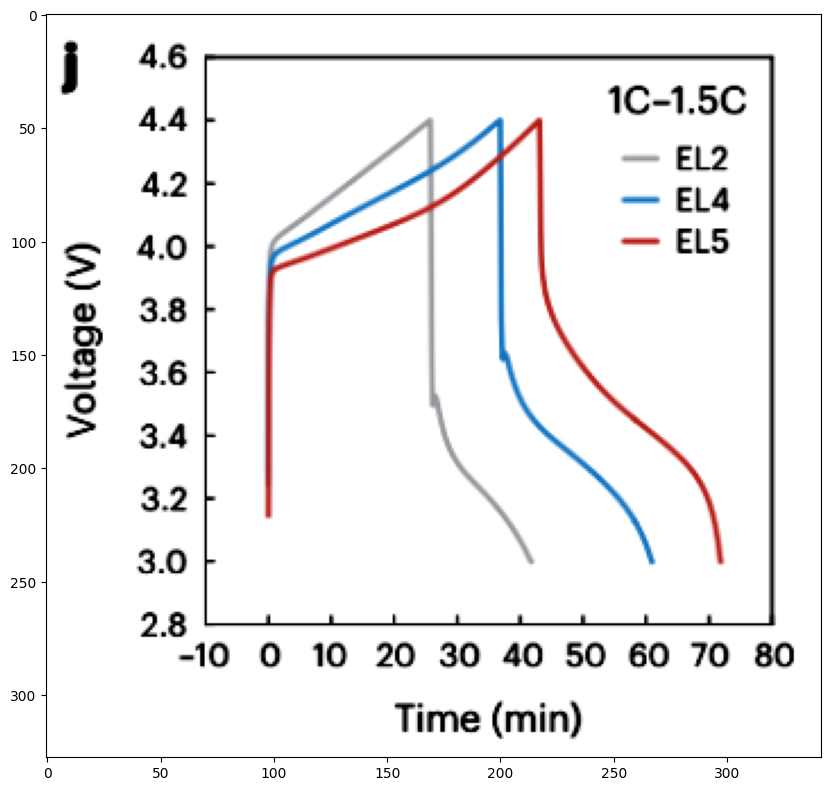

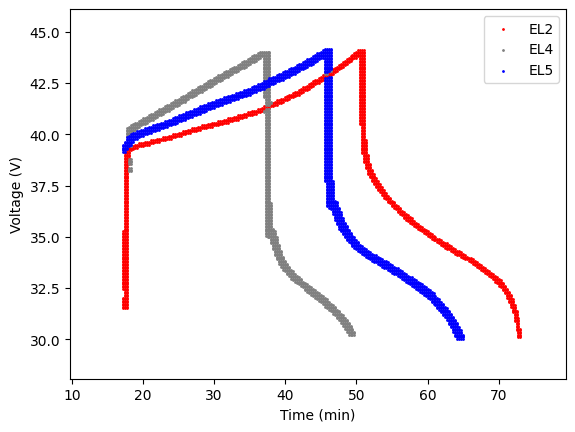

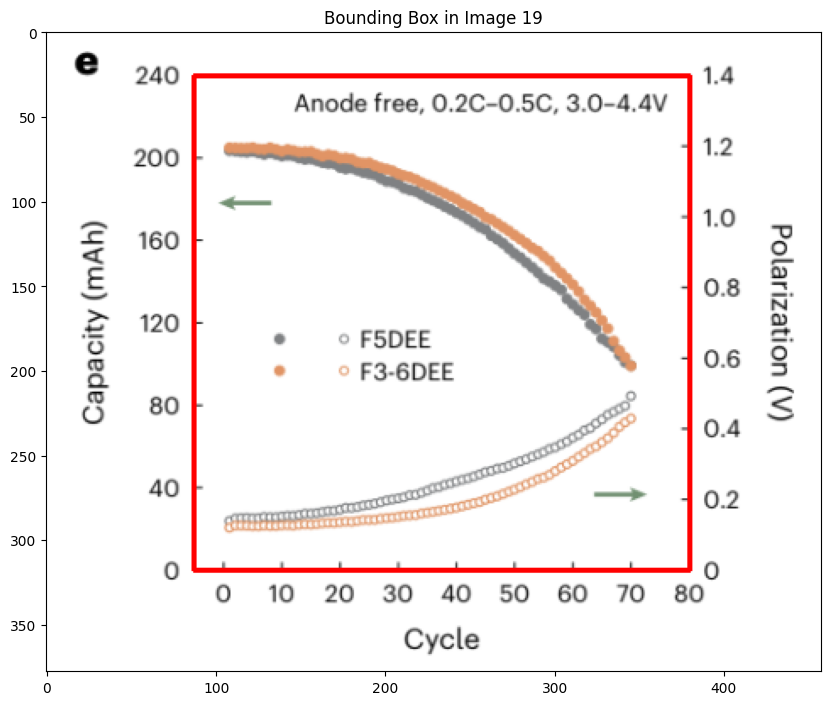

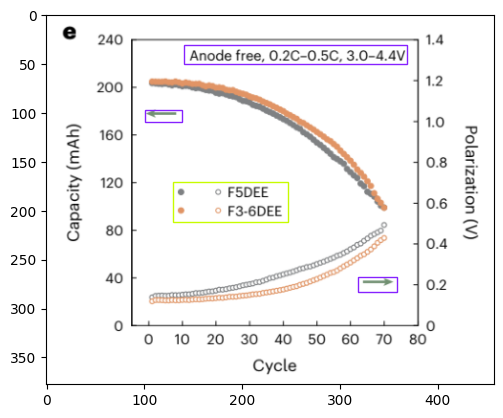

2/2 [==============================] - 2s 167ms/step


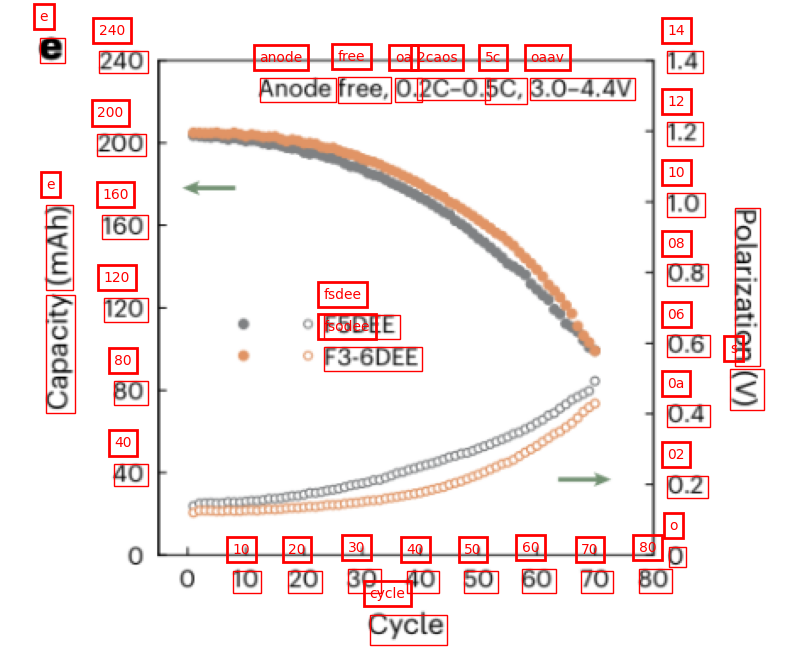

Y MIN 40
Y MAX 240
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 240.0
Y
OCR DIFF -244.0
SEM DIFF 200.0
OCR RATIO -1.22
PIXEL DIFF -47.5
REAL DIFF FROM BASE POINT 38.9344262295082
Y_MIN 1.0655737704918025
Y_MAX 240.40983606557376
SEMANTIC X MIN 10.0
SEMANTIC X MAX 80.0
X
OCR DIFF 241.5
SEM DIFF 70.0
OCR RATIO 0.2898550724637681
PIXEL DIFF 52.5
REAL DIFF FROM BASE POINT 15.217391304347826
X_MIN -5.217391304347826
X_MAX 79.71014492753623
X
Predicted [-5.217391304347826, 79.71014492753623]
Chat GPT [0, 80]
Y
Predicted [1.0655737704918025, 240.40983606557376]
Chat GPT [0, 240]


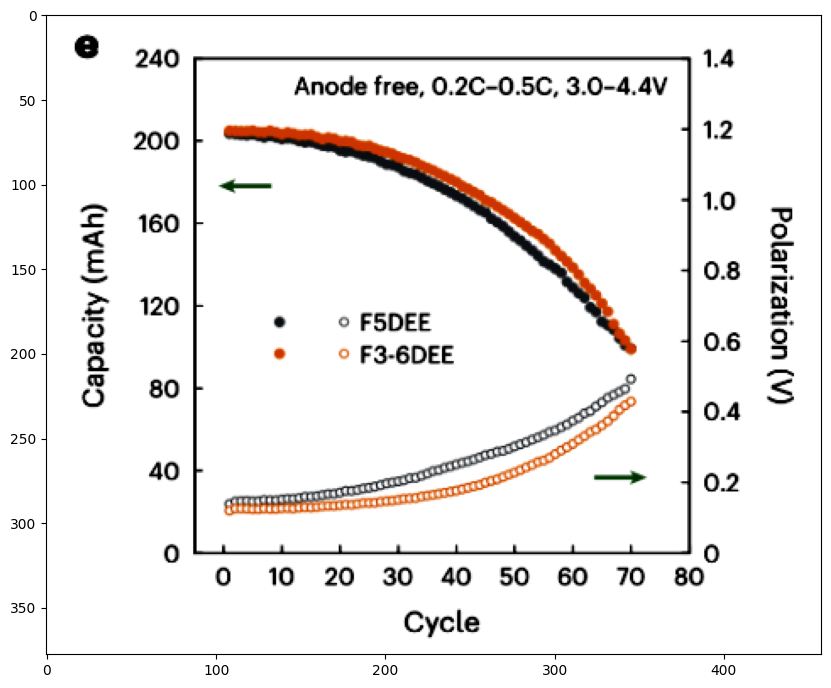

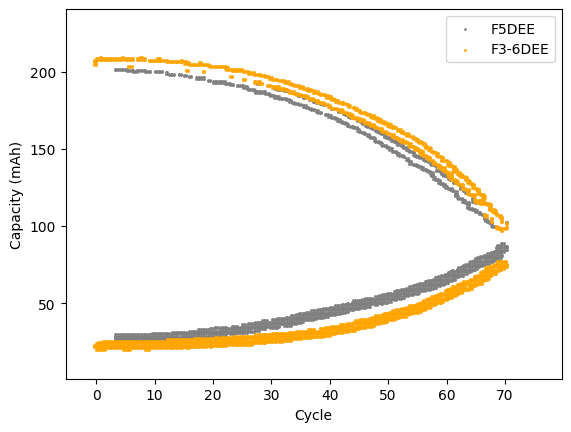

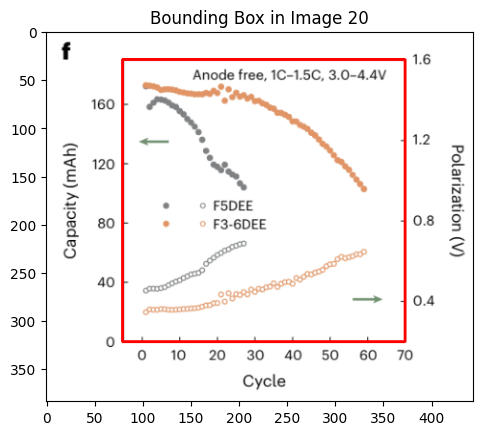

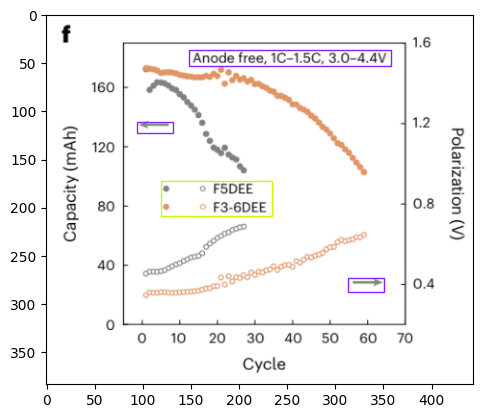

1/1 [==============================] - 1s 1s/step


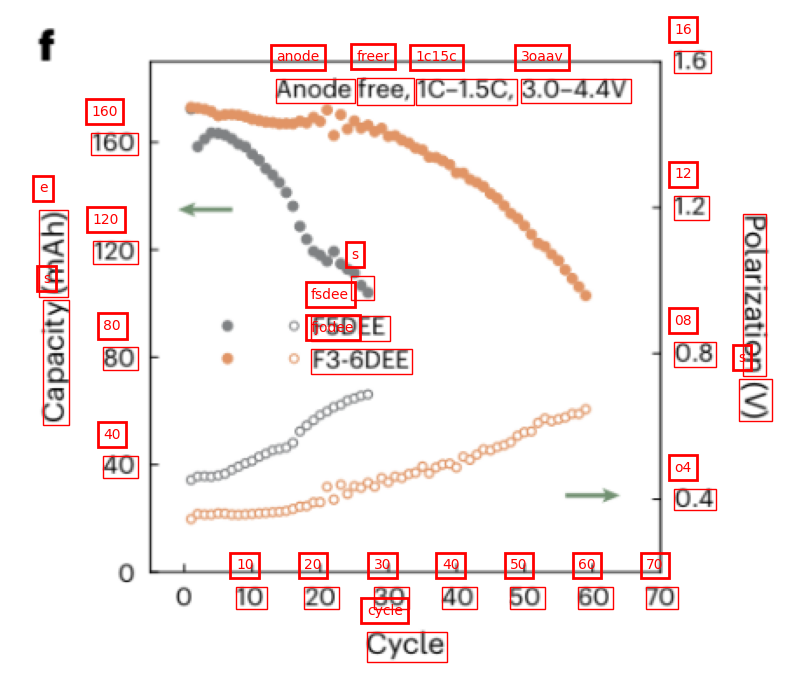

Y MIN 40
Y MAX 160
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -185.0
SEM DIFF 120.0
OCR RATIO -1.5416666666666667
PIXEL DIFF -60.5
REAL DIFF FROM BASE POINT 39.24324324324324
Y_MIN 0.7567567567567579
Y_MAX 190.81081081081078
SEMANTIC X MIN 10.0
SEMANTIC X MAX 70.0
X
OCR DIFF 235.0
SEM DIFF 60.0
OCR RATIO 0.2553191489361702
PIXEL DIFF 59.0
REAL DIFF FROM BASE POINT 15.063829787234042
X_MIN -5.063829787234042
X_MAX 69.74468085106382
X
Predicted [-5.063829787234042, 69.74468085106382]
Chat GPT [0, 70]
Y
Predicted [0.7567567567567579, 190.81081081081078]
Chat GPT [0, 160]


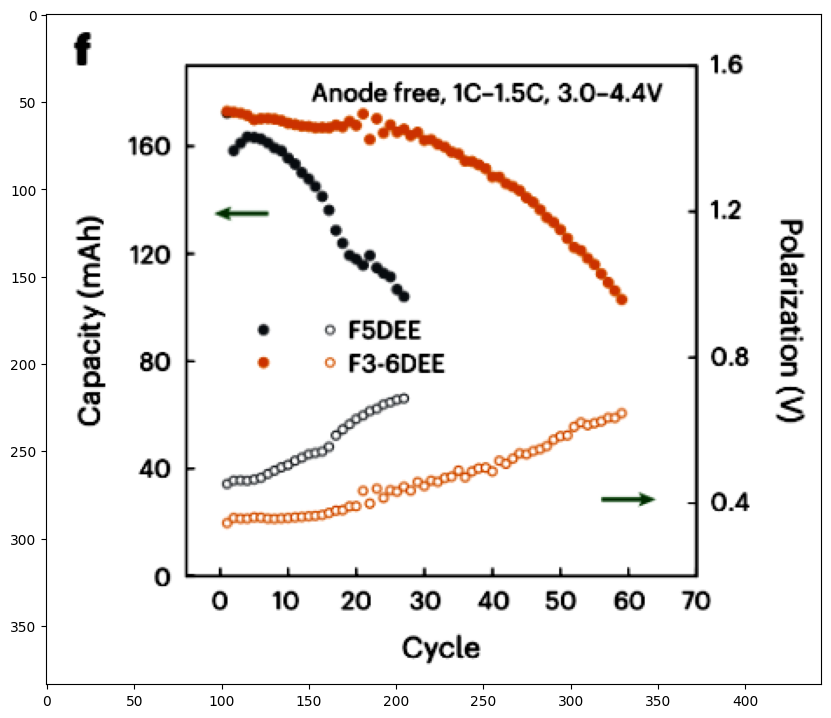

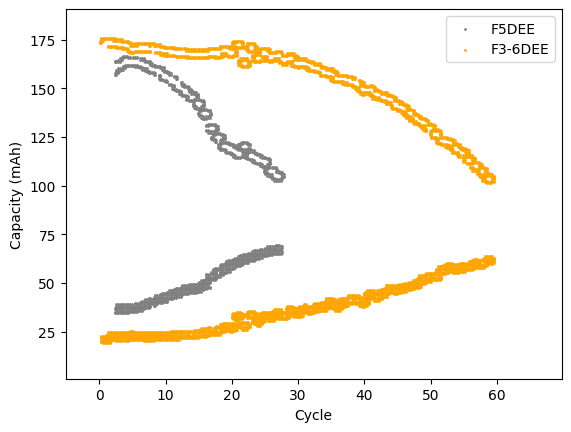

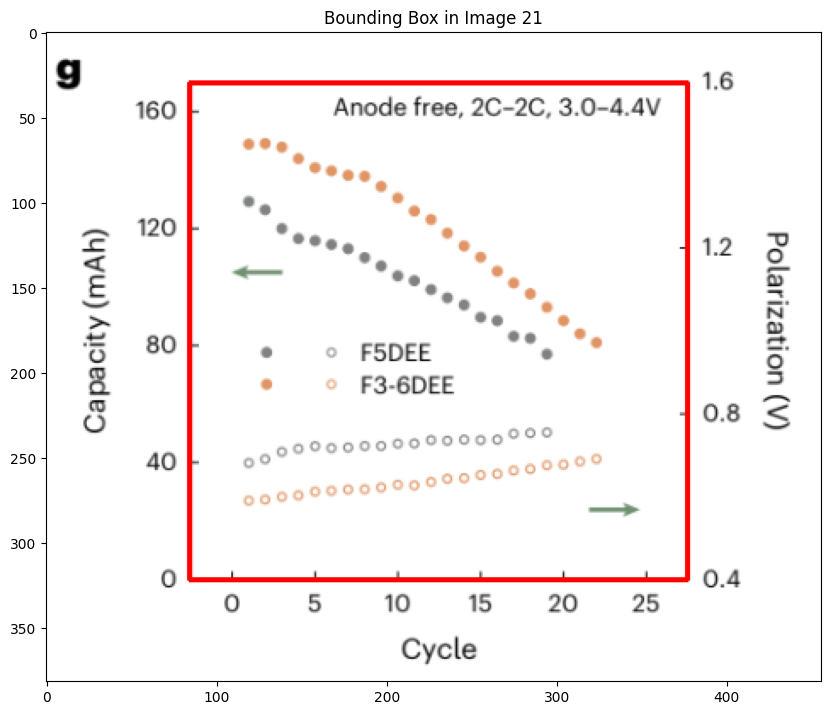

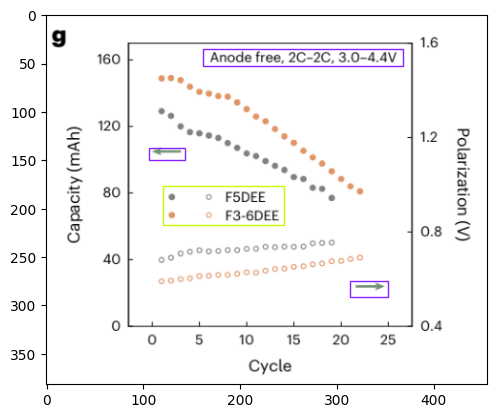

1/1 [==============================] - 1s 1s/step


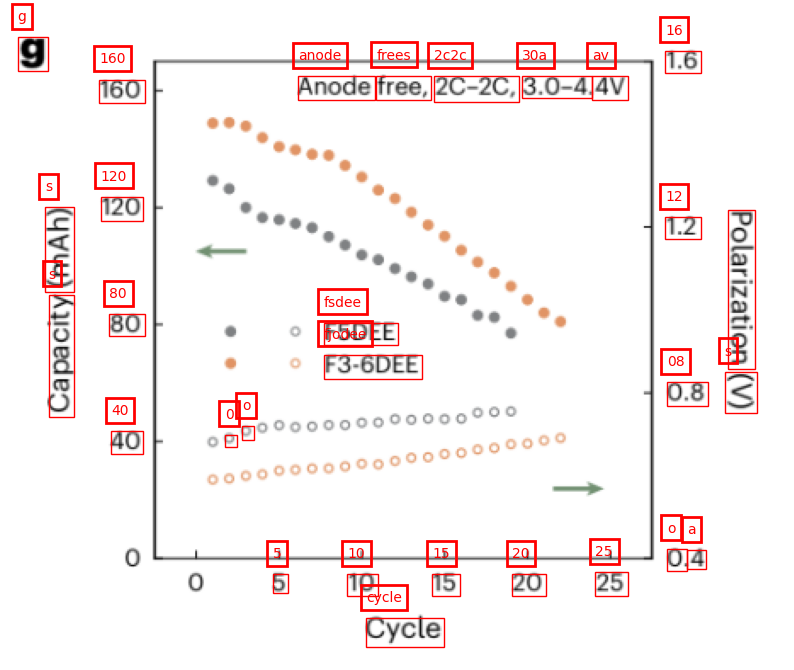

Y MIN 40
Y MAX 160
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -206.5
SEM DIFF 120.0
OCR RATIO -1.7208333333333334
PIXEL DIFF -68.5
REAL DIFF FROM BASE POINT 39.80629539951573
Y_MIN 0.19370460048426708
Y_MAX 169.87893462469734
SEMANTIC X MIN 5.0
SEMANTIC X MAX 25.0
X
OCR DIFF 195.0
SEM DIFF 20.0
OCR RATIO 0.10256410256410256
PIXEL DIFF 74.5
REAL DIFF FROM BASE POINT 7.6410256410256405
X_MIN -2.6410256410256405
X_MAX 27.41025641025641
X
Predicted [-2.6410256410256405, 27.41025641025641]
Chat GPT [0, 25]
Y
Predicted [0.19370460048426708, 169.87893462469734]
Chat GPT [40, 160]


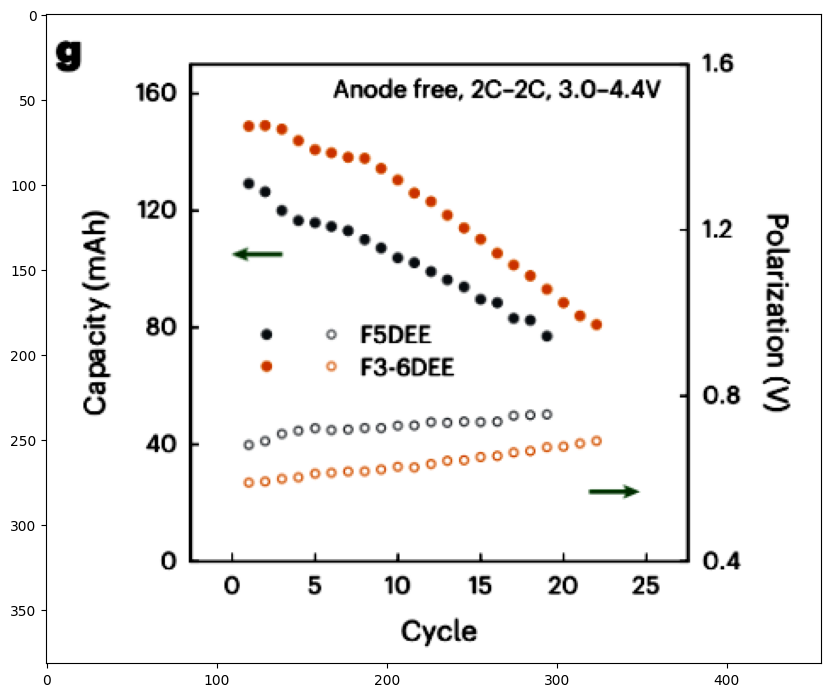

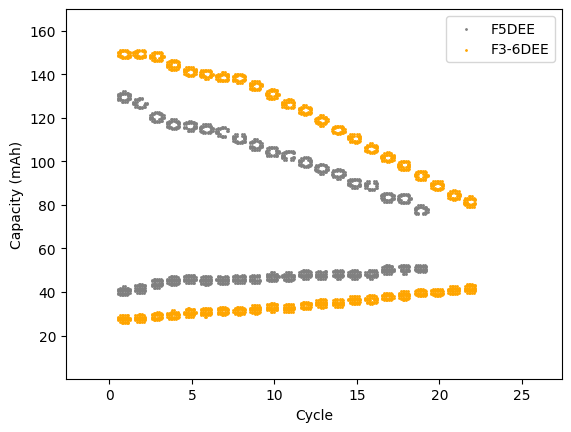

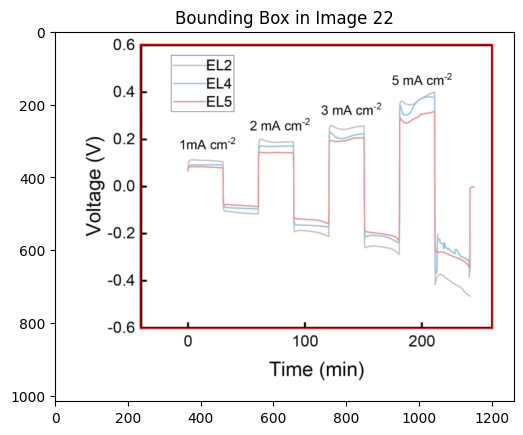

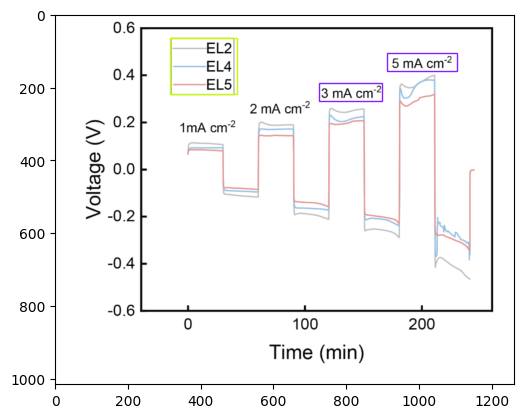

2/2 [==============================] - 2s 56ms/step


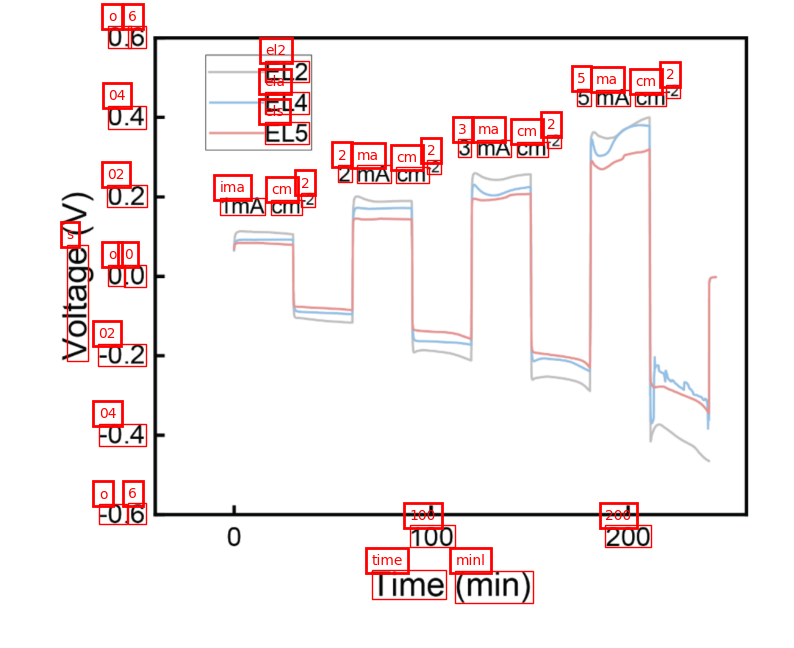

Y MIN 6
Y MAX 6
SEMANTIC Y MIN 6.0
SEMANTIC Y MAX 6.0
Y
OCR DIFF -776.42578125
SEM DIFF 0.0
OCR RATIO inf
PIXEL DIFF -2.6015625
REAL DIFF FROM BASE POINT -0.0
Y_MIN 6.0
Y_MAX 6.0
SEMANTIC X MIN 100.0
SEMANTIC X MAX 200.0
X
OCR DIFF 319.197265625
SEM DIFF 100.0
OCR RATIO 0.3132858917328014
PIXEL DIFF 454.0751953125
REAL DIFF FROM BASE POINT 142.25535247722254
X_MIN -42.255352477222544
X_MAX 260.6921048283964
X
Predicted [-42.255352477222544, 260.6921048283964]
Chat GPT [0, 250]
Y
Predicted [6.0, 6.0]
Chat GPT [-0.6, 0.6]


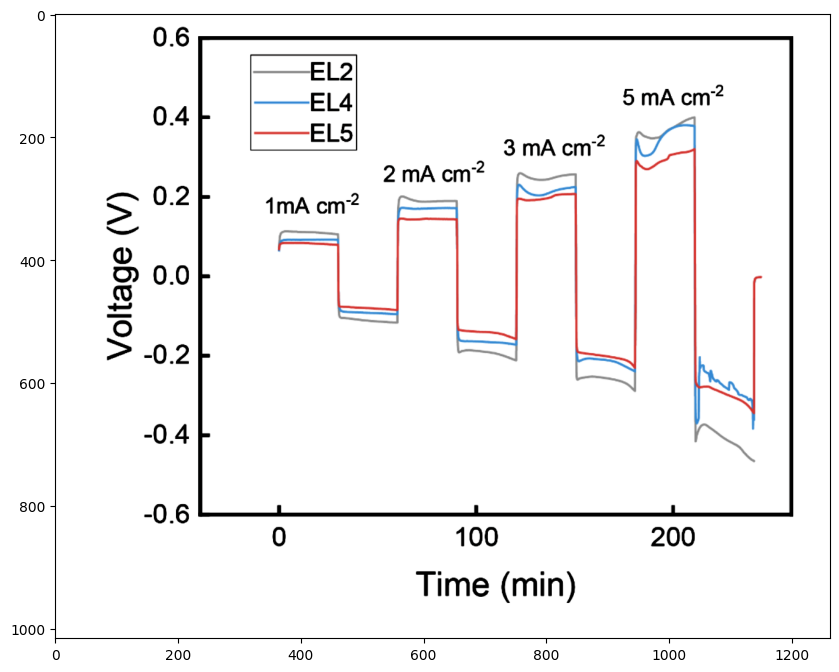

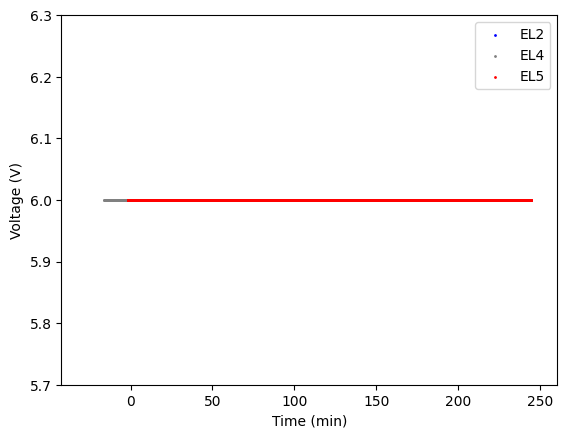

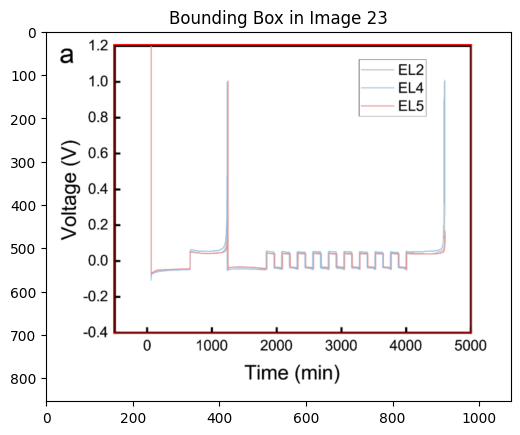

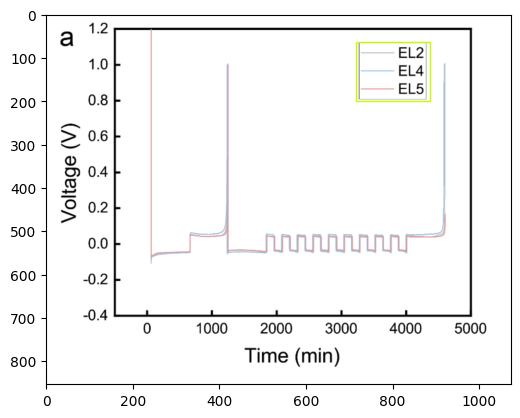

1/1 [==============================] - 1s 1s/step


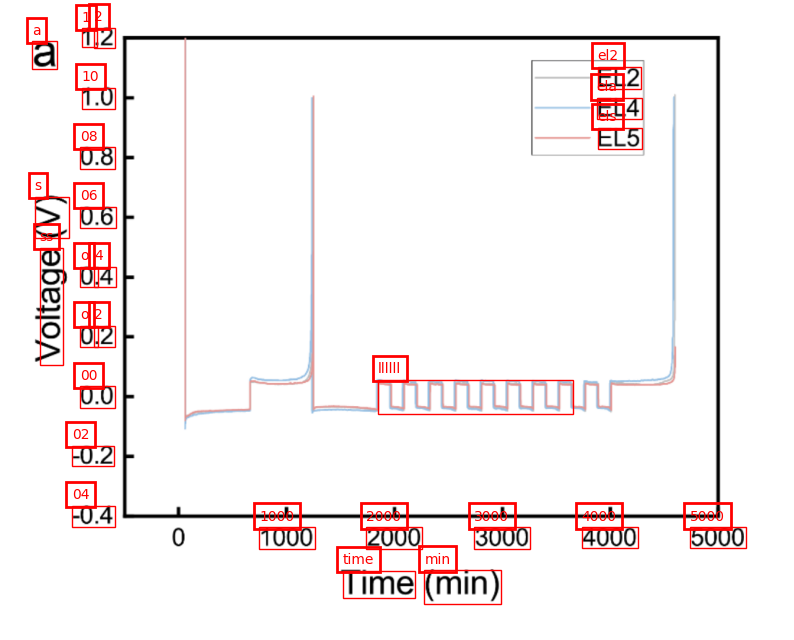

Y MIN 04
Y MAX 1
SEMANTIC Y MIN 4.0
SEMANTIC Y MAX 1.0
Y
OCR DIFF -663.908203125
SEM DIFF -3.0
OCR RATIO 221.302734375
PIXEL DIFF -0.578125
REAL DIFF FROM BASE POINT -0.0026123716981298595
Y_MIN 4.00261237169813
Y_MAX 0.9931601754525317
SEMANTIC X MIN 1000.0
SEMANTIC X MAX 5000.0
X
OCR DIFF 597.3076171875
SEM DIFF 4000.0
OCR RATIO 6.696716875693828
PIXEL DIFF 227.3466796875
REAL DIFF FROM BASE POINT 1522.4763464962405
X_MIN -522.4763464962405
X_MAX 5009.011792826861
X
Predicted [-522.4763464962405, 5009.011792826861]
Chat GPT [0, 5000]
Y
Predicted [4.00261237169813, 0.9931601754525317]
Chat GPT [-0.4, 1.2]


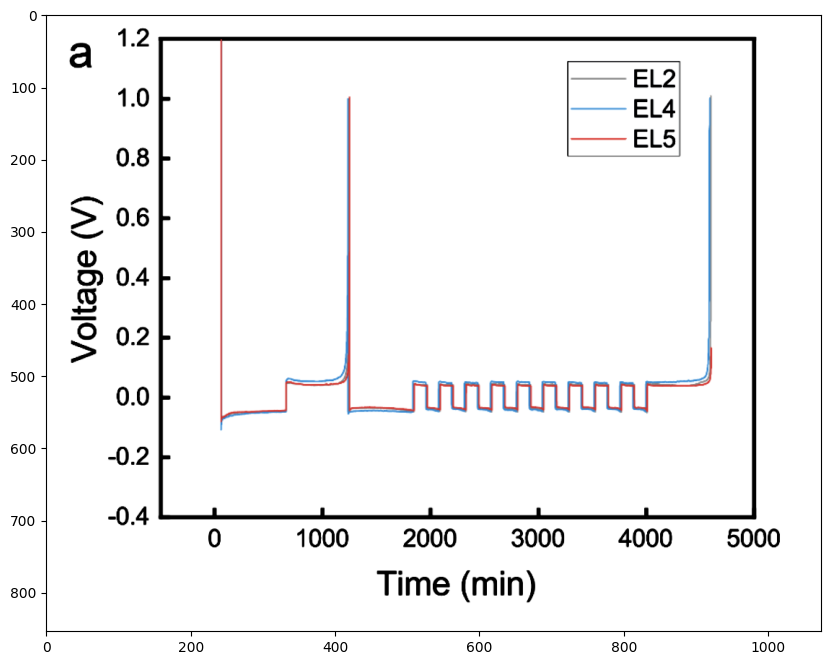

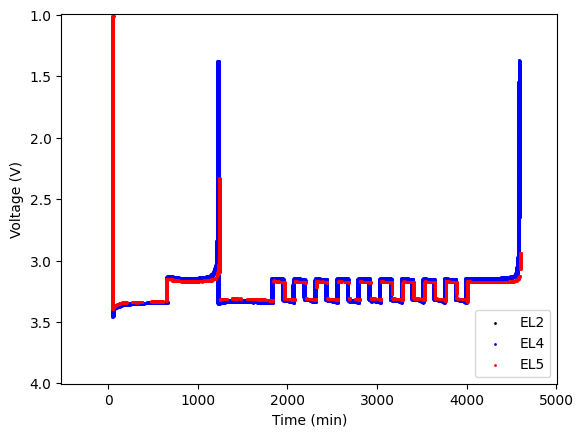

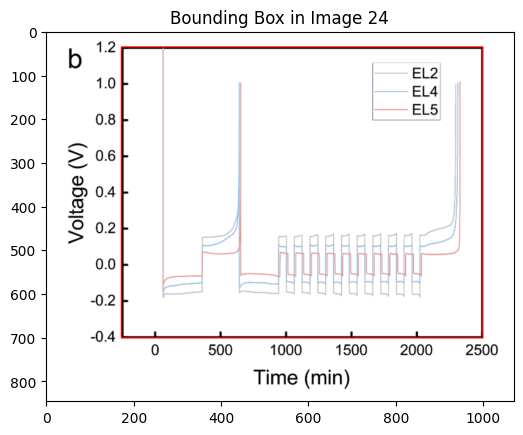

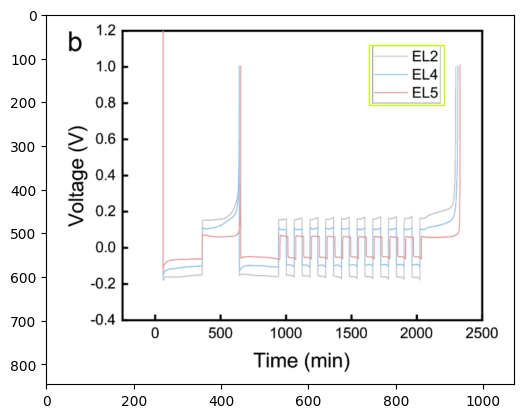

1/1 [==============================] - 1s 1s/step


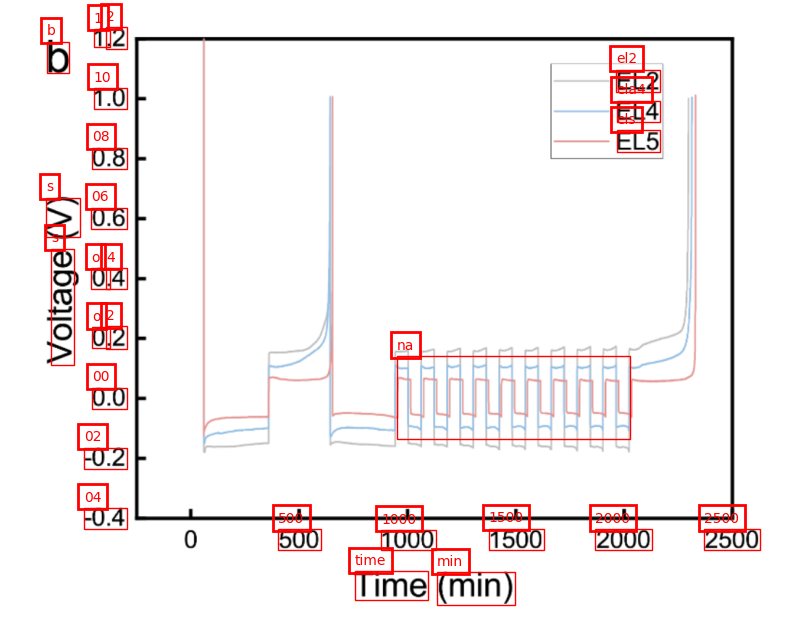

Y MIN 04
Y MAX 2
SEMANTIC Y MIN 4.0
SEMANTIC Y MAX 2.0
Y
OCR DIFF -663.0029296875
SEM DIFF -2.0
OCR RATIO 331.50146484375
PIXEL DIFF -1.4248046875
REAL DIFF FROM BASE POINT -0.004298034363653771
Y_MIN 4.004298034363654
Y_MAX 1.9982737161500332
SEMANTIC X MIN 500.0
SEMANTIC X MAX 2500.0
X
OCR DIFF 597.6953125
SEM DIFF 2000.0
OCR RATIO 3.346186523756617
PIXEL DIFF 227.16015625
REAL DIFF FROM BASE POINT 760.1202535781974
X_MIN -260.12025357819743
X_MAX 2503.829815044768
X
Predicted [-260.12025357819743, 2503.829815044768]
Chat GPT [0, 2500]
Y
Predicted [4.004298034363654, 1.9982737161500332]
Chat GPT [-0.4, 1.2]


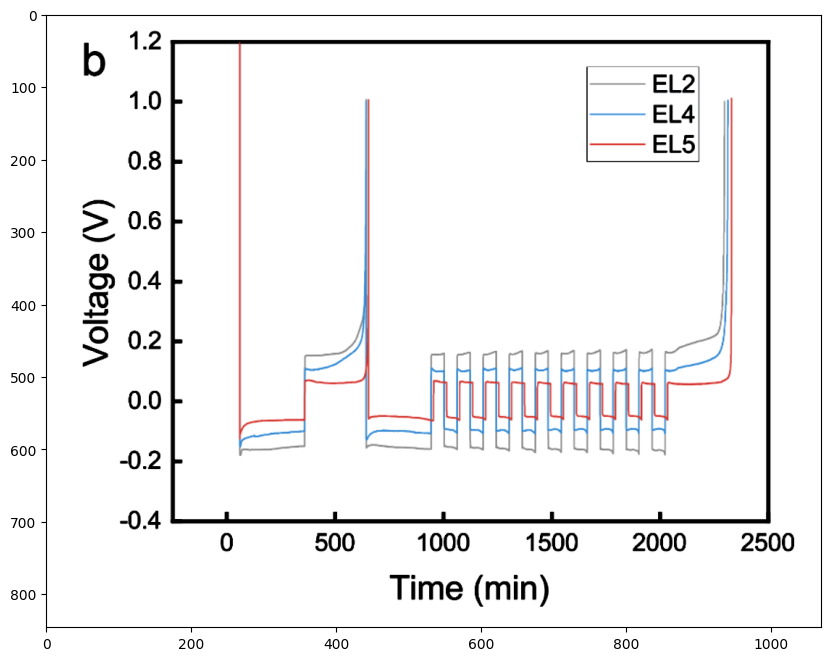

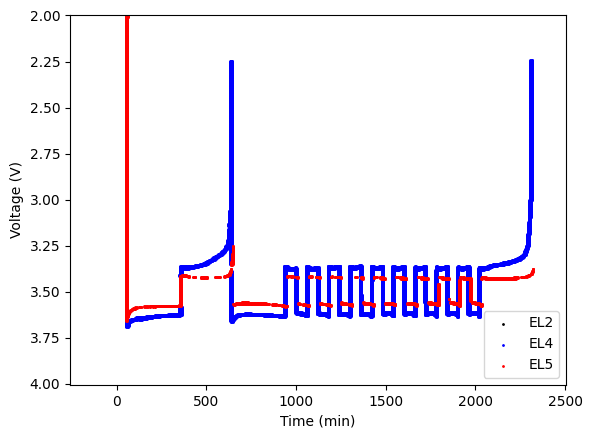

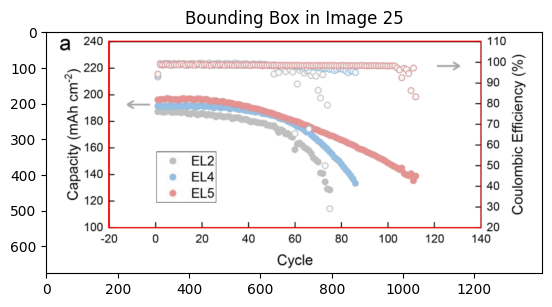

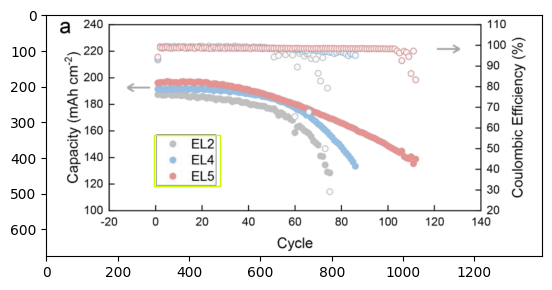

2/2 [==============================] - 2s 335ms/step


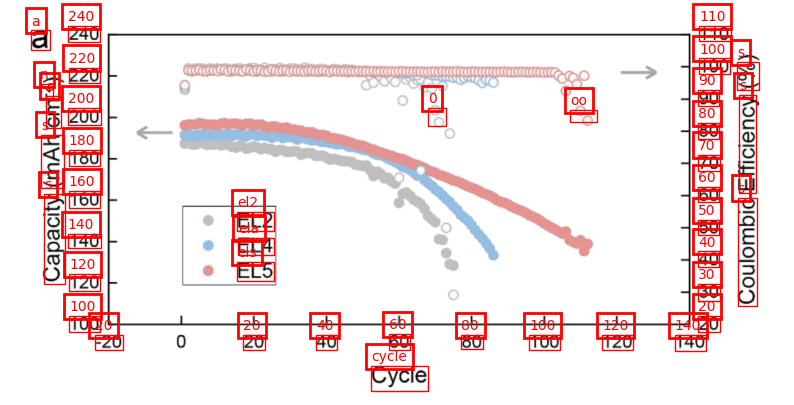

Y MIN 100
Y MAX 240
SEMANTIC Y MIN 100.0
SEMANTIC Y MAX 240.0
Y
OCR DIFF -519.892578125
SEM DIFF 140.0
OCR RATIO -3.7135184151785716
PIXEL DIFF -1.2802734375
REAL DIFF FROM BASE POINT 0.3447602231530702
Y_MIN 99.65523977684693
Y_MAX 239.95345342524934
SEMANTIC X MIN 20.0
SEMANTIC X MAX 140.0
X
OCR DIFF 1042.5
SEM DIFF 120.0
OCR RATIO 0.11510791366906475
PIXEL DIFF 2.1435546875
REAL DIFF FROM BASE POINT 0.24674010791366907
X_MIN 19.75325989208633
X_MAX 139.92592176258992
X
Predicted [19.75325989208633, 139.92592176258992]
Chat GPT [-20, 140]
Y
Predicted [99.65523977684693, 239.95345342524934]
Chat GPT [100, 240]


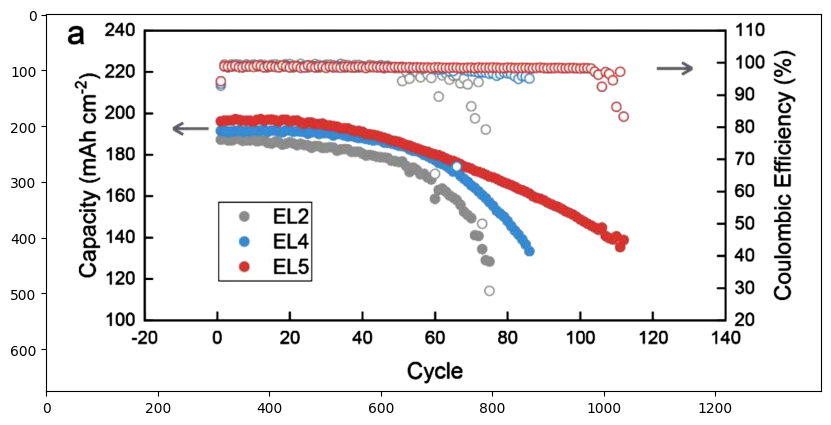

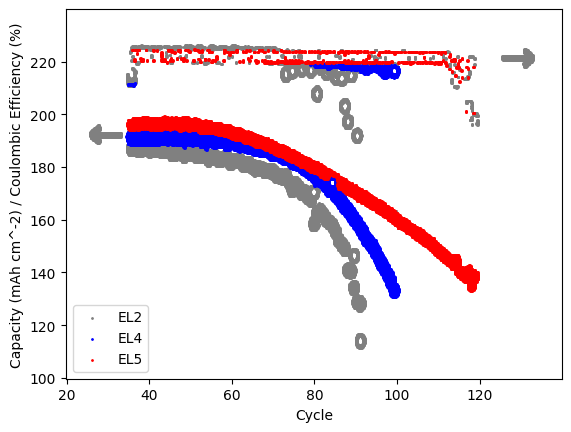

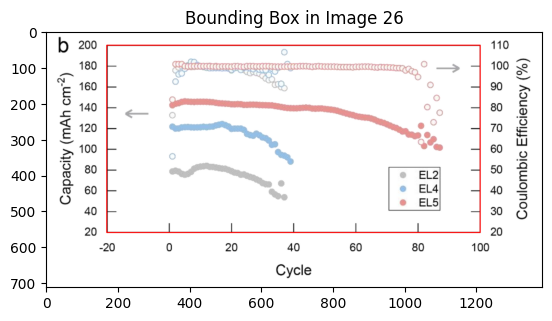

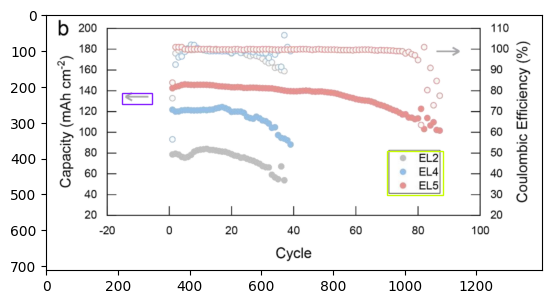

2/2 [==============================] - 2s 313ms/step


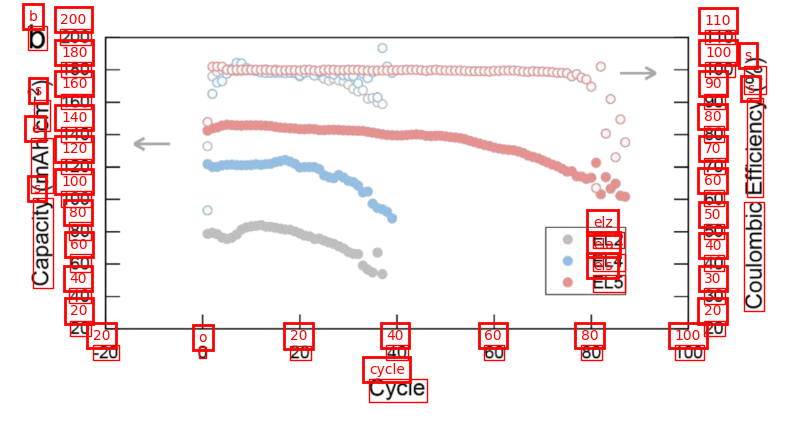

Y MIN 20
Y MAX 200
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 200.0
Y
OCR DIFF -519.67578125
SEM DIFF 180.0
OCR RATIO -2.887087673611111
PIXEL DIFF -1.8046875
REAL DIFF FROM BASE POINT 0.625089260882311
Y_MIN 19.374910739117688
Y_MAX 199.83358013184304
SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 1042.0546875
SEM DIFF 80.0
OCR RATIO 0.07677140265251194
PIXEL DIFF 1.97265625
REAL DIFF FROM BASE POINT 0.15144358726374424
X_MIN 19.848556412736254
X_MAX 99.8443579766537
X
Predicted [19.848556412736254, 99.8443579766537]
Chat GPT [-20, 100]
Y
Predicted [19.374910739117688, 199.83358013184304]
Chat GPT [20, 200]


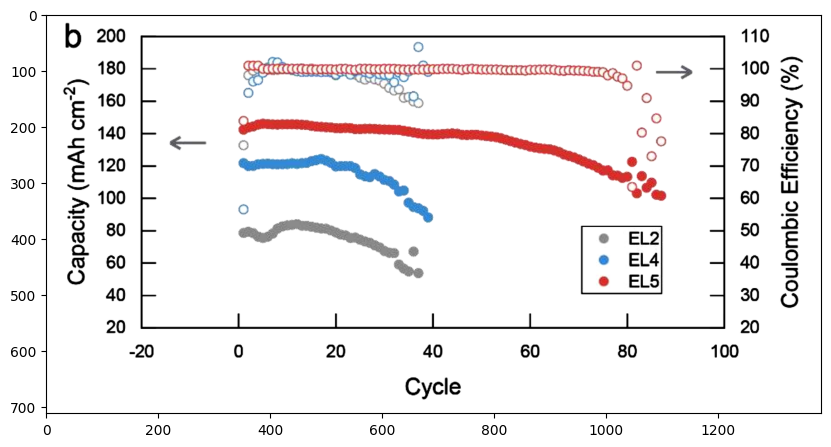

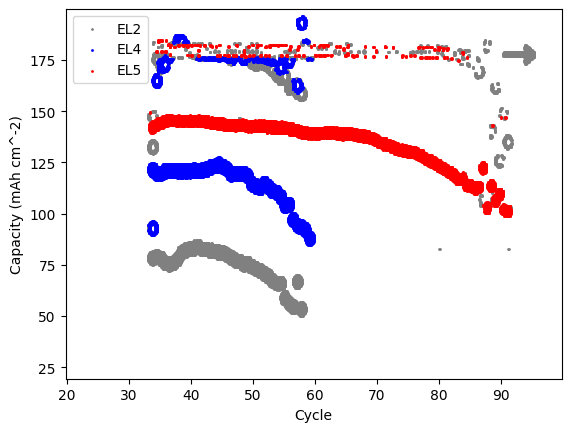

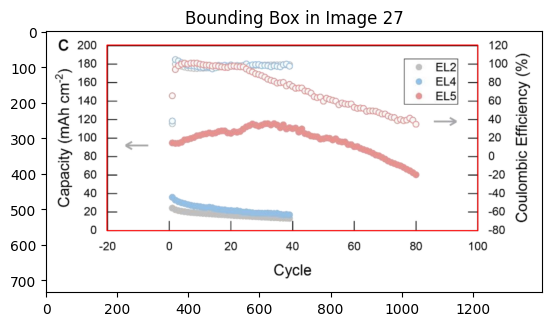

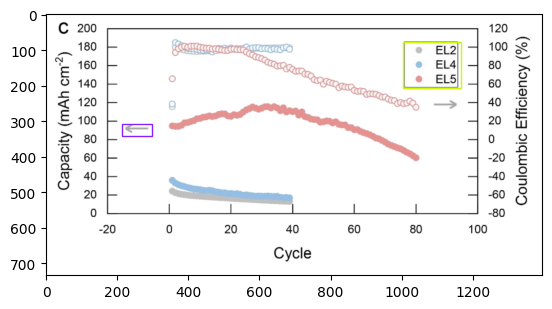

2/2 [==============================] - 2s 427ms/step


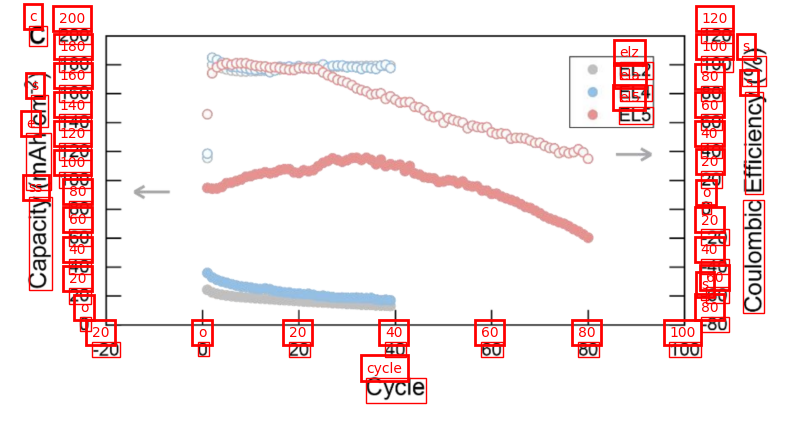

Y MIN 20
Y MAX 200
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 200.0
Y
OCR DIFF -467.60546875
SEM DIFF 180.0
OCR RATIO -2.5978081597222222
PIXEL DIFF -53.177734375
REAL DIFF FROM BASE POINT 20.47023148186823
Y_MIN -0.47023148186822894
Y_MAX 200.4683936611894
SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 1042.91015625
SEM DIFF 80.0
OCR RATIO 0.0767084293125082
PIXEL DIFF 1.455078125
REAL DIFF FROM BASE POINT 0.11161675749573946
X_MIN 19.88838324250426
X_MAX 99.97198344476281
X
Predicted [19.88838324250426, 99.97198344476281]
Chat GPT [-20, 100]
Y
Predicted [-0.47023148186822894, 200.4683936611894]
Chat GPT [0, 200]


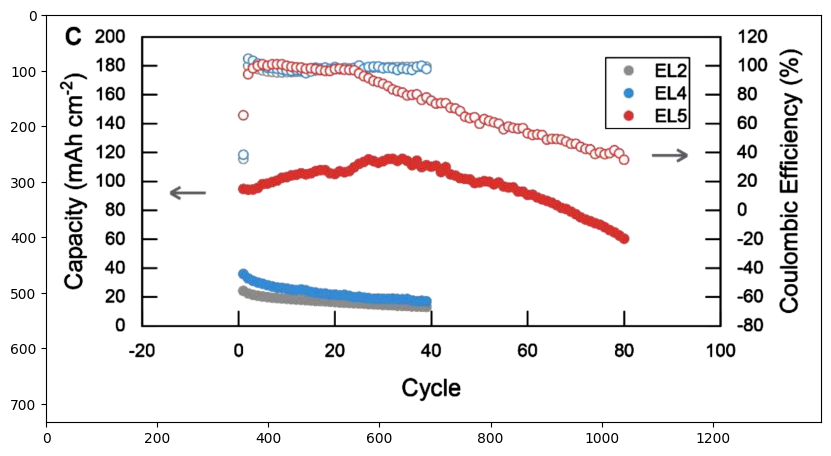

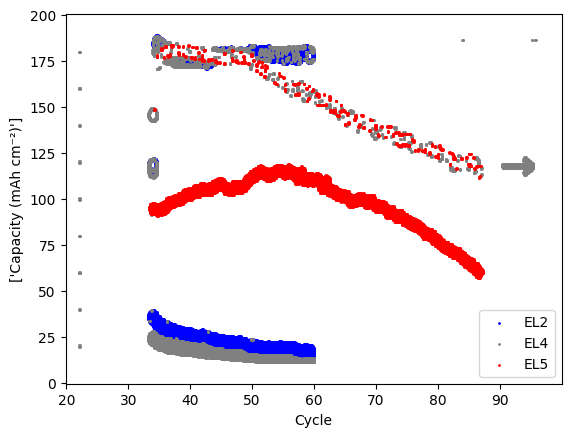

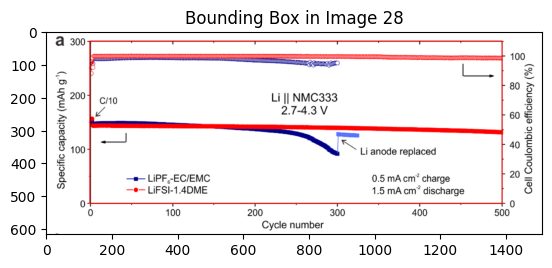

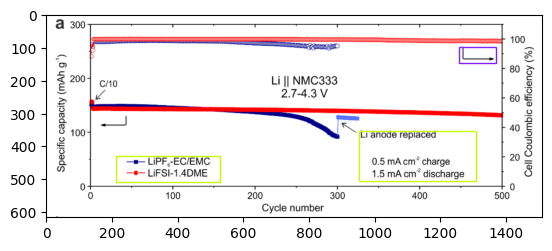

2/2 [==============================] - 3s 842ms/step


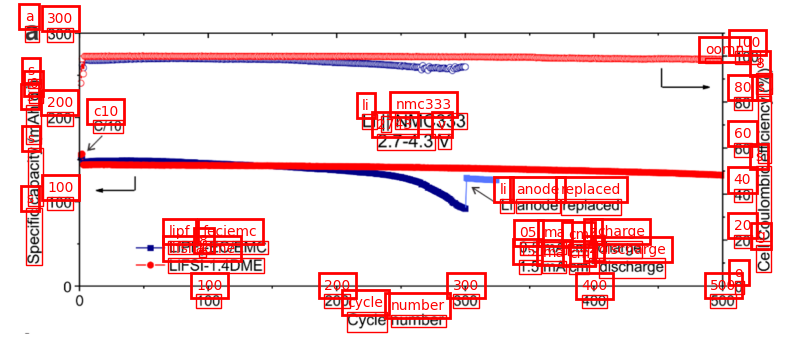

Y MIN 100
Y MAX 300
SEMANTIC Y MIN 100.0
SEMANTIC Y MAX 300.0
Y
OCR DIFF -328.1005859375
SEM DIFF 200.0
OCR RATIO -1.6405029296875
PIXEL DIFF -162.4580078125
REAL DIFF FROM BASE POINT 99.02939206786219
Y_MIN 0.9706079321378098
Y_MAX 301.48820596770594
SEMANTIC X MIN 100.0
SEMANTIC X MAX 500.0
X
OCR DIFF 1001.9970703125
SEM DIFF 400.0
OCR RATIO 0.39920276401132504
PIXEL DIFF 254.0849609375
REAL DIFF FROM BASE POINT 101.43141869995955
X_MIN -1.4314186999595506
X_MAX 499.5680501342533
X
Predicted [-1.4314186999595506, 499.5680501342533]
Chat GPT [0, 500]
Y
Predicted [0.9706079321378098, 301.48820596770594]
Chat GPT [0, 300]


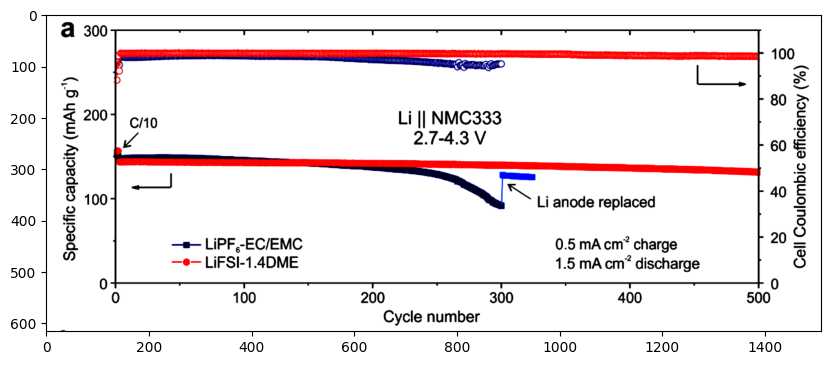

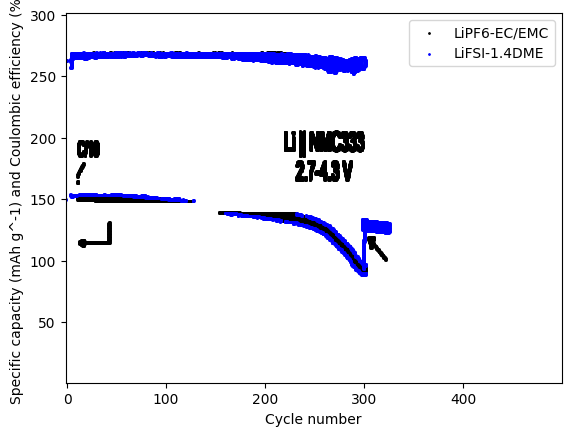

In [10]:
for image_num in range(1,29):
    coordinates, x_axis_title, y_axis_title, axis_labels, rgb_colors, x_range, y_range, memo = get_reconstructed_plot(image_num, predictor, model, pipeline, True, 30)
        
    plt.figure()
    for index, value in enumerate(coordinates):
        x = []
        y = []

        for i in range(len(value)):
            x.append(value[i]["middle"][0])
            y.append(value[i]["middle"][1])

        color_normalized = rgb_colors[index]

        if (is_valid_color(color_normalized)): plt.scatter(x, y, label=axis_labels[index], color=color_normalized, s=1)

    plt.xlim(x_range[0], x_range[1])
    plt.ylim(y_range[0], y_range[1])
    plt.xlabel(x_axis_title)
    plt.ylabel(y_axis_title)
    plt.legend()
    plt.show()

In [11]:
import cv2
import pytesseract
from pytesseract import Output
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def get_true_range(image_name, boundingBox, ocr_pipeline, chat_gpt_info):
    # Read the image using OpenCV
    img = cv2.imread(image_name)
    # Convert the image to RGB (required by pytesseract when using OpenCV images)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert the OpenCV image to a PIL Image (optional, if you want to use PIL operations)
    image_for_ocr = Image.fromarray(img_rgb)

    # Specify pytesseract configuration to focus on alphanumeric characters
    custom_config = r'--oem 3 --psm 11 -c tessedit_char_whitelist=0123456789.-'
    # Perform OCR using pytesseract
    tesseract_ocr_results = pytesseract.image_to_data(image_for_ocr, config=custom_config, output_type=Output.DICT)

    # Process OCR results to match the desired output format
    ocr_results = []
    n_boxes = len(tesseract_ocr_results['text'])
    for i in range(n_boxes):
        if int(tesseract_ocr_results['conf'][i]) > 60:  # Consider only results with confidence > 60
            text = tesseract_ocr_results['text'][i]
            x, y, w, h = tesseract_ocr_results['left'][i], tesseract_ocr_results['top'][i], tesseract_ocr_results['width'][i], tesseract_ocr_results['height'][i]
            # Convert the bounding box to the desired format
            top_left = [x, y]
            top_right = [x + w, y]
            bottom_right = [x + w, y + h]
            bottom_left = [x, y + h]
            box = [top_left, top_right, bottom_right, bottom_left]
            ocr_results.append((text, box))

    # Assuming 'img' is your loaded image and 'ocr_results' contains the OCR results.
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img)

    for text, box in ocr_results:
        # Extract the bounding box coordinates
        start_point = box[0]
        end_point = box[2]
        box_width = end_point[0] - start_point[0]
        box_height = end_point[1] - start_point[1]
        
        # Create a Rectangle patch
        rect = patches.Rectangle(start_point, box_width, box_height, linewidth=1, edgecolor='r', facecolor='none')
        
        # Add the rectangle to the Axes
        ax.add_patch(rect)
        
        # Annotate the image with the OCR'ed text
        ax.text(start_point[0], start_point[1] - 10, text, bbox=dict(fill=False, edgecolor='red', linewidth=2), color='red')

    plt.axis('off')  # Turn off axis numbers and ticks
    plt.show()

    try:
        ymin, ymax, y_scale = calculate_y_axis(ocr_results, boundingBox, chat_gpt_info['y'])
    except:
        ymin, ymax = None, None

    try:
        xmin, xmax, x_scale = calculate_x_axis(ocr_results, boundingBox, chat_gpt_info['x'])
    except:
        xmin, xmax = None, None

    x_range = []
    for x in [xmin, xmax]:
        if x is None or np.isnan(x) or not np.isfinite(x):
            x_range = chat_gpt_info['x']
            print("x is in fault condition")
            break
        
        x_range.append(x)
    
    y_range = []
    for y in [ymin, ymax]:
        if y is None or np.isnan(y) or not np.isfinite(y):
            y_range = chat_gpt_info['y']
            print("y is in fault condition")
            break

        y_range.append(y)


    return x_range, y_range

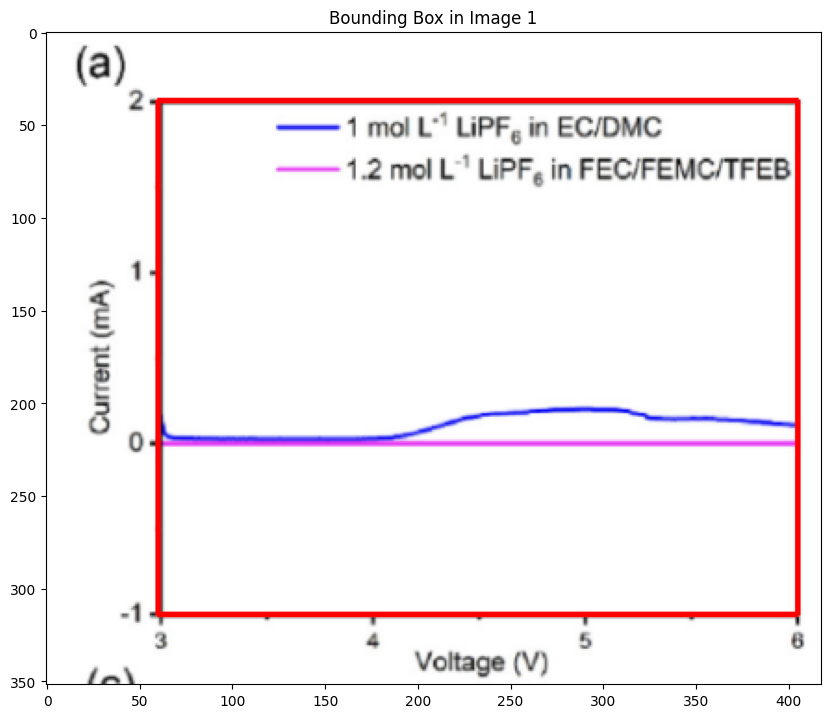

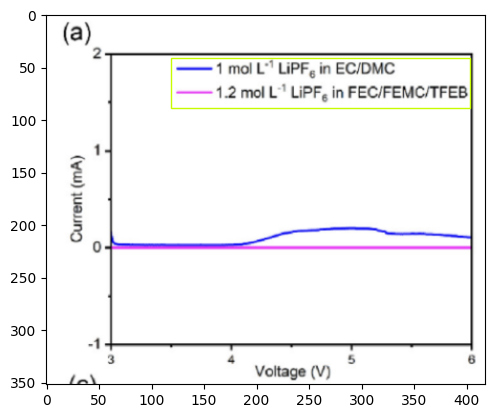

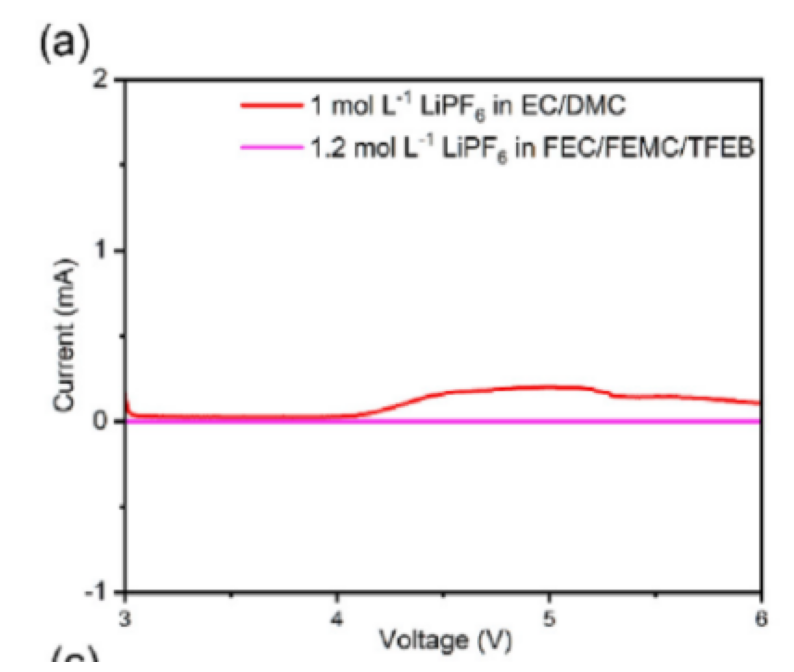

x is in fault condition
y is in fault condition
X
Predicted [3, 6]
Chat GPT [3, 6]
Y
Predicted [-1, 2]
Chat GPT [-1, 2]


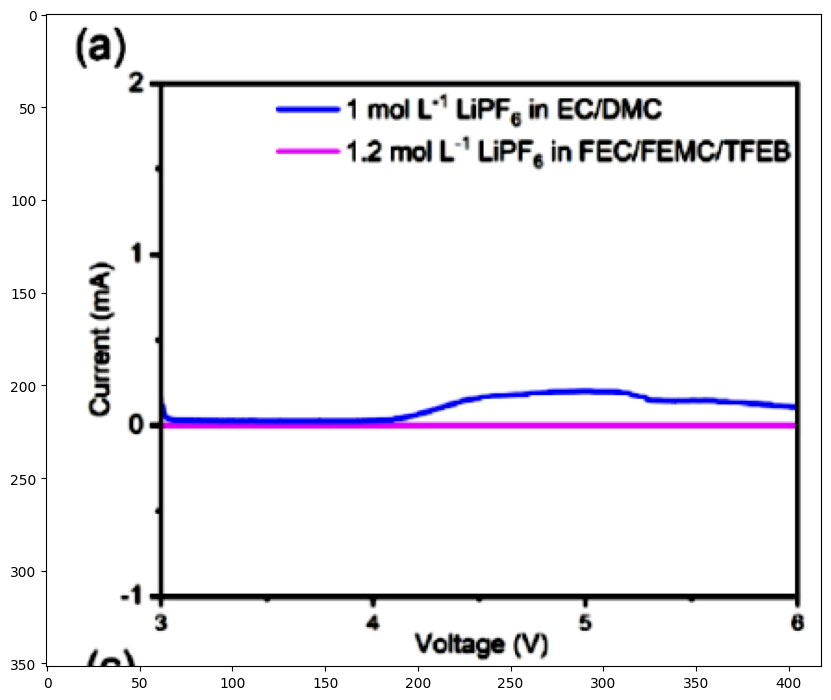

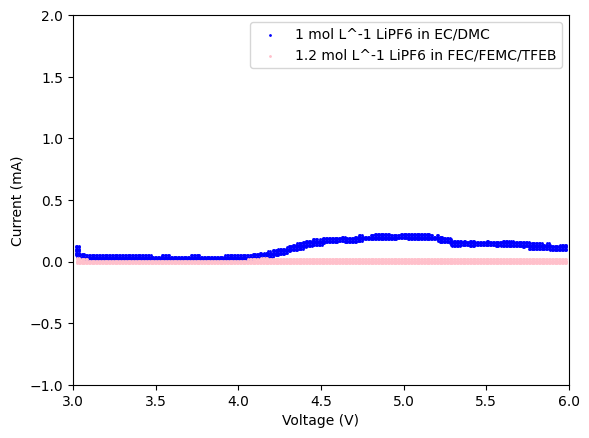

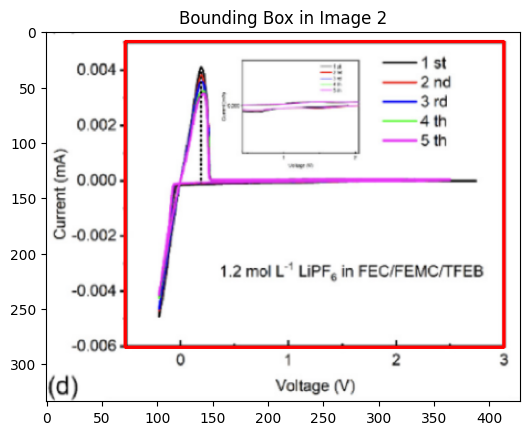

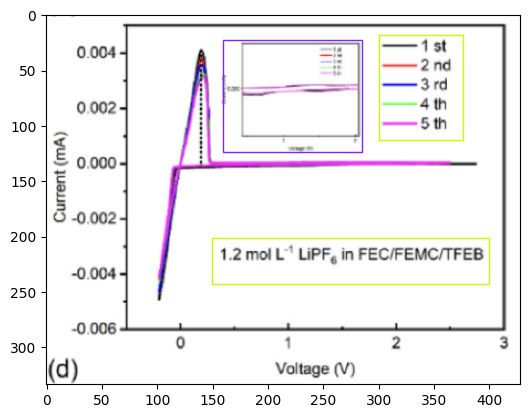

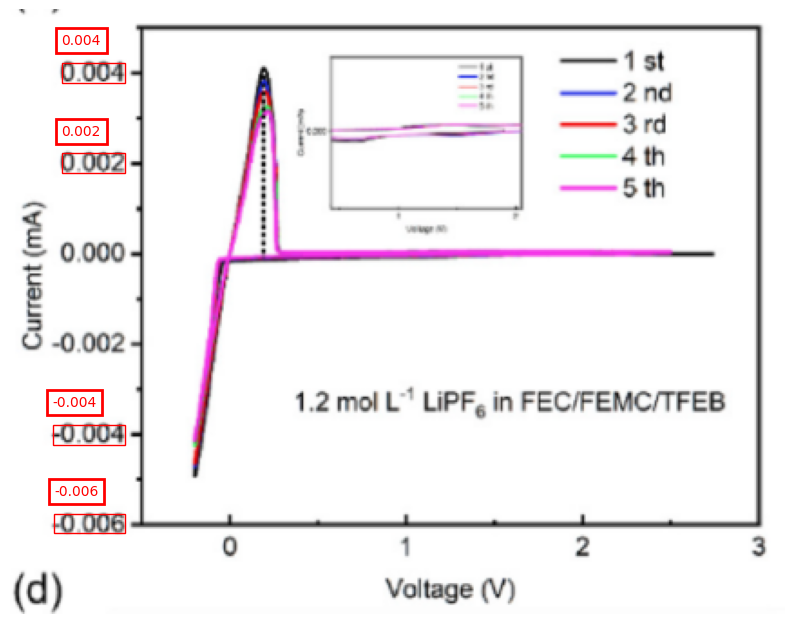

Y MIN -0.006
Y MAX 0.004
SEMANTIC Y MIN -0.006
SEMANTIC Y MAX 0.004
Y
OCR DIFF -249.0
SEM DIFF 0.01
OCR RATIO -24900.0
PIXEL DIFF -1.5
REAL DIFF FROM BASE POINT 6.0240963855421684e-05
Y_MIN -0.006060240963855421
Y_MAX 0.005024096385542169
x is in fault condition
X
Predicted [0, 3]
Chat GPT [0, 3]
Y
Predicted [-0.006060240963855421, 0.005024096385542169]
Chat GPT [-0.006, 0.004]


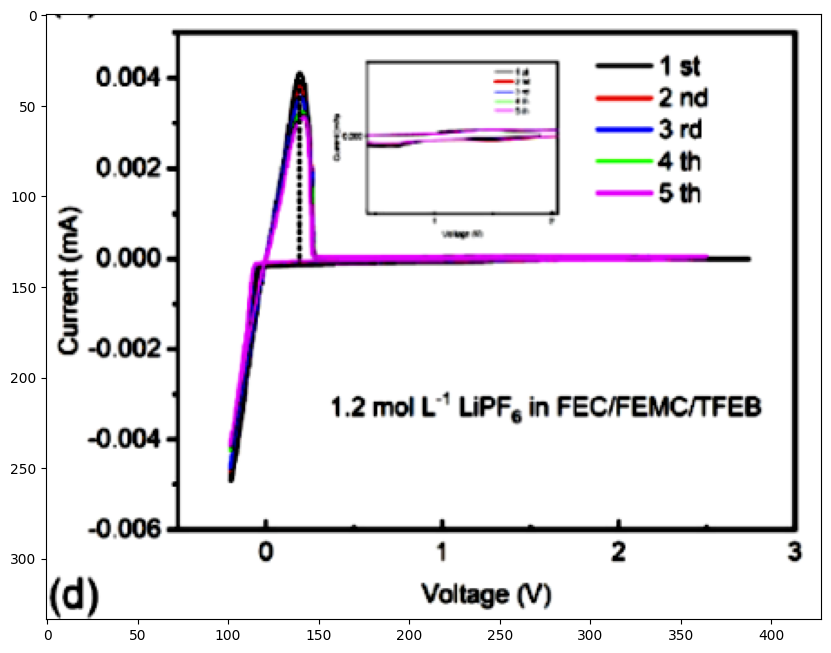

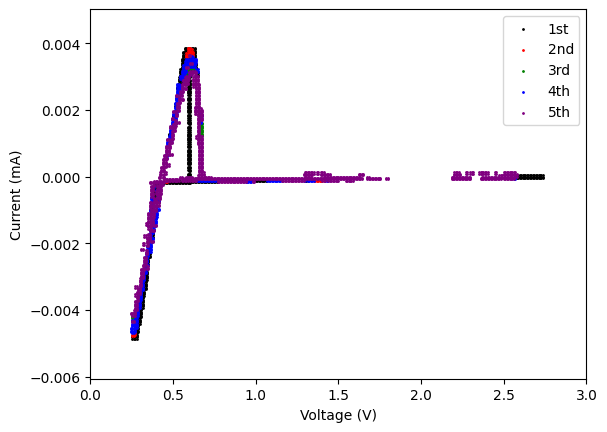

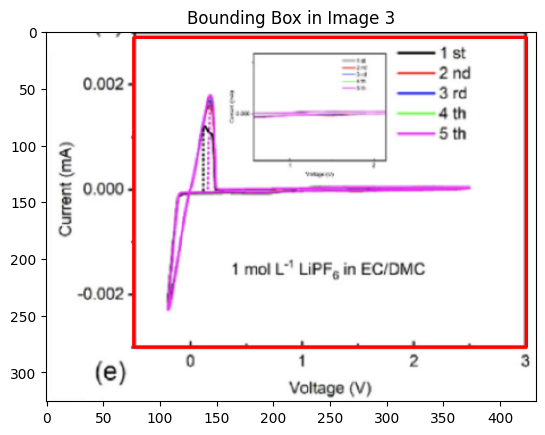

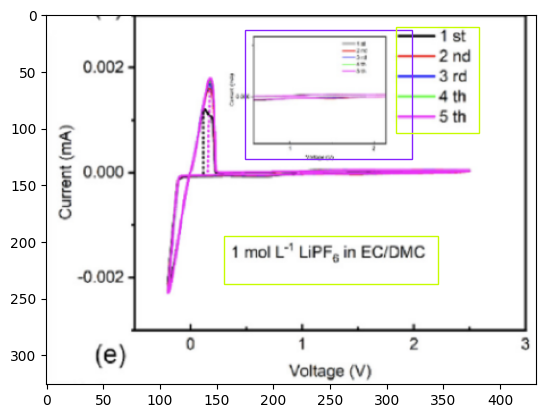

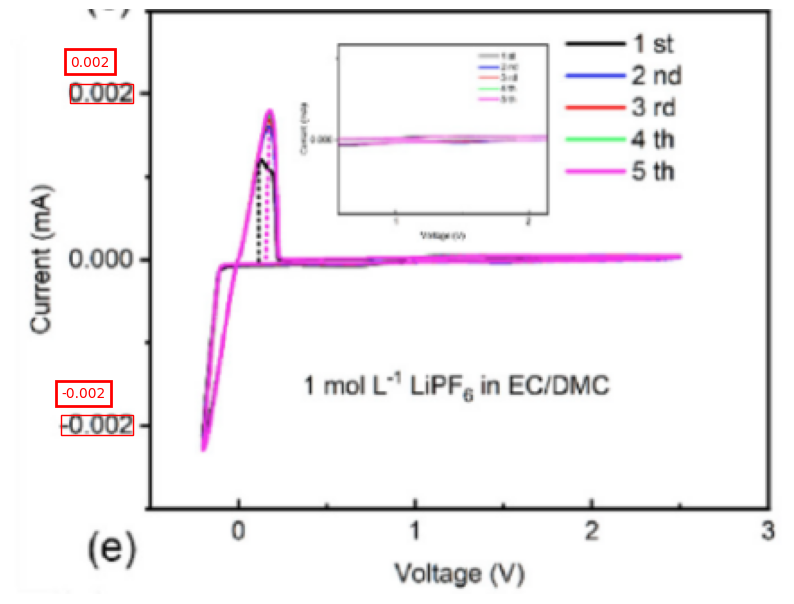

Y MIN -0.002
Y MAX 0.002
SEMANTIC Y MIN -0.002
SEMANTIC Y MAX 0.002
Y
OCR DIFF -185.0
SEM DIFF 0.004
OCR RATIO -46250.0
PIXEL DIFF -46.5
REAL DIFF FROM BASE POINT 0.0010054054054054054
Y_MIN -0.0030054054054054055
Y_MAX 0.002897297297297297
x is in fault condition
X
Predicted [0, 3]
Chat GPT [0, 3]
Y
Predicted [-0.0030054054054054055, 0.002897297297297297]
Chat GPT [-0.002, 0.002]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


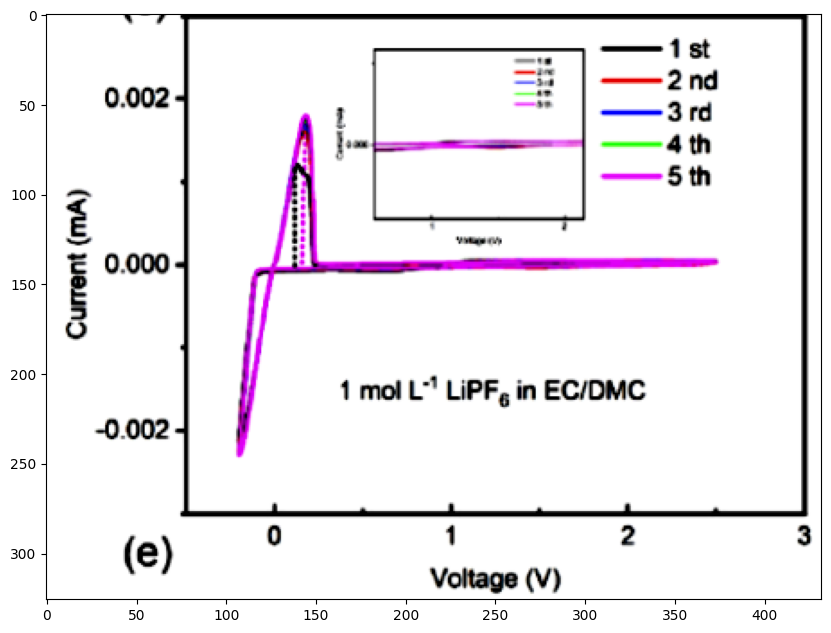

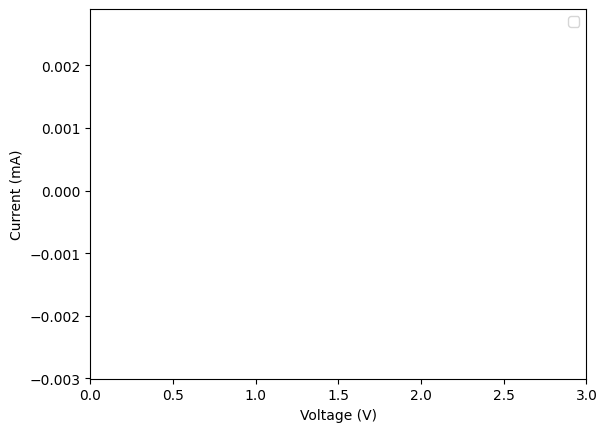

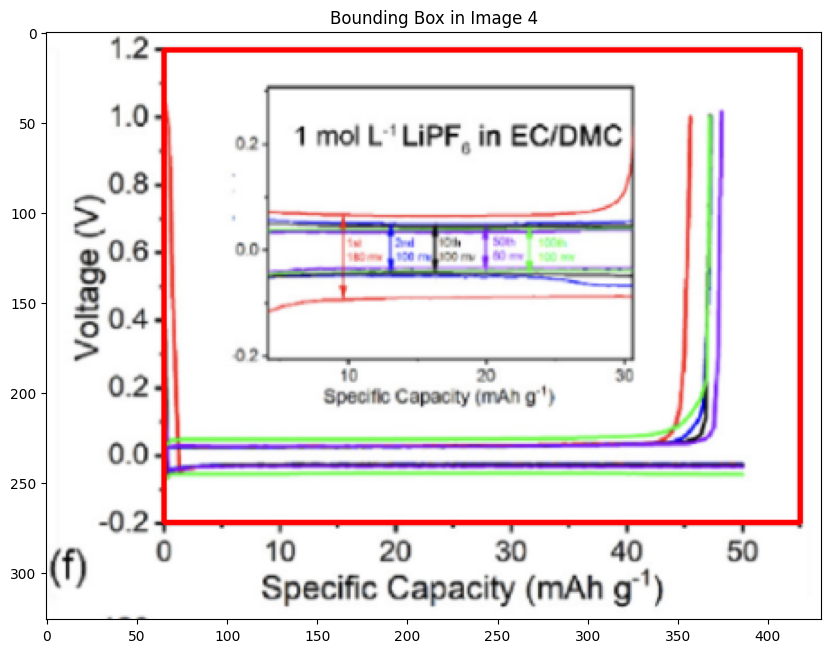

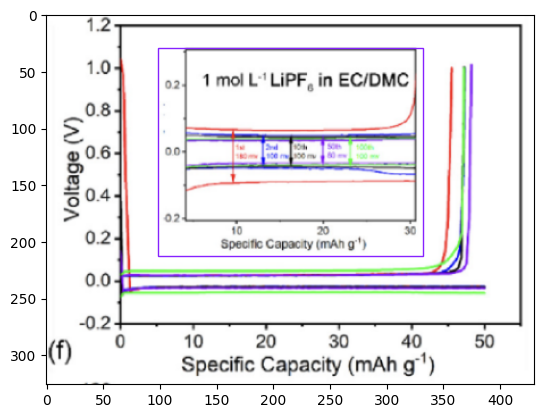

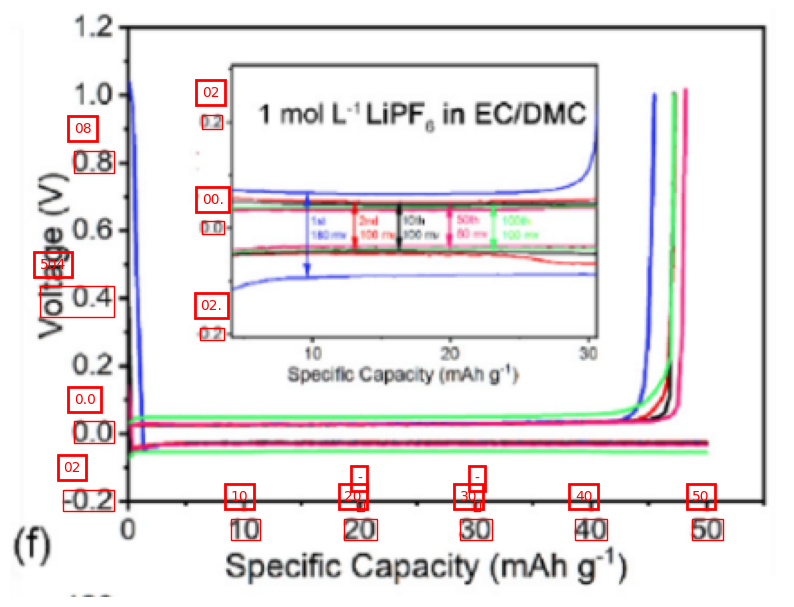

Y MIN 02
Y MAX 08
SEMANTIC Y MIN 2.0
SEMANTIC Y MAX 8.0
Y
OCR DIFF -188.0
SEM DIFF 6.0
OCR RATIO -31.333333333333332
PIXEL DIFF 0.0
REAL DIFF FROM BASE POINT -0.0
Y_MIN 2.0
Y_MAX 10.361702127659575
SEMANTIC X MIN 2.0
SEMANTIC X MAX 50.0
X
OCR DIFF 343.5
SEM DIFF 48.0
OCR RATIO 0.13973799126637554
PIXEL DIFF -22.0
REAL DIFF FROM BASE POINT -3.074235807860262
X_MIN 5.074235807860262
X_MAX 54.40174672489083
X
Predicted [5.074235807860262, 54.40174672489083]
Chat GPT [0, 50]
Y
Predicted [2.0, 10.361702127659575]
Chat GPT [-0.2, 1.2]


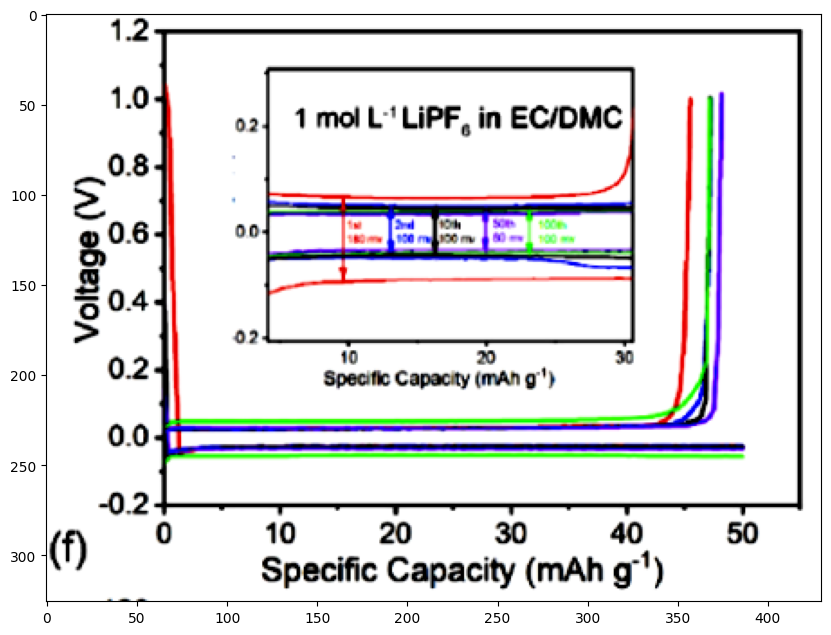

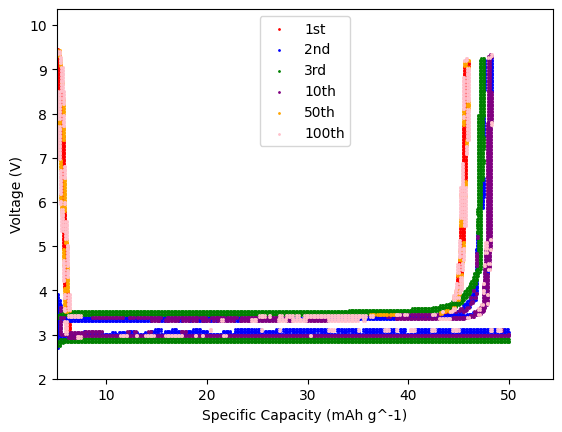

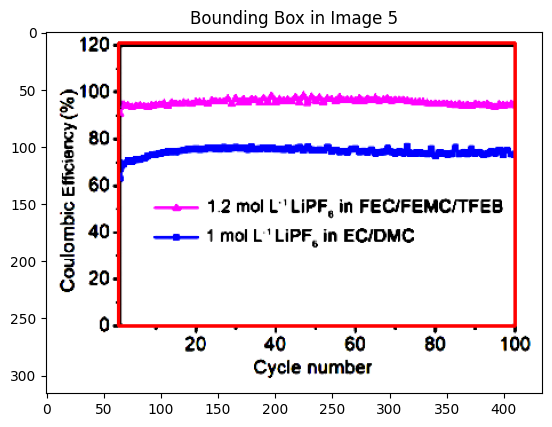

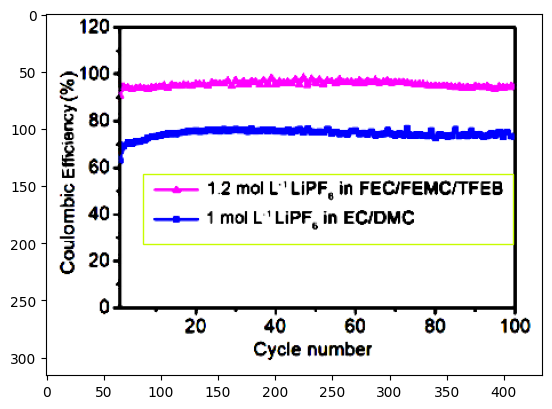

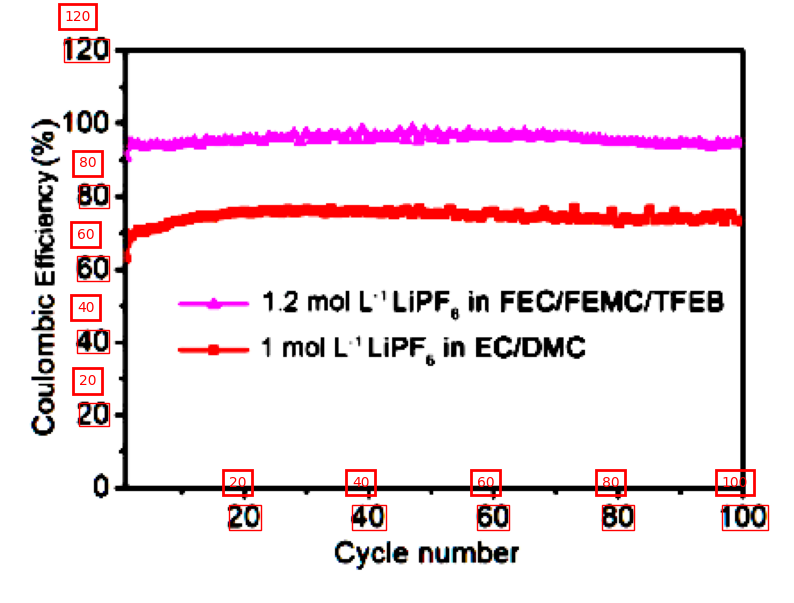

Y MIN 20
Y MAX 120
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 120.0
Y
OCR DIFF -204.0
SEM DIFF 100.0
OCR RATIO -2.04
PIXEL DIFF -41.5
REAL DIFF FROM BASE POINT 20.34313725490196
Y_MIN -0.34313725490196134
Y_MAX 120.73529411764706
SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 280.0
SEM DIFF 80.0
OCR RATIO 0.2857142857142857
PIXEL DIFF 68.0
REAL DIFF FROM BASE POINT 19.428571428571427
X_MIN 0.571428571428573
X_MAX 99.71428571428571
X
Predicted [0.571428571428573, 99.71428571428571]
Chat GPT [0, 100]
Y
Predicted [-0.34313725490196134, 120.73529411764706]
Chat GPT [20, 120]


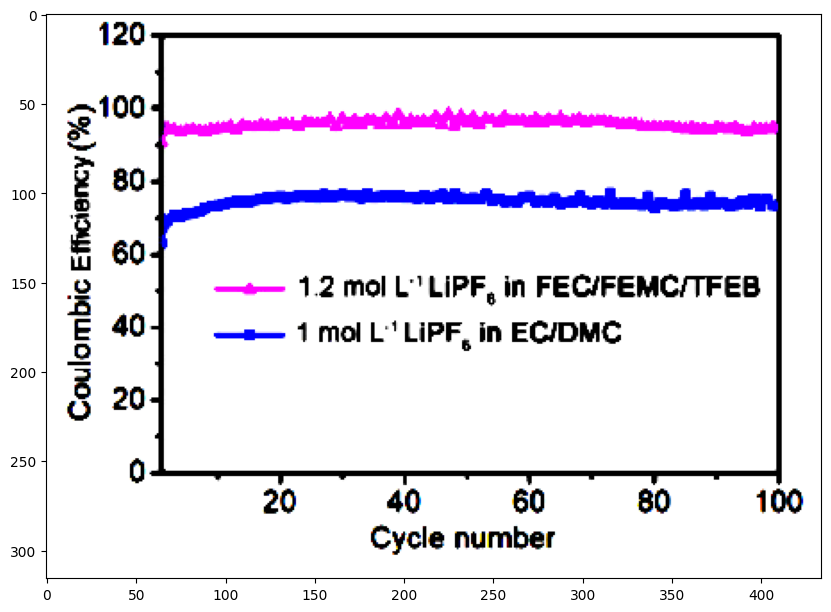

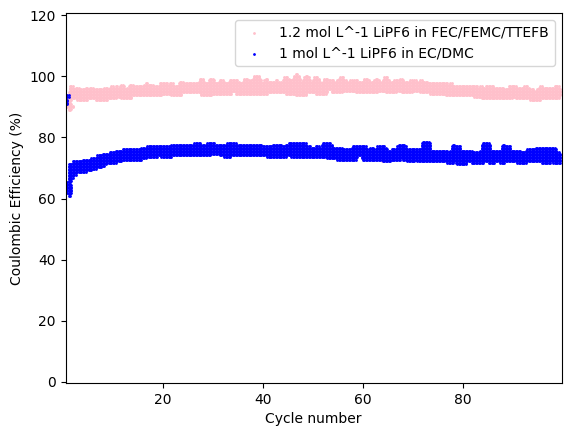

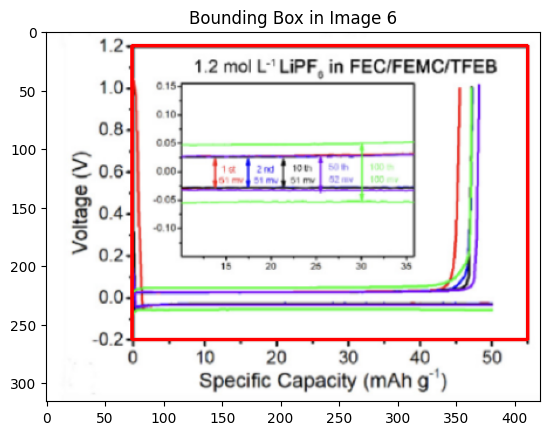

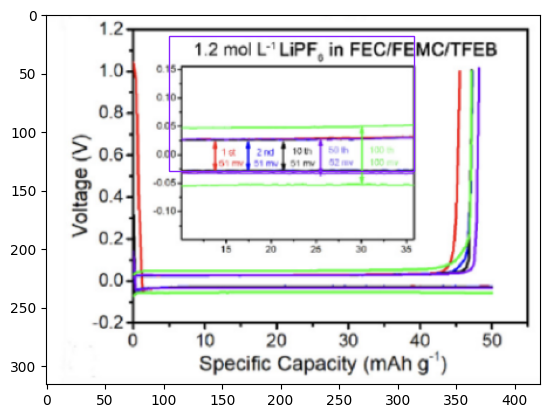

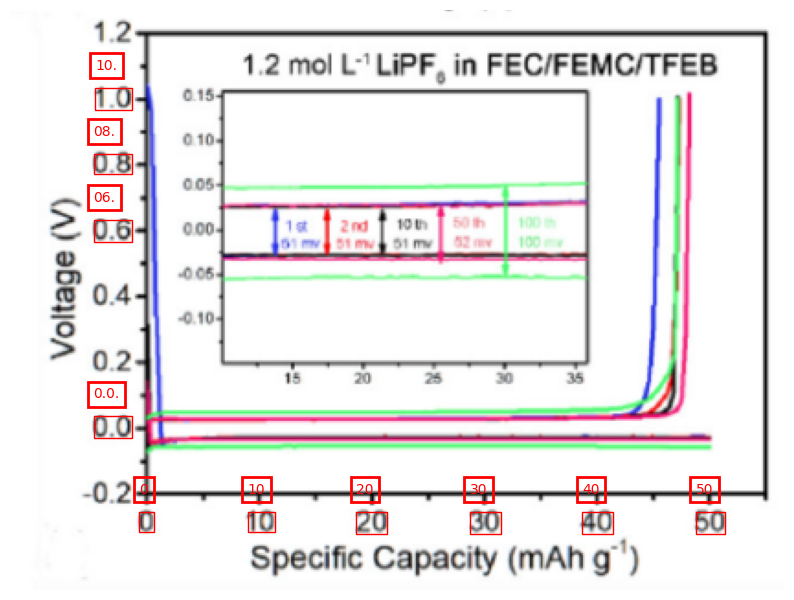

Y MIN 06.
Y MAX 10.
SEMANTIC Y MIN 6.0
SEMANTIC Y MAX 10.0
Y
OCR DIFF -72.0
SEM DIFF 4.0
OCR RATIO -18.0
PIXEL DIFF -143.0
REAL DIFF FROM BASE POINT 7.944444444444445
Y_MIN -1.9444444444444446
Y_MAX 12.0
SEMANTIC X MIN 0.0
SEMANTIC X MAX 50.0
X
OCR DIFF 307.0
SEM DIFF 50.0
OCR RATIO 0.16286644951140064
PIXEL DIFF 1.0
REAL DIFF FROM BASE POINT 0.16286644951140064
X_MIN -0.16286644951140064
X_MAX 54.88599348534202
X
Predicted [-0.16286644951140064, 54.88599348534202]
Chat GPT [0, 50]
Y
Predicted [-1.9444444444444446, 12.0]
Chat GPT [-0.2, 1.2]


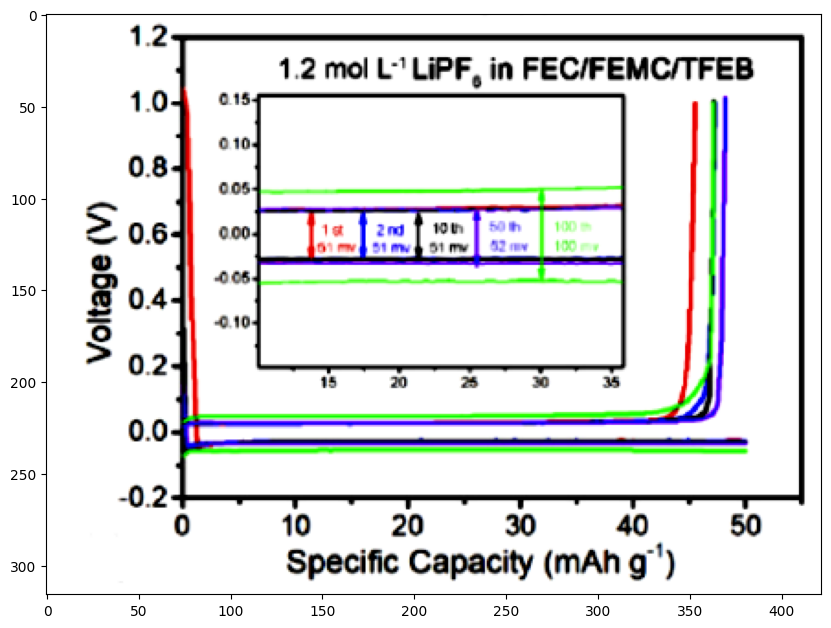

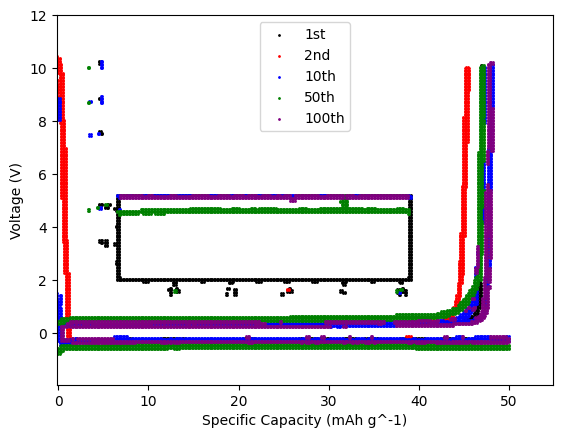

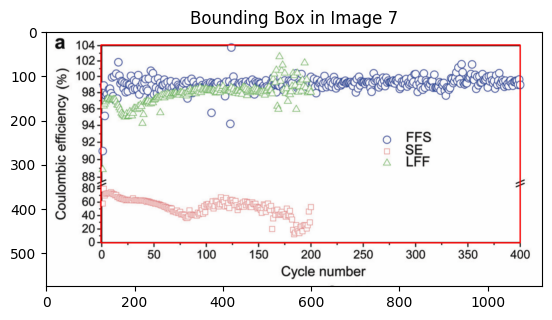

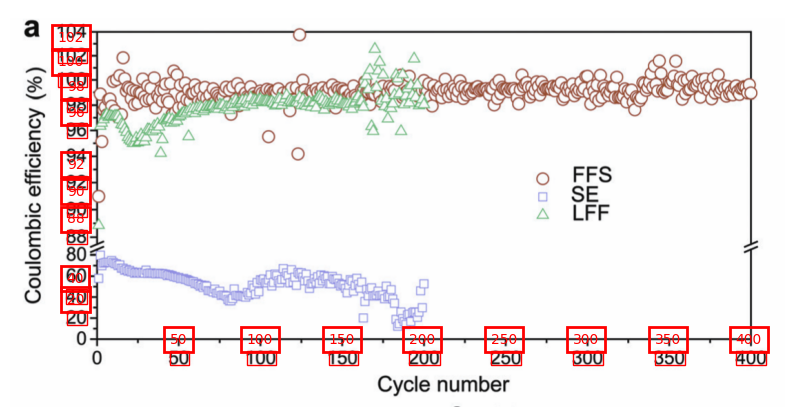

Y MIN 20
Y MAX 102
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 102.0
Y
OCR DIFF -379.5
SEM DIFF 82.0
OCR RATIO -4.628048780487805
PIXEL DIFF -32.0
REAL DIFF FROM BASE POINT 6.914361001317523
Y_MIN 13.085638998682477
Y_MAX 109.67061923583663
SEMANTIC X MIN 50.0
SEMANTIC X MAX 400.0
X
OCR DIFF 829.0
SEM DIFF 350.0
OCR RATIO 0.4221954161640531
PIXEL DIFF 121.0
REAL DIFF FROM BASE POINT 51.085645355850424
X_MIN -1.0856453558504242
X_MAX 400.0
X
Predicted [-1.0856453558504242, 400.0]
Chat GPT [0, 400]
Y
Predicted [13.085638998682477, 109.67061923583663]
Chat GPT [0, 104]


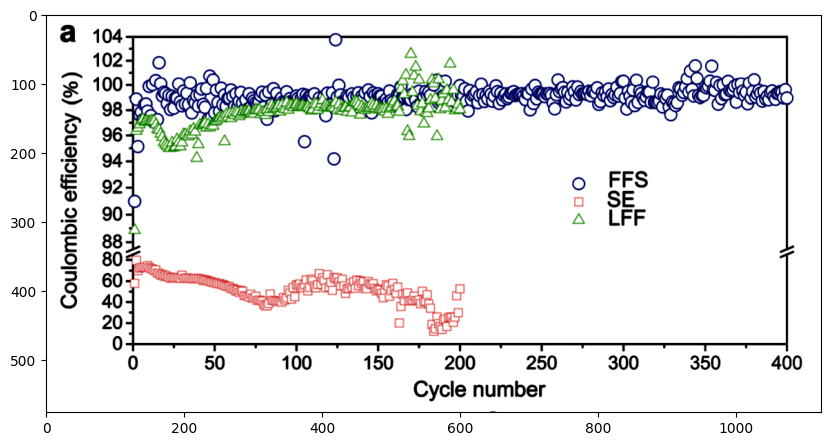

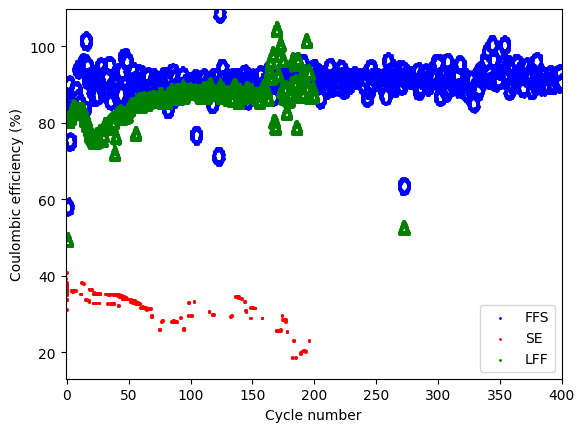

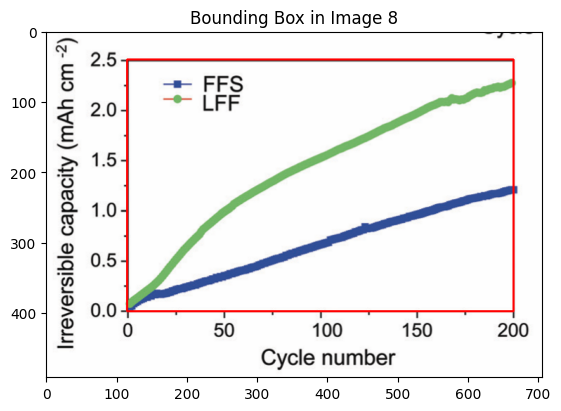

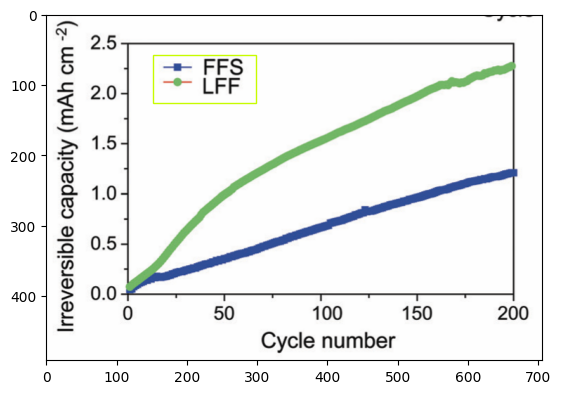

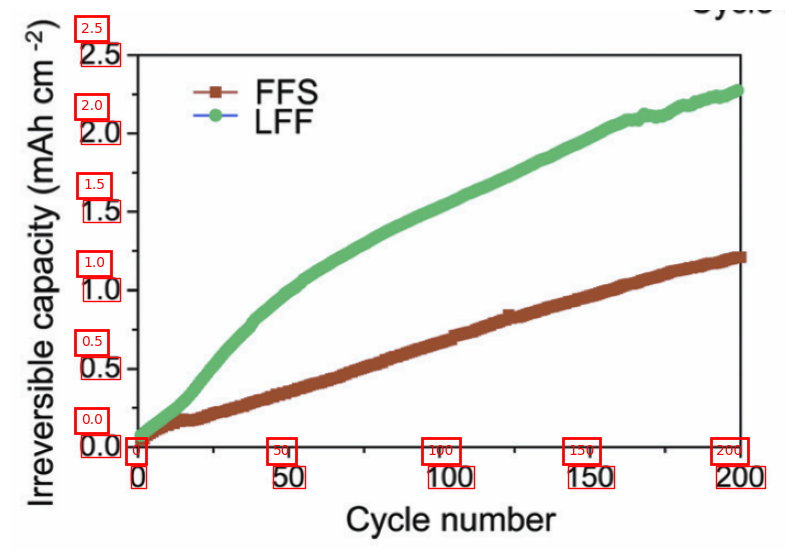

Y MIN 0.0
Y MAX 2.5
SEMANTIC Y MIN 0.0
SEMANTIC Y MAX 2.5
Y
OCR DIFF -356.5
SEM DIFF 2.5
OCR RATIO -142.6
PIXEL DIFF -1.0
REAL DIFF FROM BASE POINT 0.007012622720897616
Y_MIN -0.007012622720897616
Y_MAX 2.503506311360449
SEMANTIC X MIN 0.0
SEMANTIC X MAX 200.0
X
OCR DIFF 548.5
SEM DIFF 200.0
OCR RATIO 0.3646308113035551
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT 0.5469462169553327
X_MIN -0.5469462169553327
X_MAX 200.0
X
Predicted [-0.5469462169553327, 200.0]
Chat GPT [0, 200]
Y
Predicted [-0.007012622720897616, 2.503506311360449]
Chat GPT [0, 2.5]


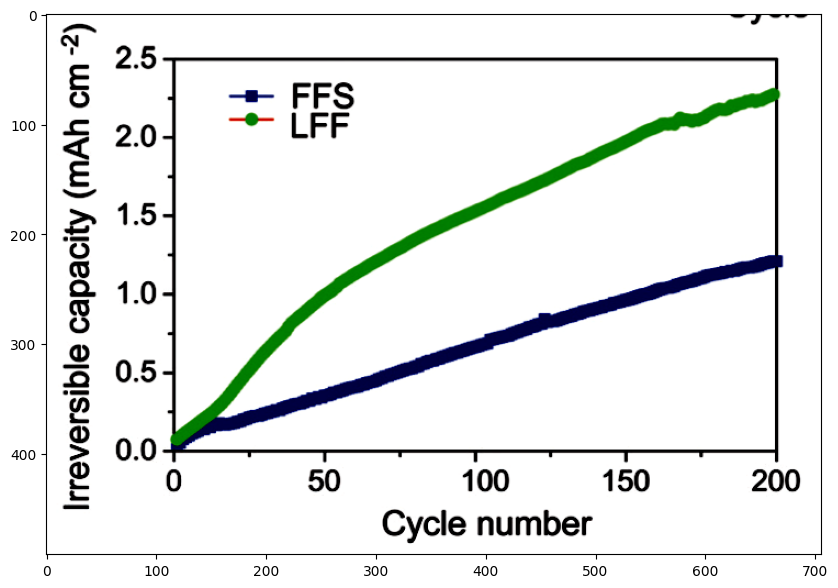

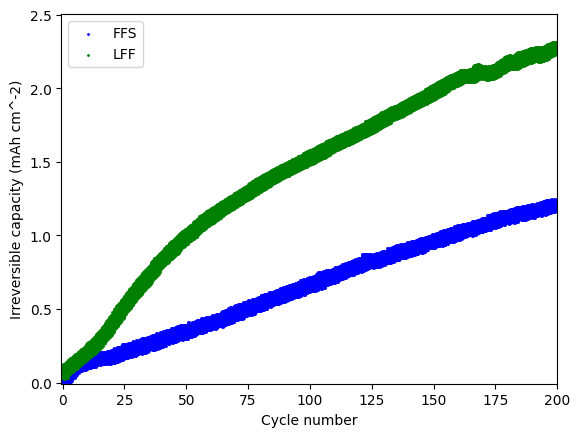

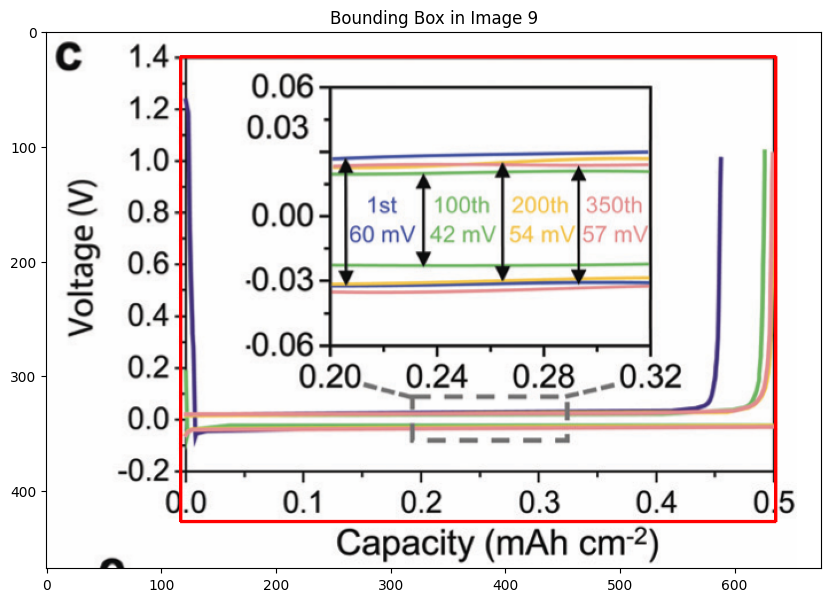

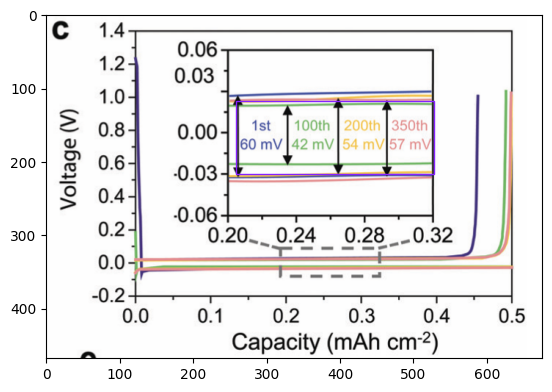

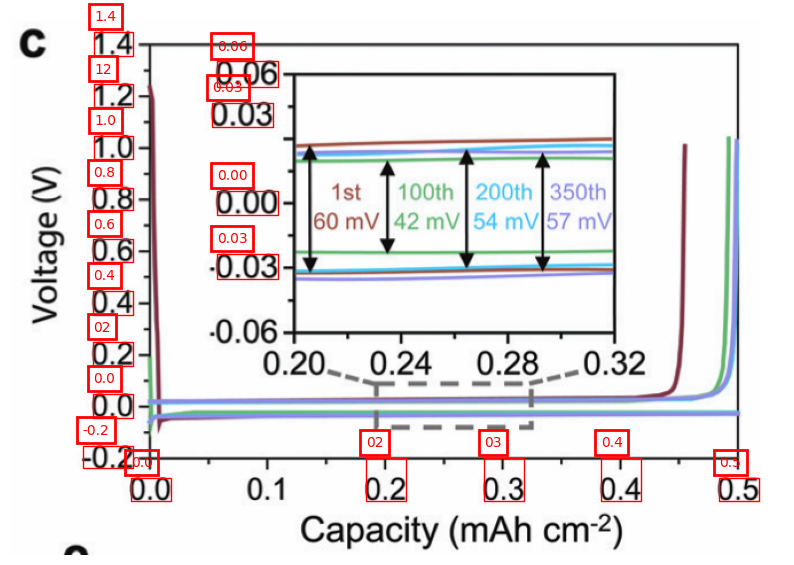

Y MIN -0.2
Y MAX 1.4
SEMANTIC Y MIN -0.2
SEMANTIC Y MAX 1.4
Y
OCR DIFF -360.5
SEM DIFF 1.5999999999999999
OCR RATIO -225.31250000000003
PIXEL DIFF -45.0
REAL DIFF FROM BASE POINT 0.19972260748959775
Y_MIN -0.39972260748959776
Y_MAX 1.3977808599167822
x is in fault condition
X
Predicted [0, 0.5]
Chat GPT [0, 0.5]
Y
Predicted [-0.39972260748959776, 1.3977808599167822]
Chat GPT [-0.2, 1.4]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


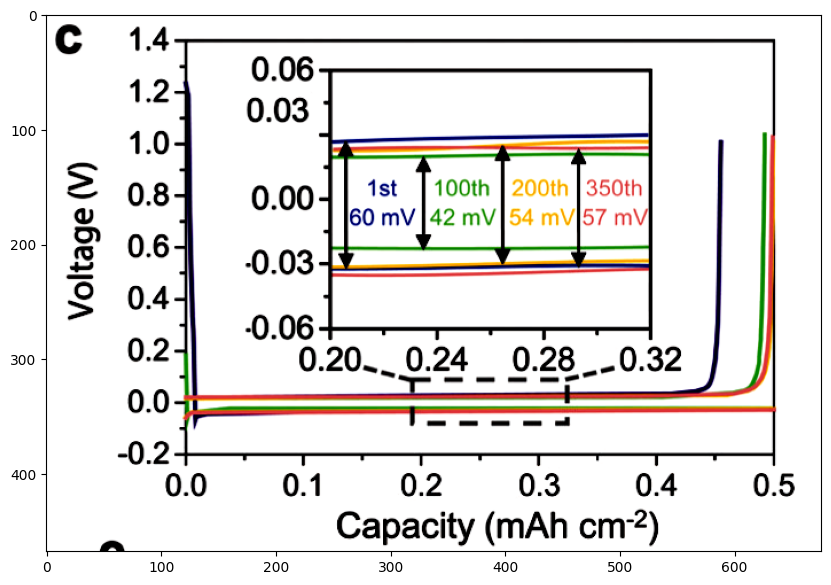

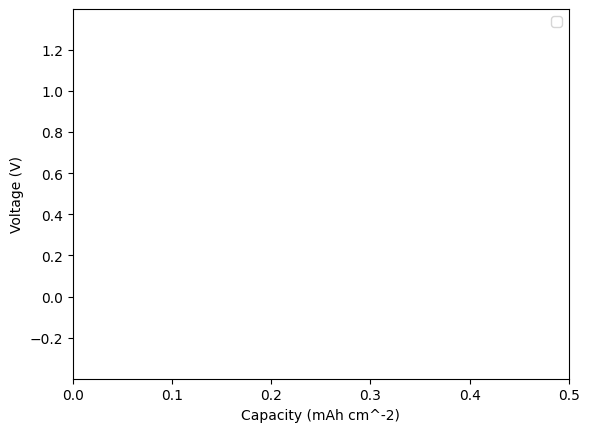

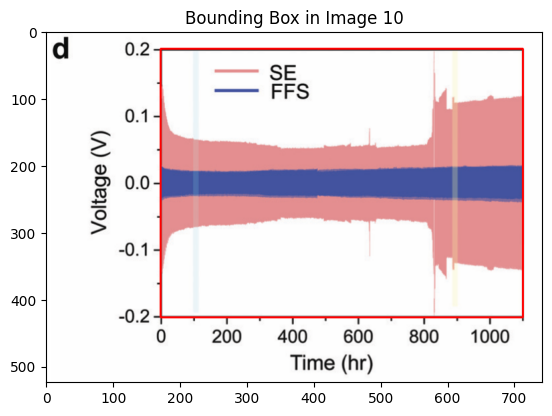

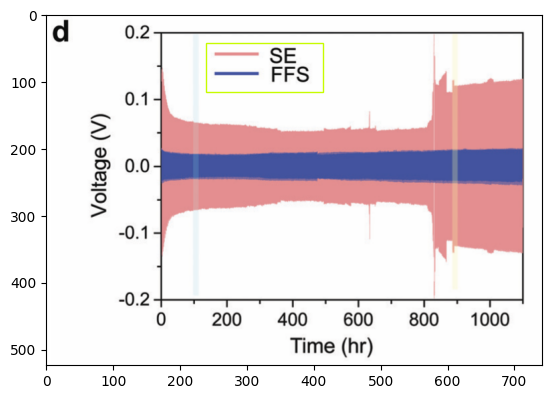

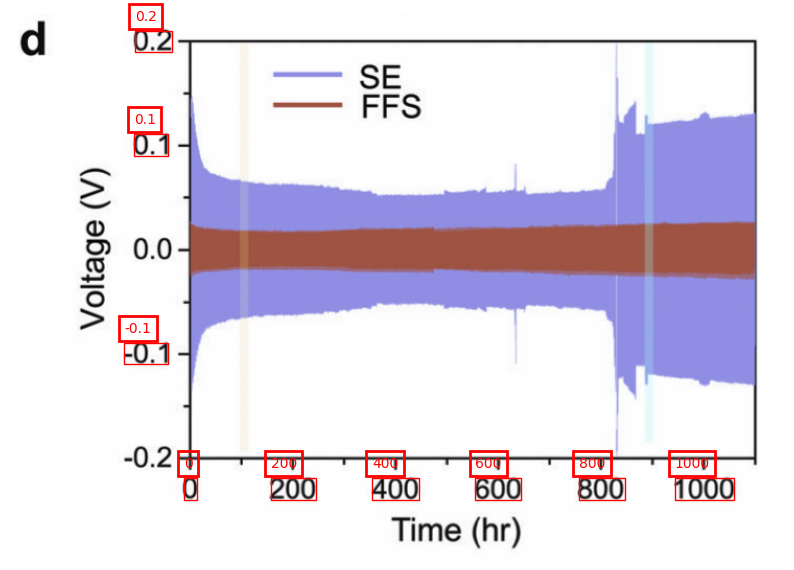

Y MIN -0.1
Y MAX 0.2
SEMANTIC Y MIN -0.1
SEMANTIC Y MAX 0.2
Y
OCR DIFF -299.0
SEM DIFF 0.30000000000000004
OCR RATIO -996.6666666666665
PIXEL DIFF -101.0
REAL DIFF FROM BASE POINT 0.10133779264214049
Y_MIN -0.2013377926421405
Y_MAX 0.20100334448160537
SEMANTIC X MIN 0.0
SEMANTIC X MAX 1000.0
X
OCR DIFF 492.0
SEM DIFF 1000.0
OCR RATIO 2.032520325203252
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT 3.048780487804878
X_MIN -3.048780487804878
X_MAX 1098.5772357723579
X
Predicted [-3.048780487804878, 1098.5772357723579]
Chat GPT [0, 1000]
Y
Predicted [-0.2013377926421405, 0.20100334448160537]
Chat GPT [-0.2, 0.2]


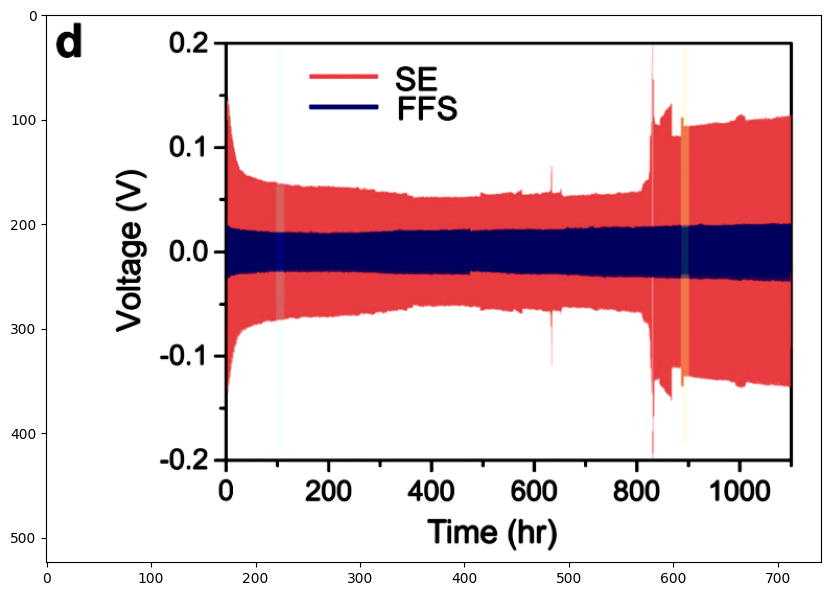

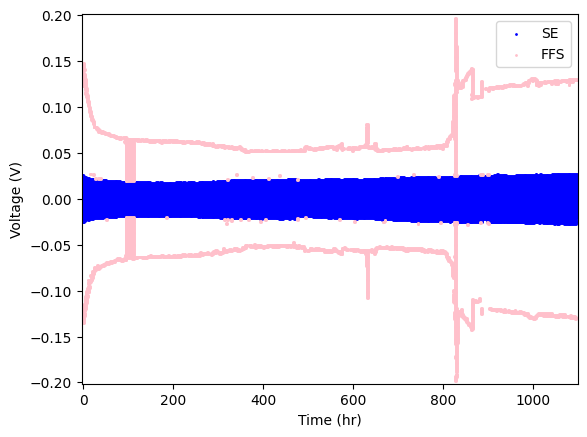

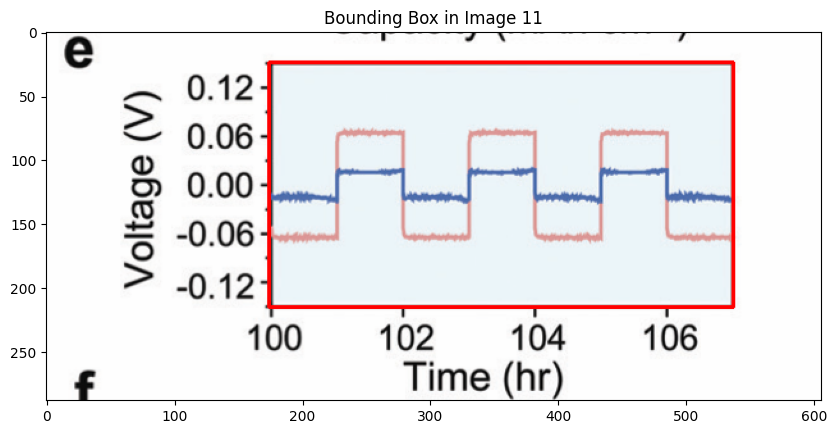

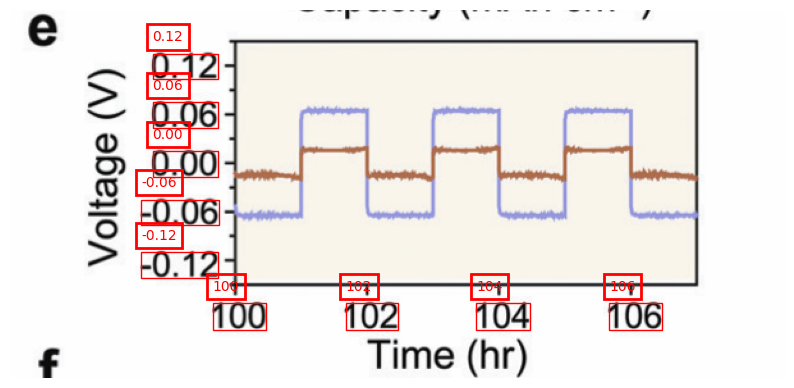

Y MIN -0.12
Y MAX 0.12
SEMANTIC Y MIN -0.12
SEMANTIC Y MAX 0.12
Y
OCR DIFF -155.0
SEM DIFF 0.24
OCR RATIO -645.8333333333334
PIXEL DIFF -16.0
REAL DIFF FROM BASE POINT 0.024774193548387096
Y_MIN -0.14477419354838708
Y_MAX 0.15096774193548387
SEMANTIC X MIN 100.0
SEMANTIC X MAX 106.0
X
OCR DIFF 309.5
SEM DIFF 6.0
OCR RATIO 0.01938610662358643
PIXEL DIFF 5.0
REAL DIFF FROM BASE POINT 0.09693053311793215
X_MIN 99.90306946688207
X_MAX 106.94022617124395
X
Predicted [99.90306946688207, 106.94022617124395]
Chat GPT [100, 106]
Y
Predicted [-0.14477419354838708, 0.15096774193548387]
Chat GPT [-0.12, 0.12]


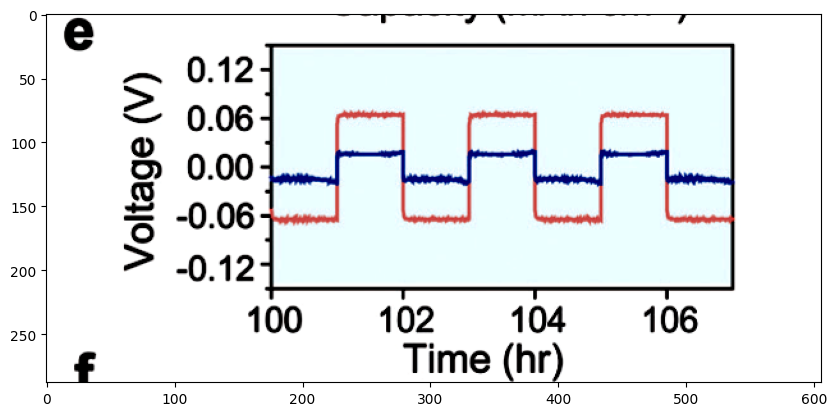

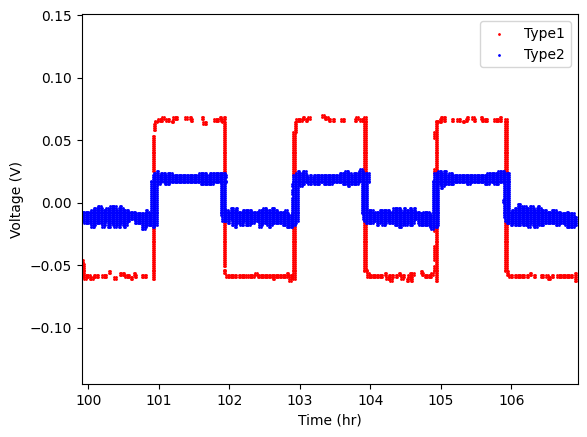

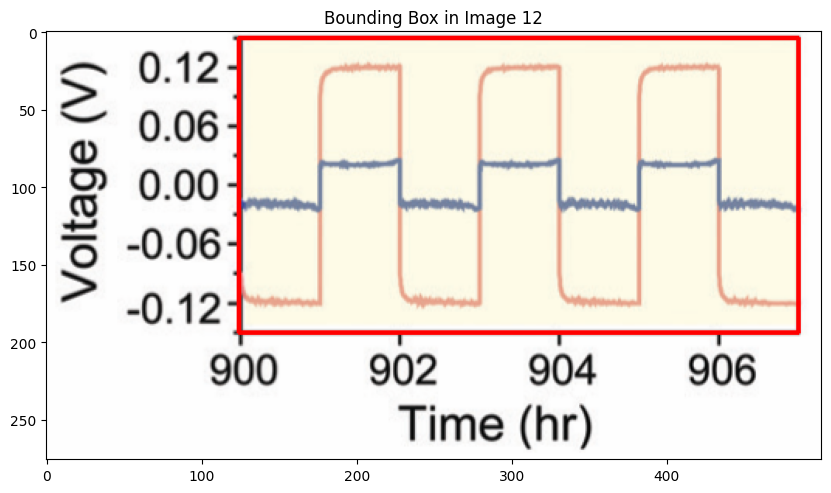

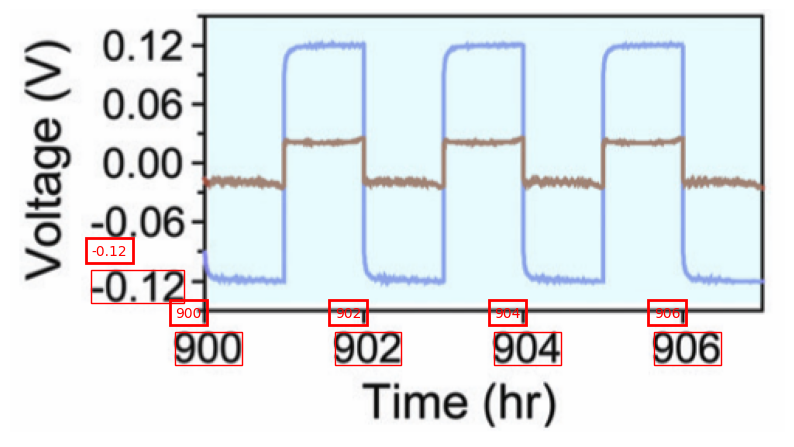

Y MIN -0.12
Y MAX -0.12
SEMANTIC Y MIN -0.12
SEMANTIC Y MAX -0.12
Y
OCR DIFF 0.0
SEM DIFF 0.0
SEMANTIC X MIN 900.0
SEMANTIC X MAX 906.0
X
OCR DIFF 309.0
SEM DIFF 6.0
OCR RATIO 0.019417475728155338
PIXEL DIFF 3.5
REAL DIFF FROM BASE POINT 0.06796116504854369
X_MIN 899.9320388349514
X_MAX 906.9417475728155
y is in fault condition
X
Predicted [899.9320388349514, 906.9417475728155]
Chat GPT [900, 906]
Y
Predicted [-0.12, 0.12]
Chat GPT [-0.12, 0.12]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


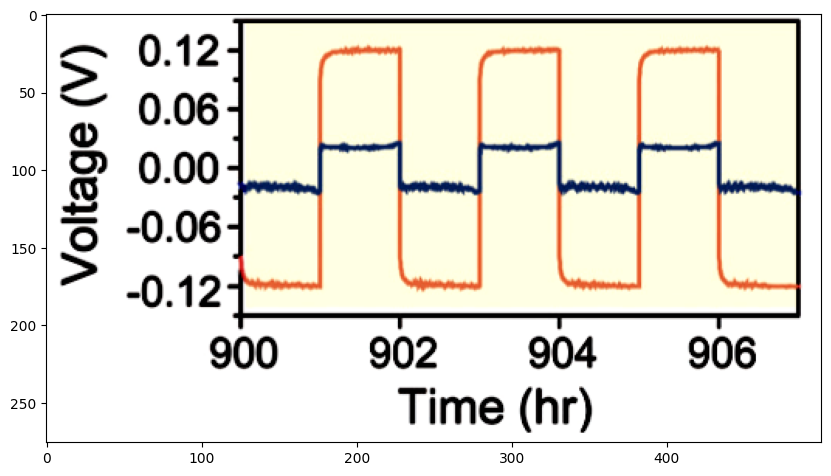

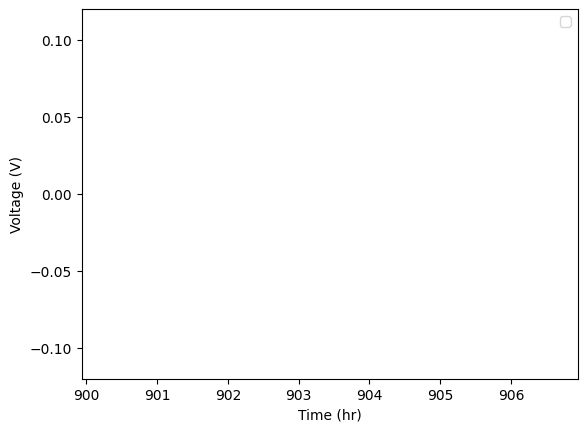

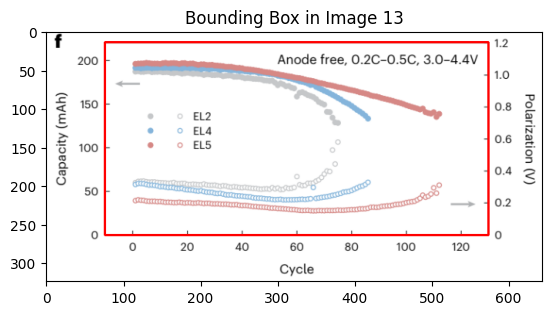

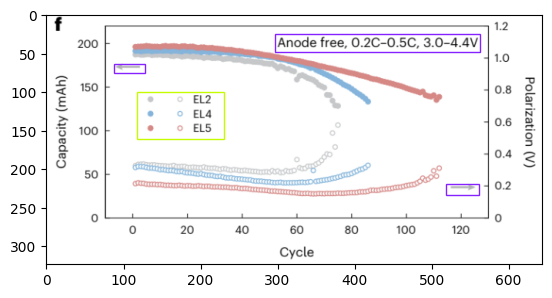

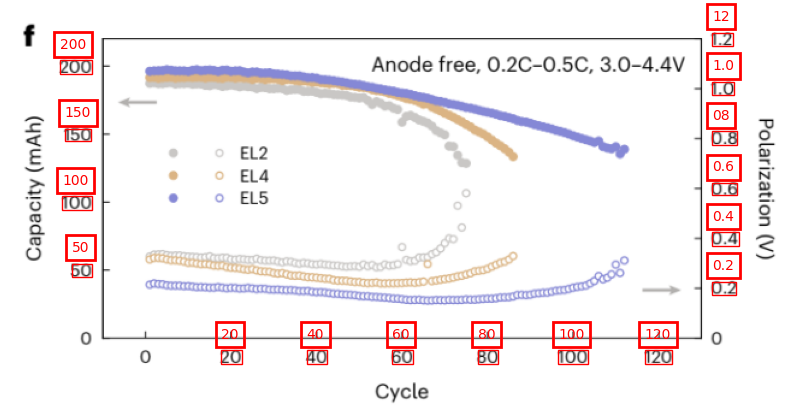

Y MIN 50
Y MAX 200
SEMANTIC Y MIN 50.0
SEMANTIC Y MAX 200.0
Y
OCR DIFF -169.0
SEM DIFF 150.0
OCR RATIO -1.1266666666666667
PIXEL DIFF -56.5
REAL DIFF FROM BASE POINT 50.14792899408284
Y_MIN -0.14792899408283944
Y_MAX 221.74556213017752
SEMANTIC X MIN 20.0
SEMANTIC X MAX 120.0
X
OCR DIFF 355.0
SEM DIFF 100.0
OCR RATIO 0.28169014084507044
PIXEL DIFF 107.5
REAL DIFF FROM BASE POINT 30.281690140845072
X_MIN -10.281690140845072
X_MAX 130.0
X
Predicted [-10.281690140845072, 130.0]
Chat GPT [0, 120]
Y
Predicted [-0.14792899408283944, 221.74556213017752]
Chat GPT [0, 200]


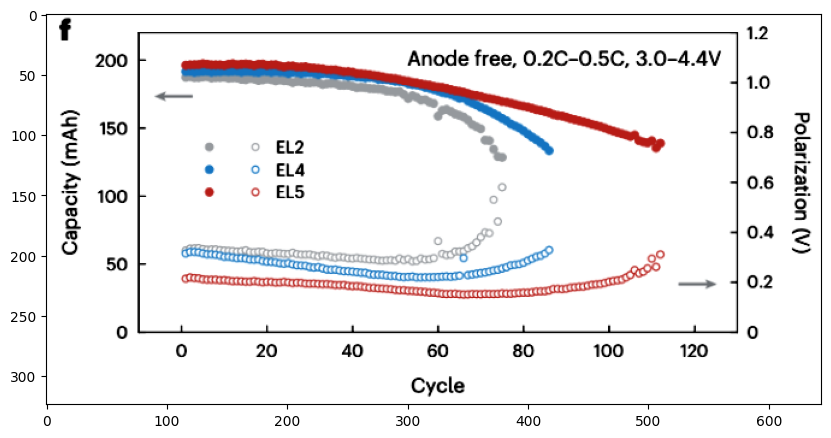

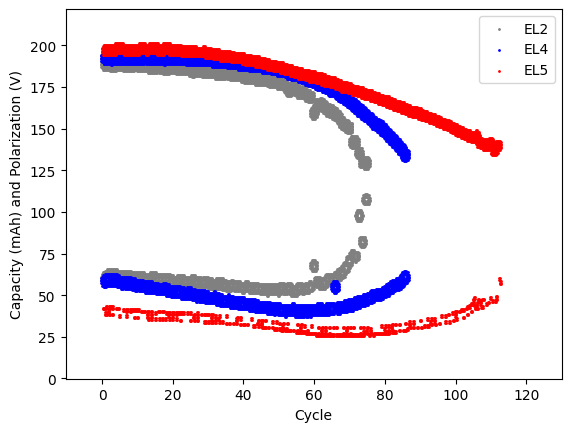

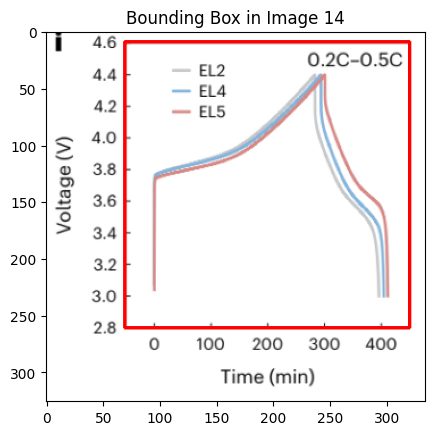

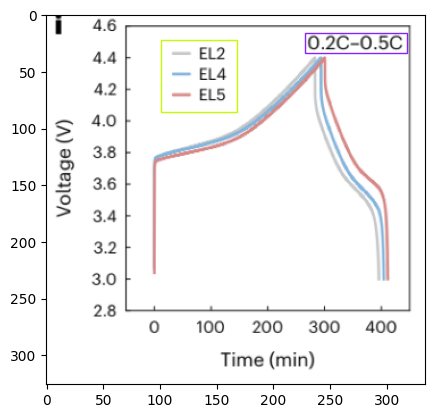

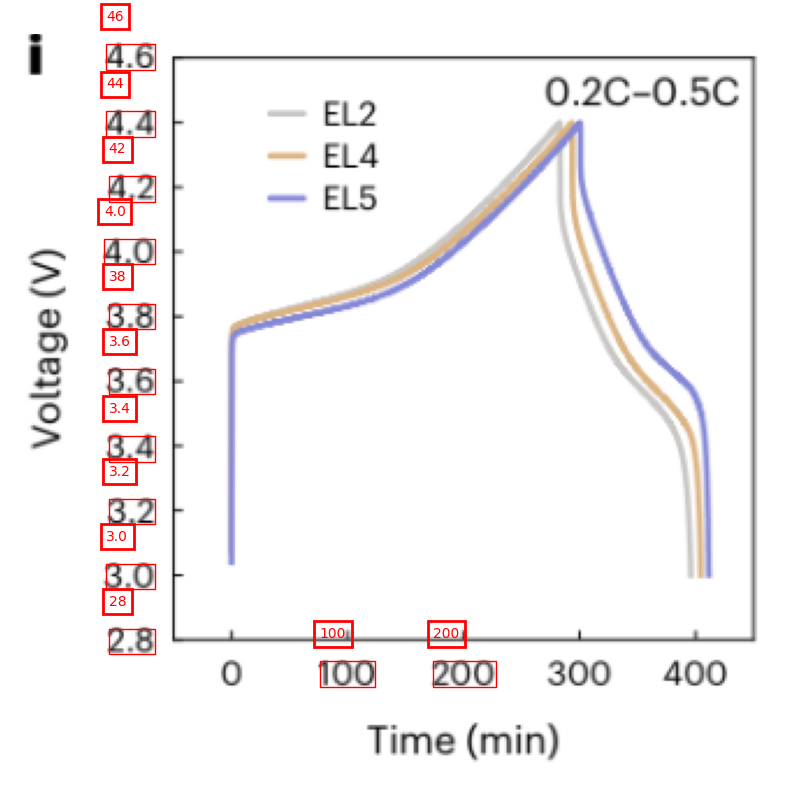

Y MIN 28
Y MAX 46
SEMANTIC Y MIN 28.0
SEMANTIC Y MAX 46.0
Y
OCR DIFF -252.0
SEM DIFF 18.0
OCR RATIO -14.0
PIXEL DIFF 0.5
REAL DIFF FROM BASE POINT -0.03571428571428571
Y_MIN 28.035714285714285
Y_MAX 46.035714285714285
SEMANTIC X MIN 28.0
SEMANTIC X MAX 200.0
X
OCR DIFF 143.5
SEM DIFF 172.0
OCR RATIO 1.1986062717770034
PIXEL DIFF -17.0
REAL DIFF FROM BASE POINT -20.376306620209057
X_MIN 48.37630662020906
X_MAX 349.22648083623693
X
Predicted [48.37630662020906, 349.22648083623693]
Chat GPT [0, 400]
Y
Predicted [28.035714285714285, 46.035714285714285]
Chat GPT [2.8, 4.6]


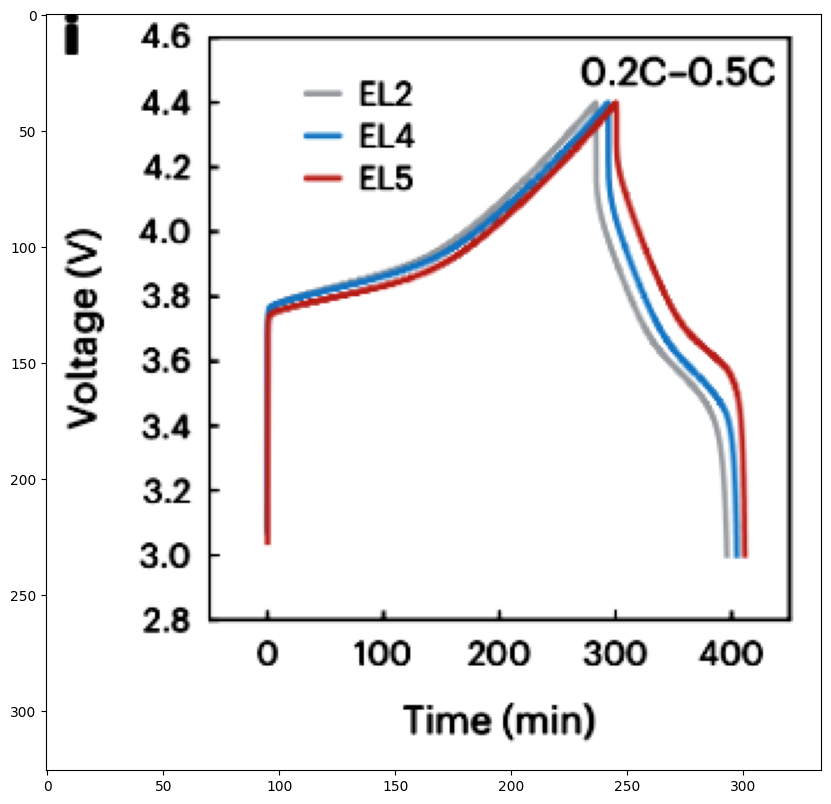

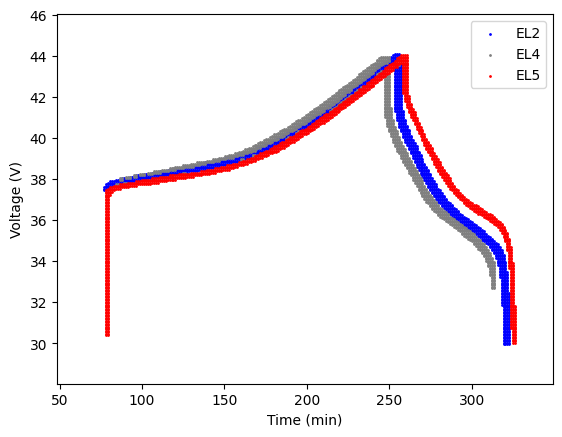

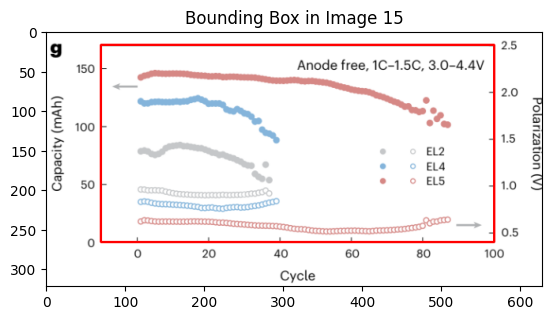

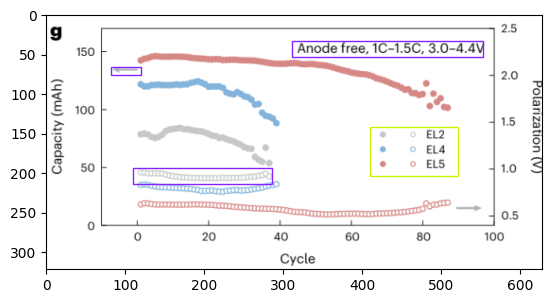

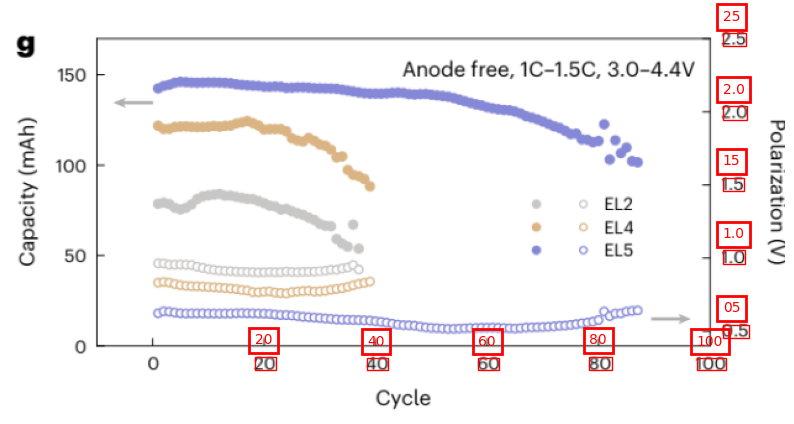

SEMANTIC X MIN 20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 361.5
SEM DIFF 80.0
OCR RATIO 0.22130013831258644
PIXEL DIFF 137.5
REAL DIFF FROM BASE POINT 30.428769017980635
X_MIN -10.428769017980635
X_MAX 99.77869986168741
y is in fault condition
X
Predicted [-10.428769017980635, 99.77869986168741]
Chat GPT [0, 100]
Y
Predicted [0, 150]
Chat GPT [0, 150]


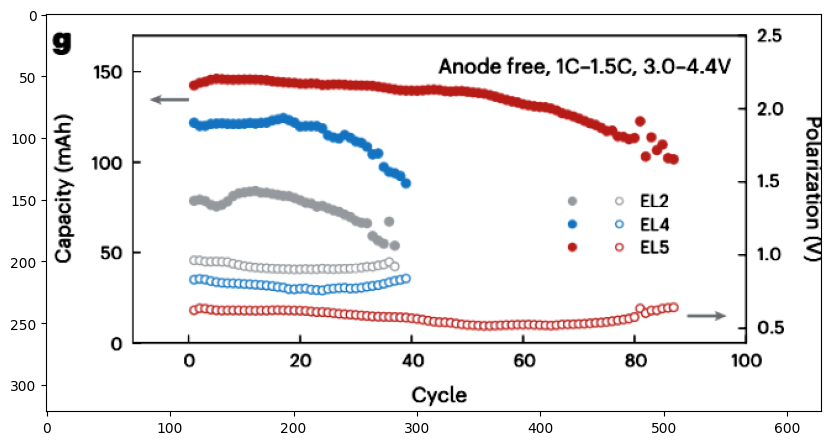

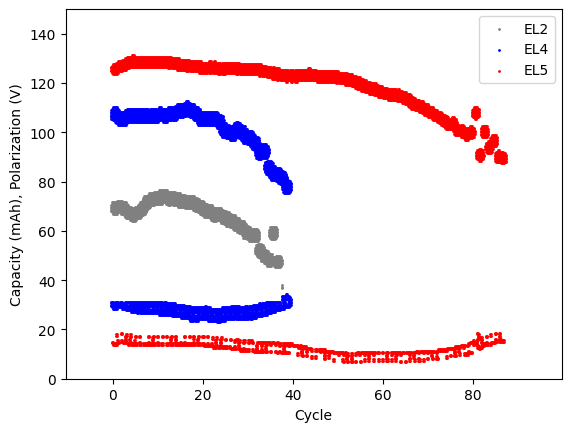

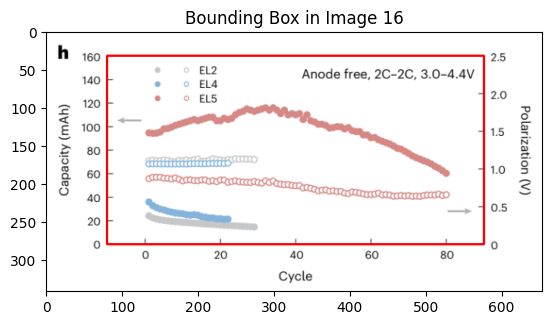

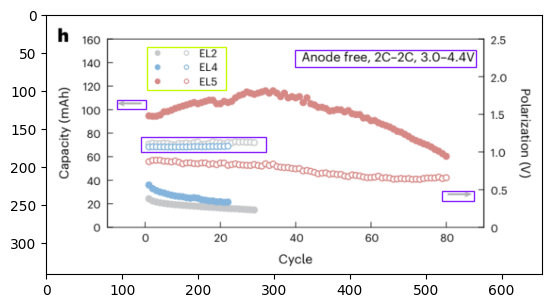

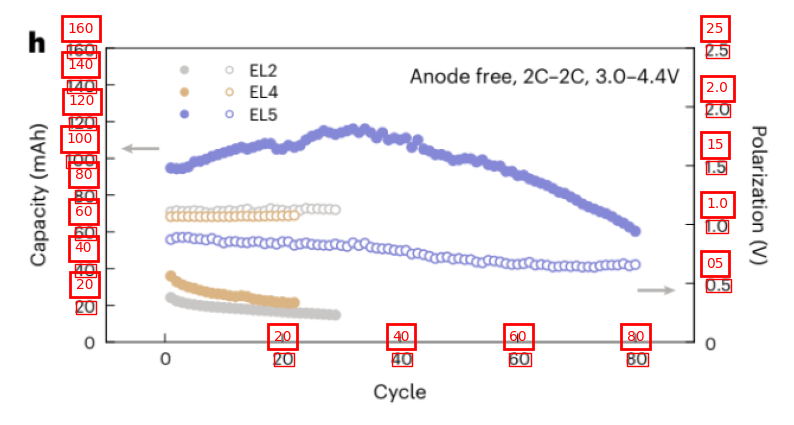

Y MIN 20
Y MAX 160
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -216.0
SEM DIFF 140.0
OCR RATIO -1.542857142857143
PIXEL DIFF -29.5
REAL DIFF FROM BASE POINT 19.12037037037037
Y_MIN 0.8796296296296298
Y_MAX 161.62037037037035
SEMANTIC X MIN 20.0
SEMANTIC X MAX 80.0
X
OCR DIFF 298.5
SEM DIFF 60.0
OCR RATIO 0.20100502512562815
PIXEL DIFF 150.5
REAL DIFF FROM BASE POINT 30.251256281407038
X_MIN -10.251256281407038
X_MAX 89.64824120603015
X
Predicted [-10.251256281407038, 89.64824120603015]
Chat GPT [0, 80]
Y
Predicted [0.8796296296296298, 161.62037037037035]
Chat GPT [0, 160]


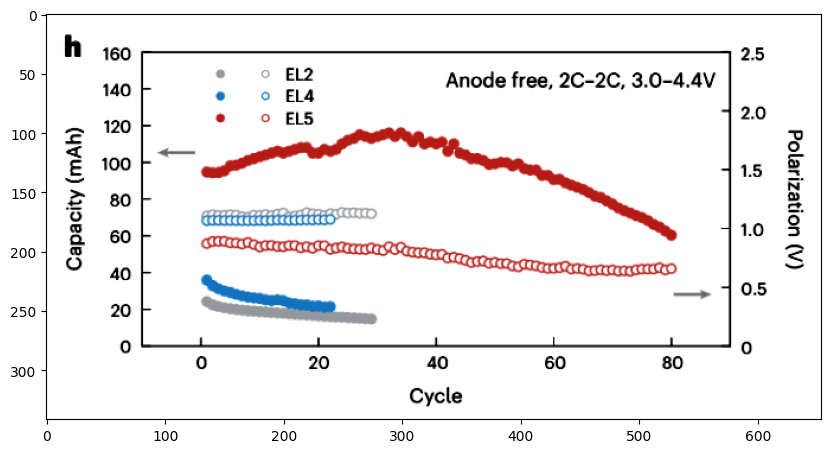

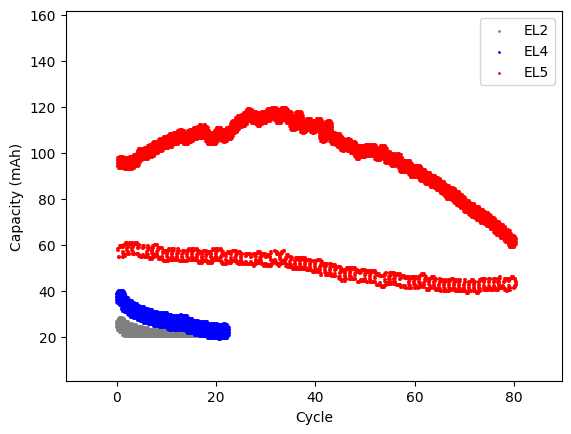

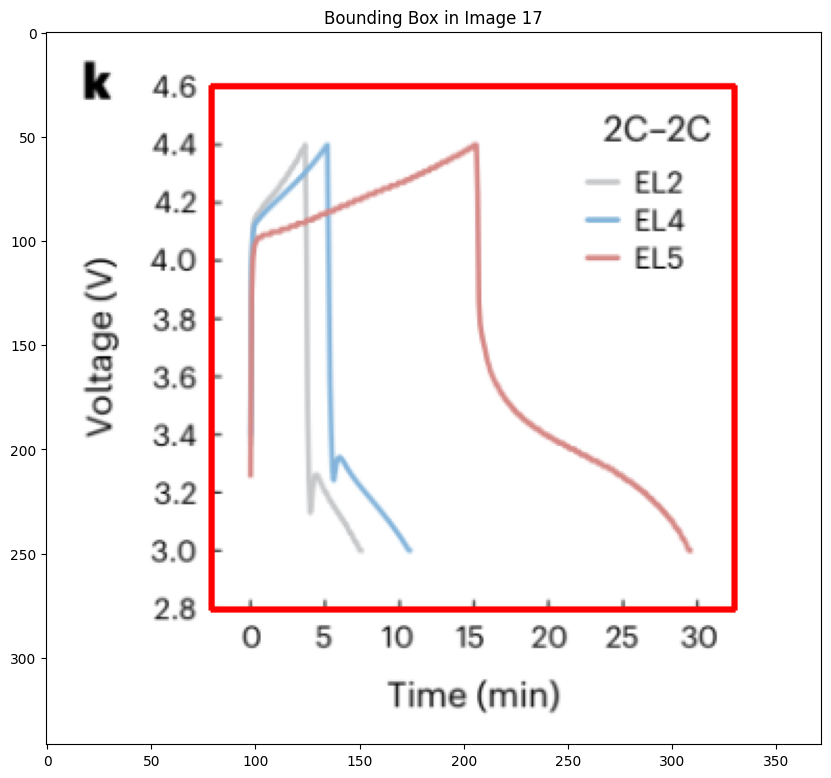

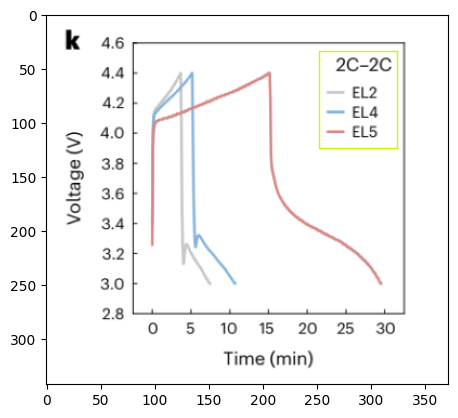

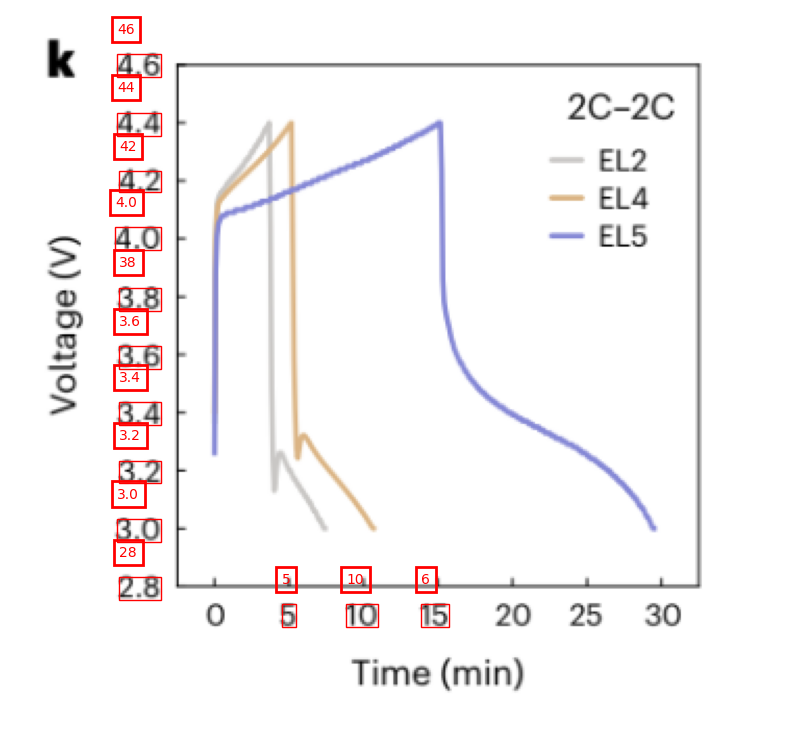

Y MIN 28
Y MAX 46
SEMANTIC Y MIN 28.0
SEMANTIC Y MAX 46.0
Y
OCR DIFF -251.0
SEM DIFF 18.0
OCR RATIO -13.944444444444445
PIXEL DIFF 0.5
REAL DIFF FROM BASE POINT -0.035856573705179286
Y_MIN 28.03585657370518
Y_MAX 46.035856573705175
SEMANTIC X MIN 28.0
SEMANTIC X MAX 6.0
X
OCR DIFF 141.5
SEM DIFF -22.0
OCR RATIO -0.15547703180212014
PIXEL DIFF -17.0
REAL DIFF FROM BASE POINT 2.6431095406360425
X_MIN 25.356890459363957
X_MAX -13.667844522968199
X
Predicted [25.356890459363957, -13.667844522968199]
Chat GPT [0, 30]
Y
Predicted [28.03585657370518, 46.035856573705175]
Chat GPT [2.8, 4.6]


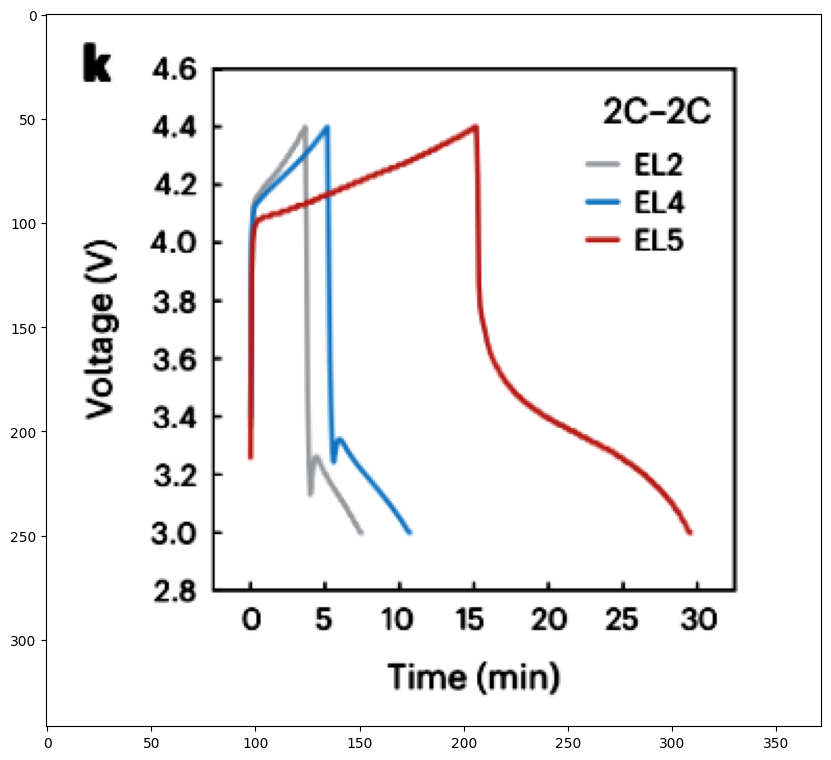

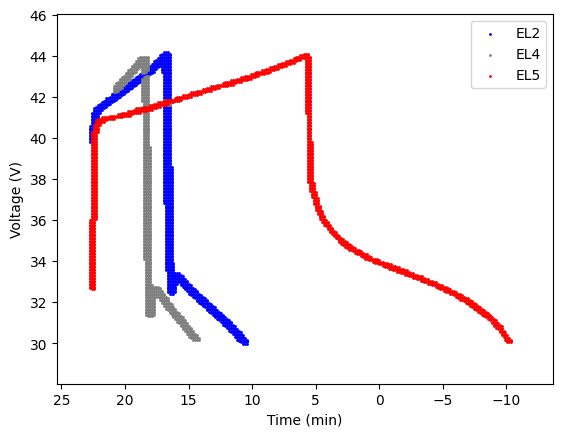

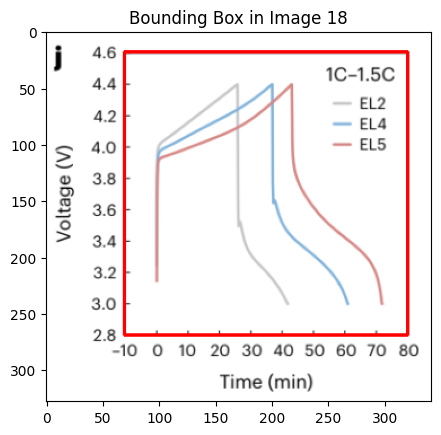

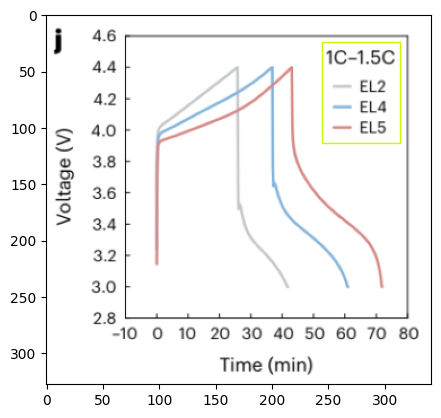

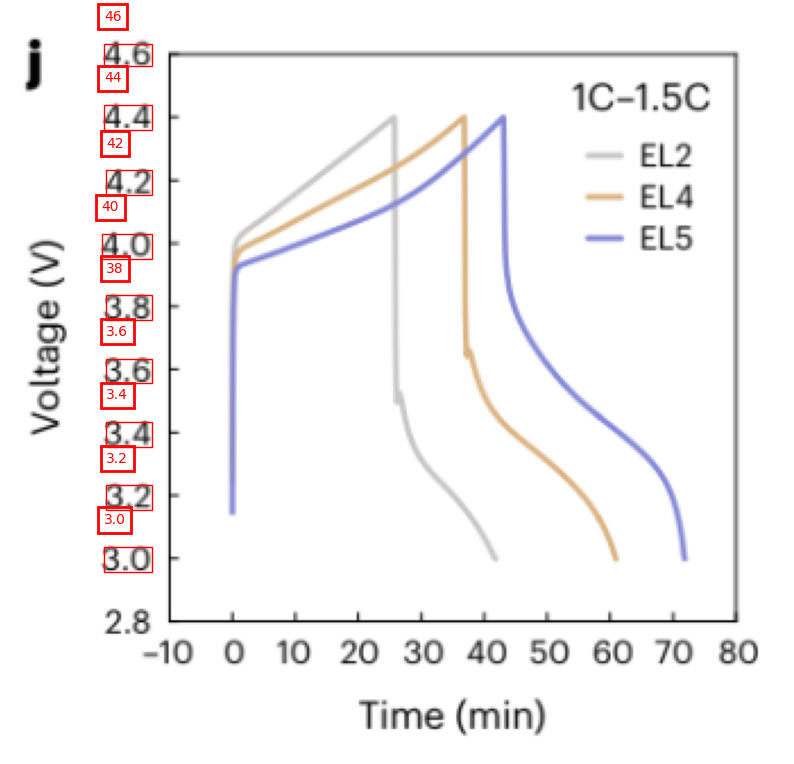

Y MIN 3.0
Y MAX 46
SEMANTIC Y MIN 3.0
SEMANTIC Y MAX 46.0
Y
OCR DIFF -222.5
SEM DIFF 43.0
OCR RATIO -5.174418604651163
PIXEL DIFF -27.5
REAL DIFF FROM BASE POINT 5.314606741573034
Y_MIN -2.3146067415730336
Y_MAX 46.193258426966295
x is in fault condition
X
Predicted [-10, 70]
Chat GPT [-10, 70]
Y
Predicted [-2.3146067415730336, 46.193258426966295]
Chat GPT [3.0, 4.6]


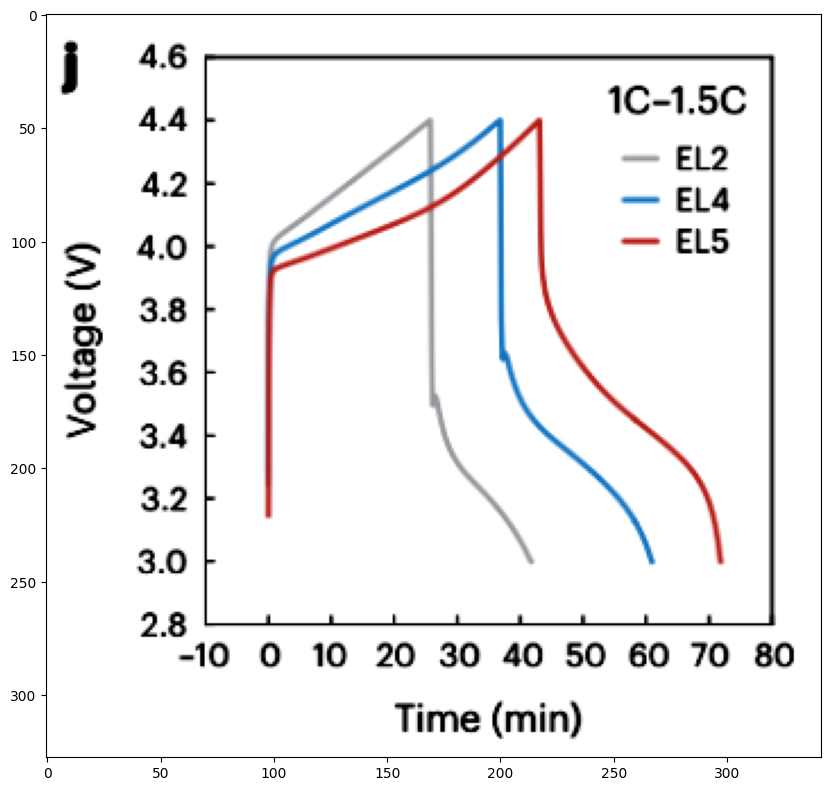

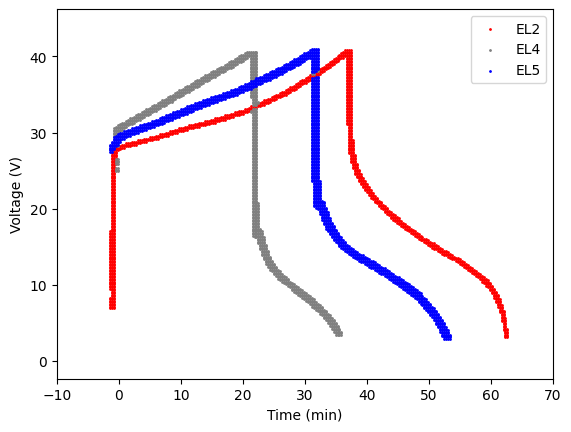

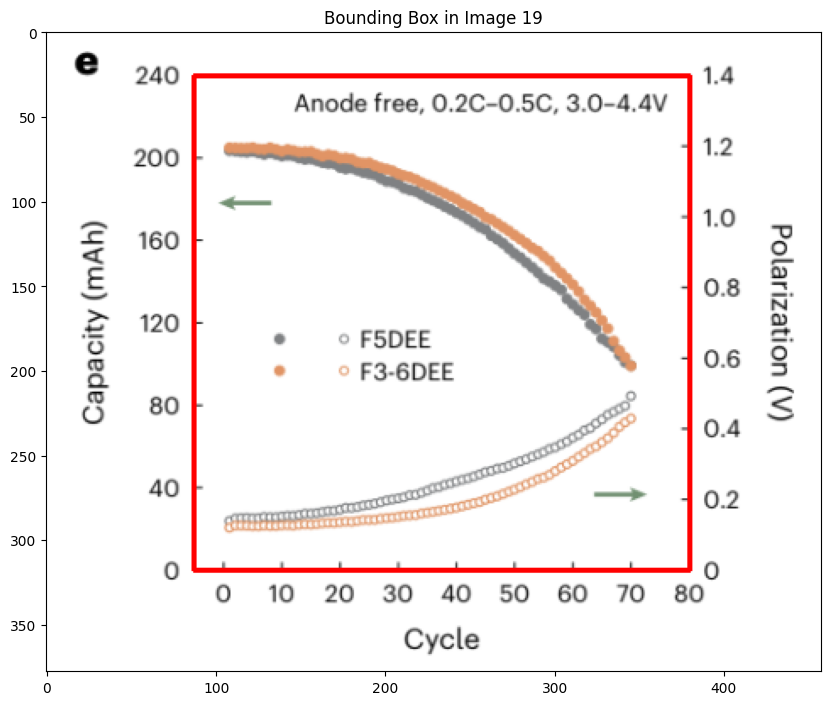

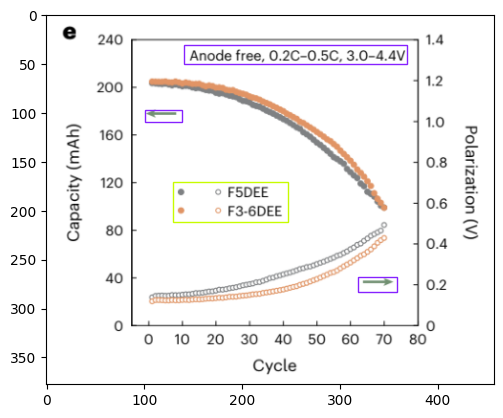

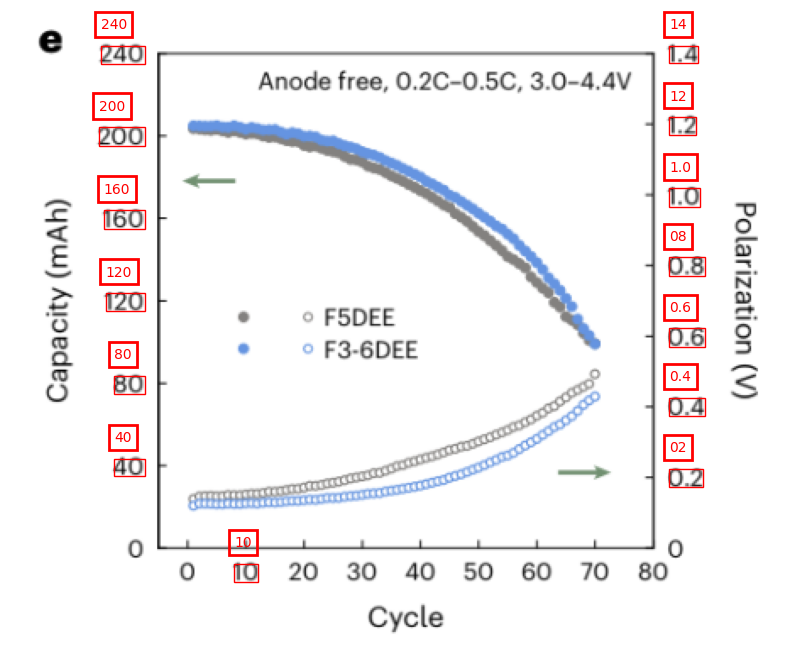

Y MIN 40
Y MAX 240
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 240.0
Y
OCR DIFF -243.5
SEM DIFF 200.0
OCR RATIO -1.2175
PIXEL DIFF -48.0
REAL DIFF FROM BASE POINT 39.42505133470226
Y_MIN 0.5749486652977396
Y_MAX 240.4106776180698
SEMANTIC X MIN 10.0
SEMANTIC X MAX 10.0
X
OCR DIFF 0.0
SEM DIFF 0.0
x is in fault condition
X
Predicted [0, 80]
Chat GPT [0, 80]
Y
Predicted [0.5749486652977396, 240.4106776180698]
Chat GPT [0, 240]


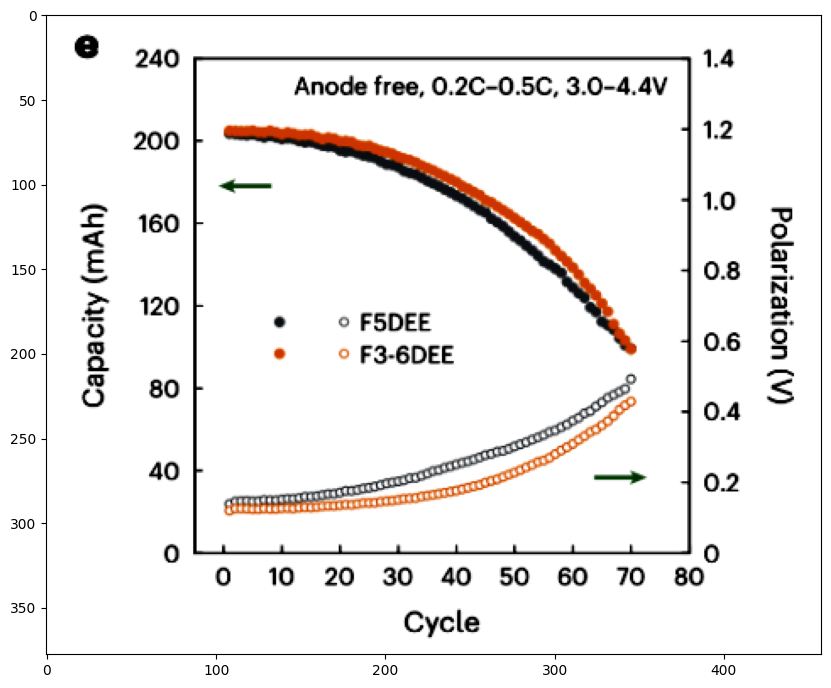

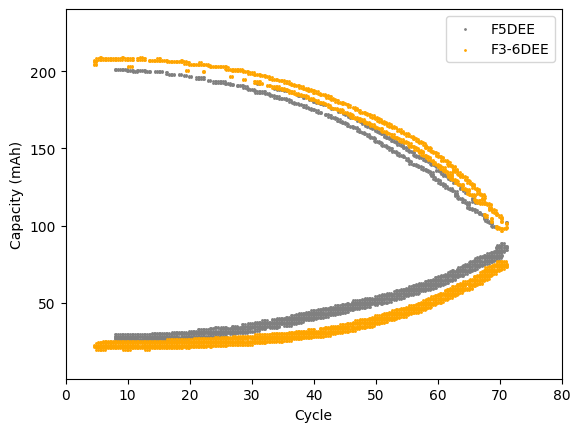

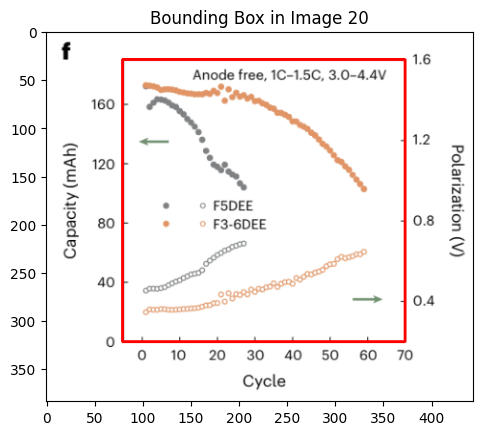

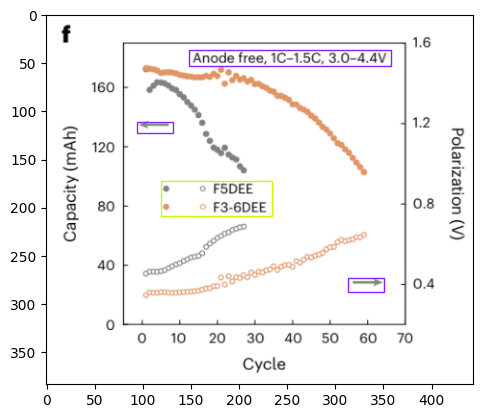

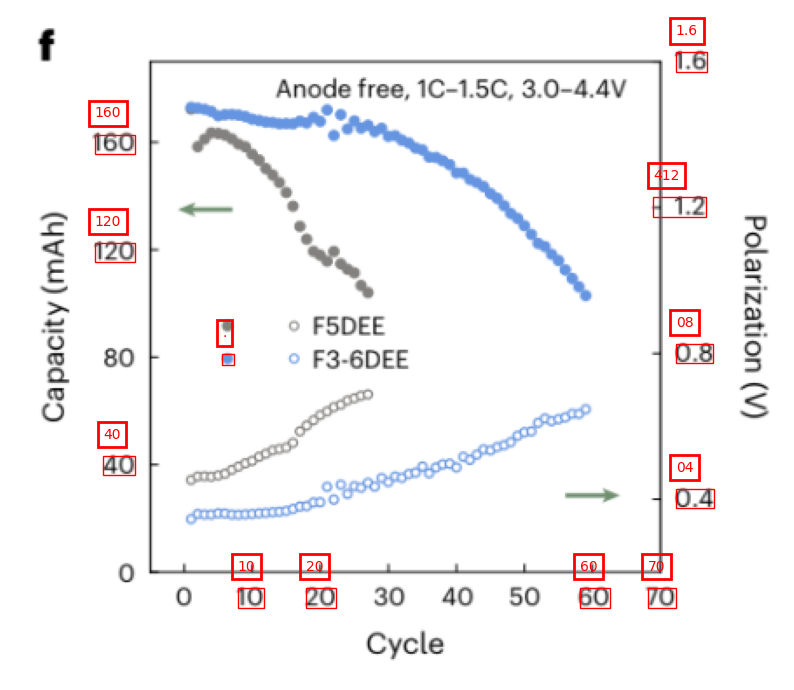

Y MIN 40
Y MAX 160
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -184.0
SEM DIFF 120.0
OCR RATIO -1.5333333333333334
PIXEL DIFF -61.5
REAL DIFF FROM BASE POINT 40.10869565217391
Y_MIN -0.10869565217390686
Y_MAX 190.97826086956522
SEMANTIC X MIN 10.0
SEMANTIC X MAX 70.0
X
OCR DIFF 235.5
SEM DIFF 60.0
OCR RATIO 0.25477707006369427
PIXEL DIFF 58.5
REAL DIFF FROM BASE POINT 14.904458598726114
X_MIN -4.904458598726114
X_MAX 69.74522292993632
X
Predicted [-4.904458598726114, 69.74522292993632]
Chat GPT [0, 70]
Y
Predicted [-0.10869565217390686, 190.97826086956522]
Chat GPT [0, 160]


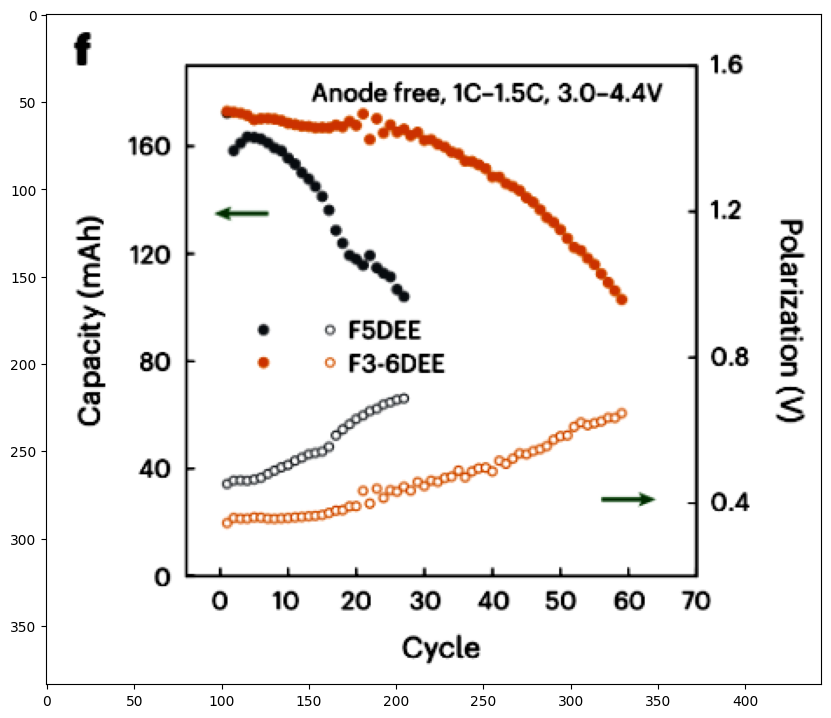

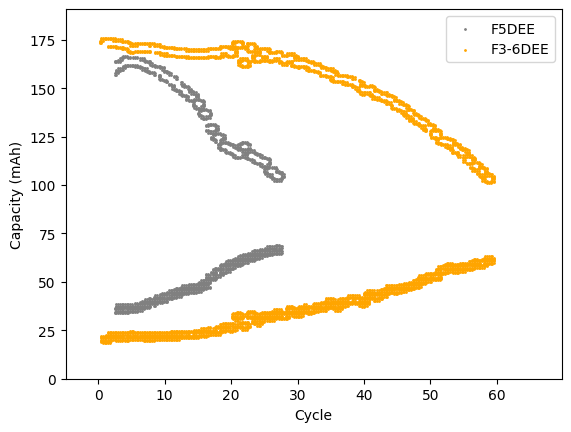

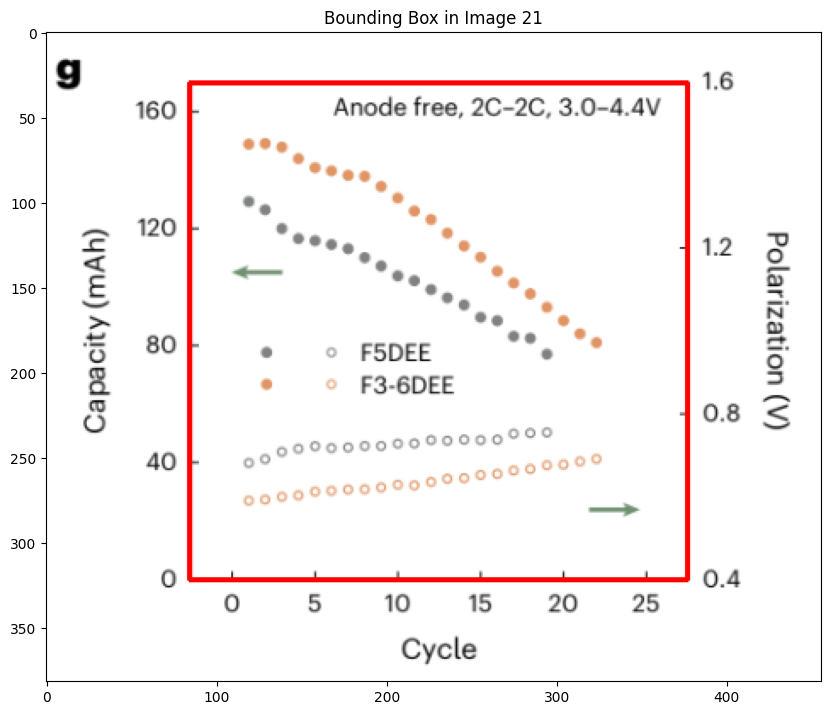

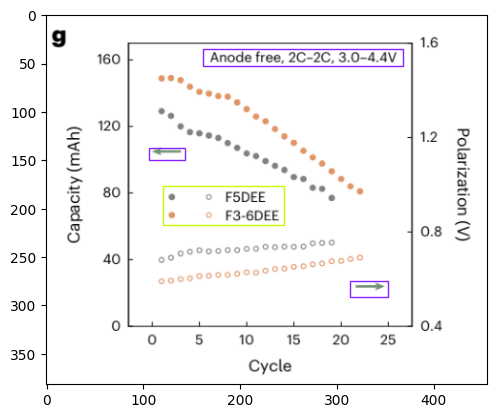

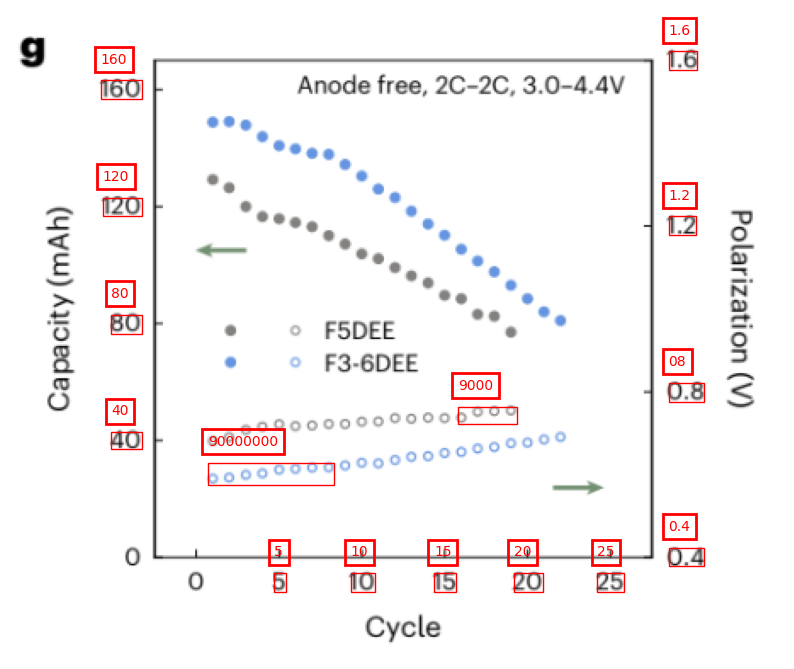

Y MIN 40
Y MAX 160
SEMANTIC Y MIN 40.0
SEMANTIC Y MAX 160.0
Y
OCR DIFF -206.5
SEM DIFF 120.0
OCR RATIO -1.7208333333333334
PIXEL DIFF -69.0
REAL DIFF FROM BASE POINT 40.096852300242126
Y_MIN -0.09685230024212643
Y_MAX 169.58837772397095
SEMANTIC X MIN 5.0
SEMANTIC X MAX 25.0
X
OCR DIFF 194.5
SEM DIFF 20.0
OCR RATIO 0.10282776349614396
PIXEL DIFF 74.5
REAL DIFF FROM BASE POINT 7.660668380462726
X_MIN -2.6606683804627256
X_MAX 27.467866323907458
X
Predicted [-2.6606683804627256, 27.467866323907458]
Chat GPT [0, 25]
Y
Predicted [-0.09685230024212643, 169.58837772397095]
Chat GPT [40, 160]


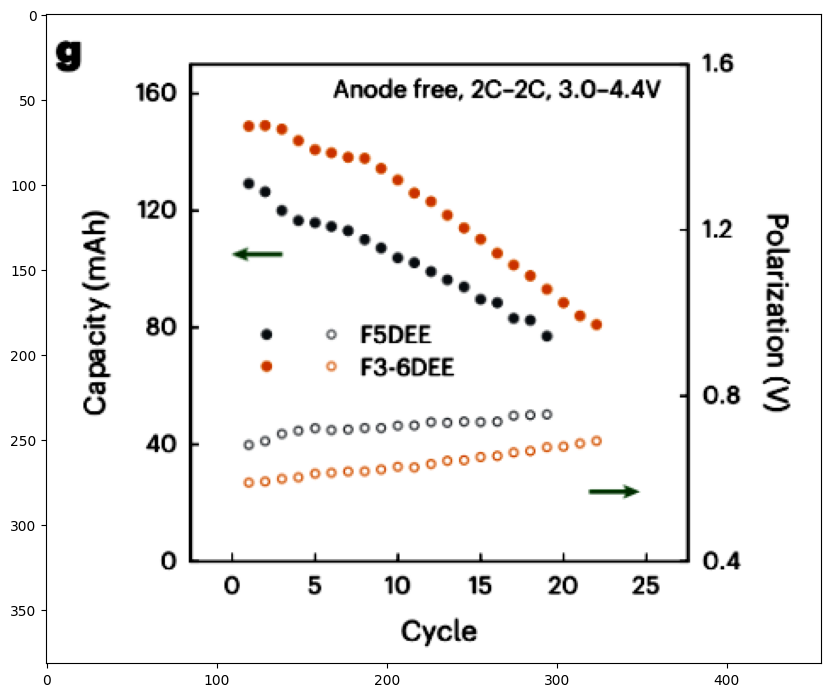

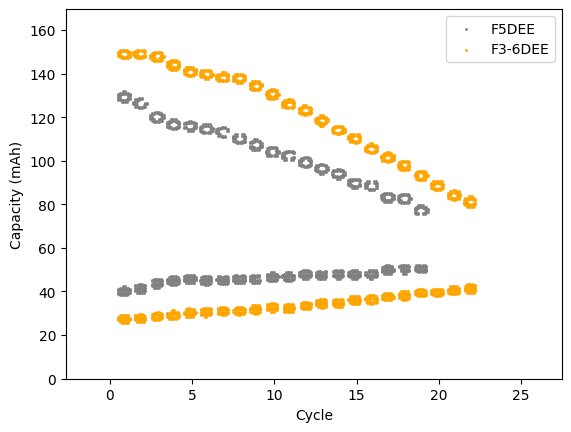

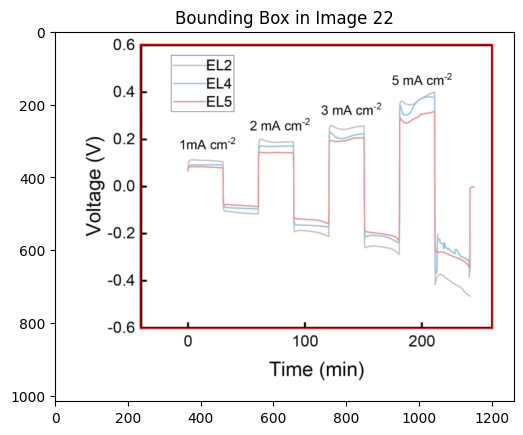

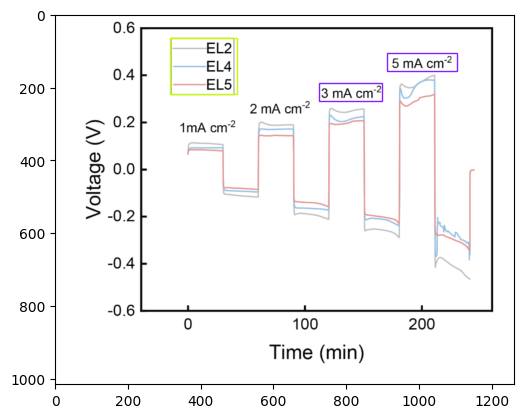

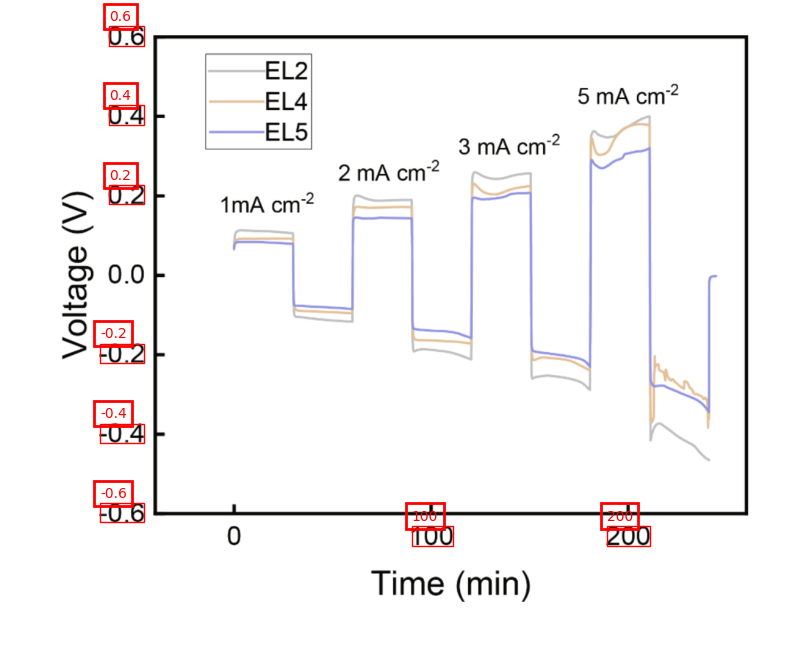

Y MIN -0.6
Y MAX 0.6
SEMANTIC Y MIN -0.6
SEMANTIC Y MAX 0.6
Y
OCR DIFF -776.5
SEM DIFF 1.2
OCR RATIO -647.0833333333334
PIXEL DIFF -2.5
REAL DIFF FROM BASE POINT 0.00386349001931745
Y_MIN -0.6038634900193174
Y_MAX 0.601545396007727
SEMANTIC X MIN 100.0
SEMANTIC X MAX 200.0
X
OCR DIFF 319.0
SEM DIFF 100.0
OCR RATIO 0.31347962382445144
PIXEL DIFF 454.5
REAL DIFF FROM BASE POINT 142.47648902821317
X_MIN -42.476489028213166
X_MAX 260.65830721003135
X
Predicted [-42.476489028213166, 260.65830721003135]
Chat GPT [0, 250]
Y
Predicted [-0.6038634900193174, 0.601545396007727]
Chat GPT [-0.6, 0.6]


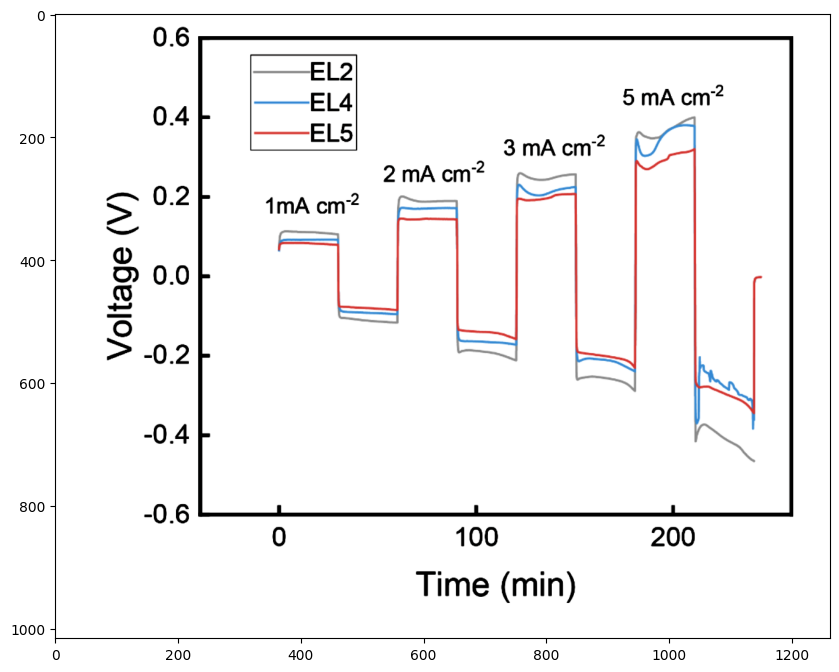

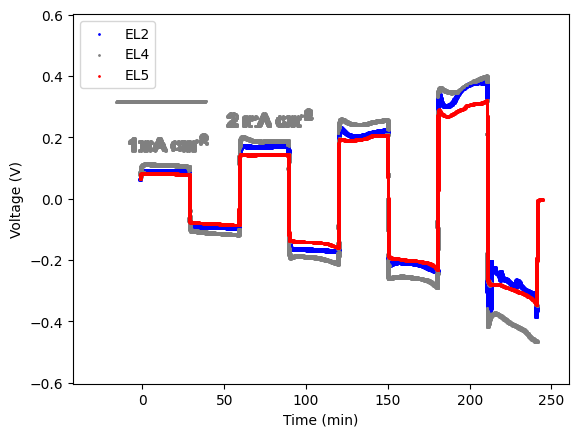

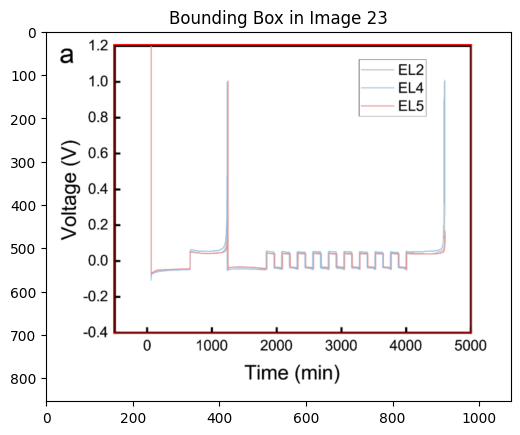

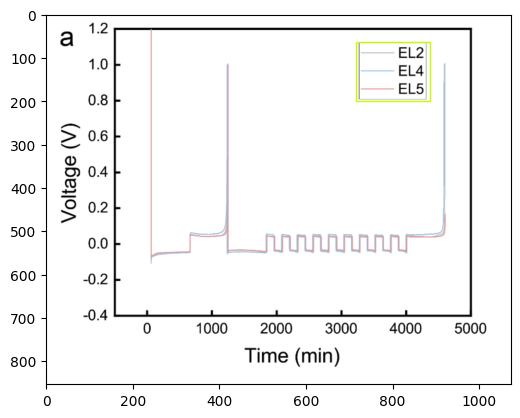

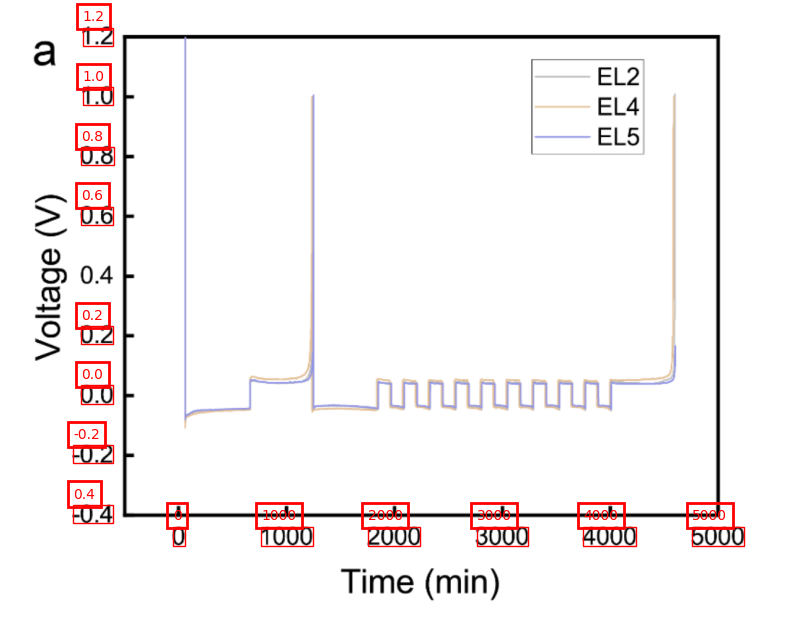

Y MIN 0.4
Y MAX 1.2
SEMANTIC Y MIN 0.4
SEMANTIC Y MAX 1.2
Y
OCR DIFF -662.0
SEM DIFF 0.7999999999999999
OCR RATIO -827.5000000000001
PIXEL DIFF -2.5
REAL DIFF FROM BASE POINT 0.003021148036253776
Y_MIN 0.39697885196374627
Y_MAX 1.2018126888217522
SEMANTIC X MIN 0.0
SEMANTIC X MAX 5000.0
X
OCR DIFF 747.5
SEM DIFF 5000.0
OCR RATIO 6.688963210702341
PIXEL DIFF 77.5
REAL DIFF FROM BASE POINT 518.3946488294314
X_MIN -518.3946488294314
X_MAX 5006.688963210702
X
Predicted [-518.3946488294314, 5006.688963210702]
Chat GPT [0, 5000]
Y
Predicted [0.39697885196374627, 1.2018126888217522]
Chat GPT [-0.4, 1.2]


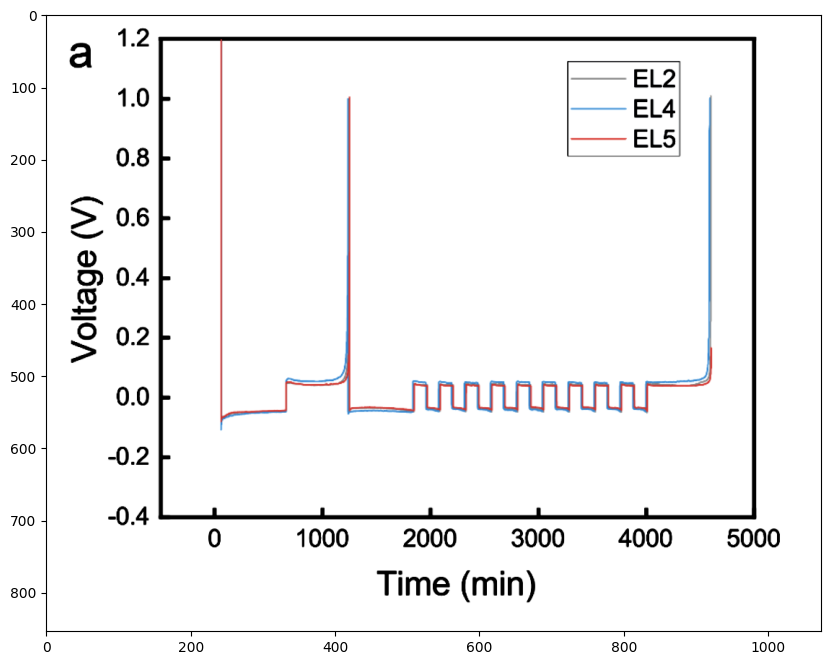

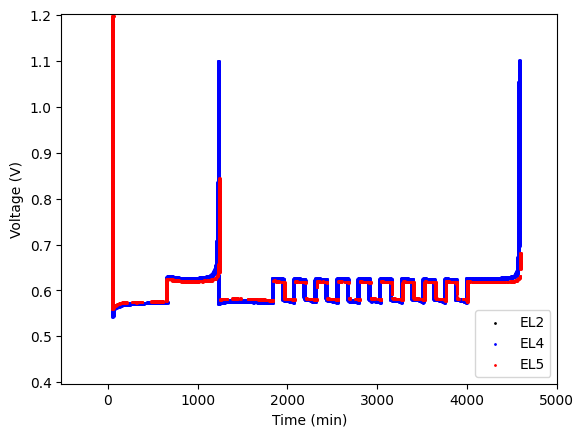

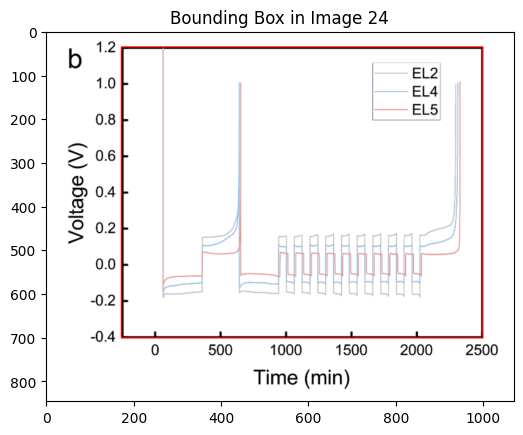

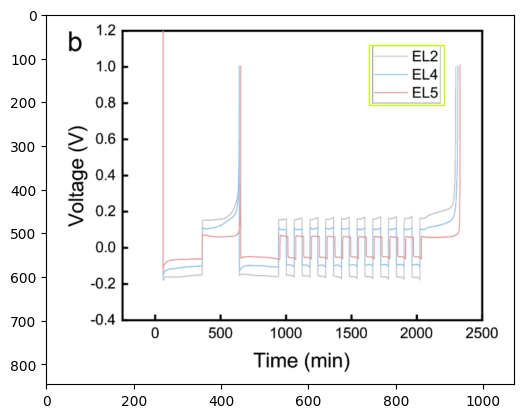

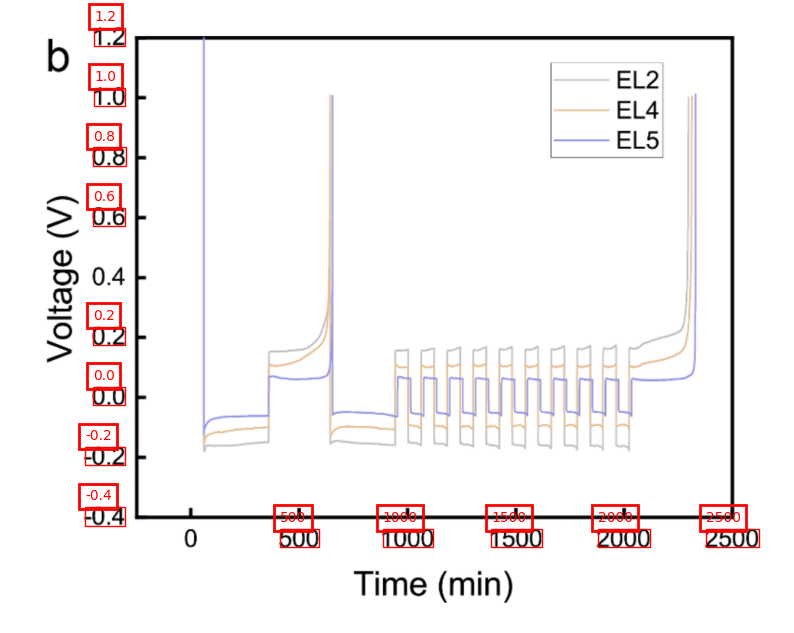

Y MIN -0.4
Y MAX 1.2
SEMANTIC Y MIN -0.4
SEMANTIC Y MAX 1.2
Y
OCR DIFF -662.0
SEM DIFF 1.6
OCR RATIO -413.75
PIXEL DIFF -2.5
REAL DIFF FROM BASE POINT 0.006042296072507553
Y_MIN -0.4060422960725076
Y_MAX 1.2012084592145014
SEMANTIC X MIN 500.0
SEMANTIC X MAX 2500.0
X
OCR DIFF 597.5
SEM DIFF 2000.0
OCR RATIO 3.3472803347280333
PIXEL DIFF 227.0
REAL DIFF FROM BASE POINT 759.8326359832636
X_MIN -259.8326359832636
X_MAX 2505.020920502092
X
Predicted [-259.8326359832636, 2505.020920502092]
Chat GPT [0, 2500]
Y
Predicted [-0.4060422960725076, 1.2012084592145014]
Chat GPT [-0.4, 1.2]


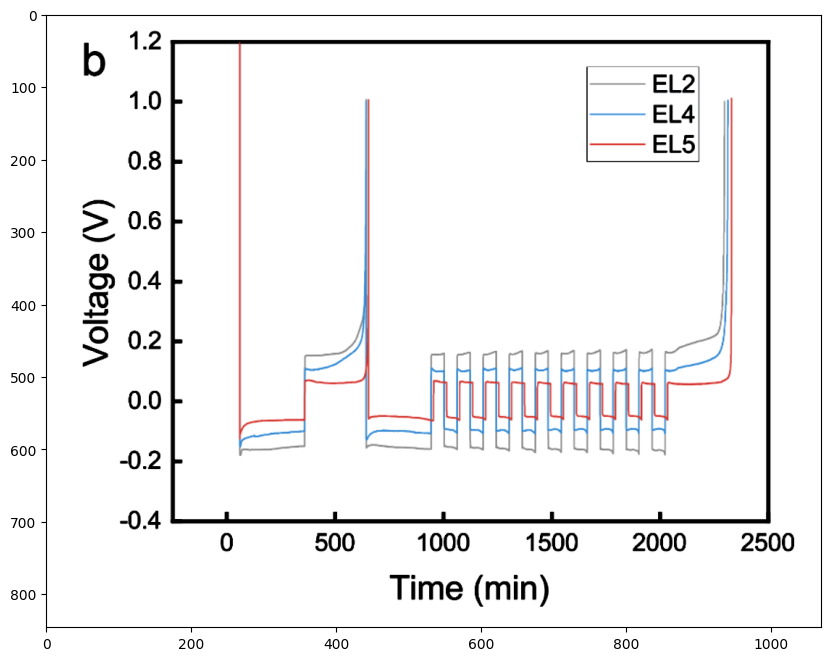

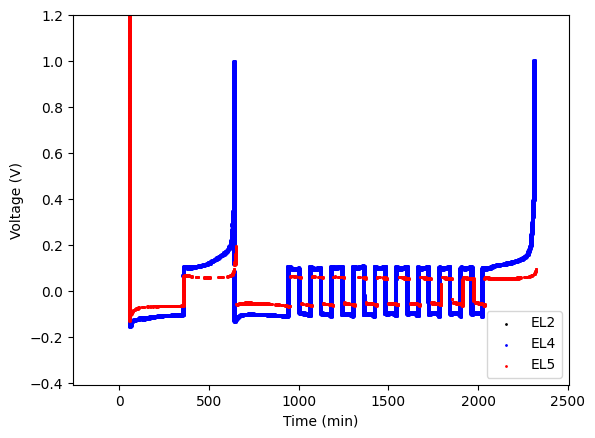

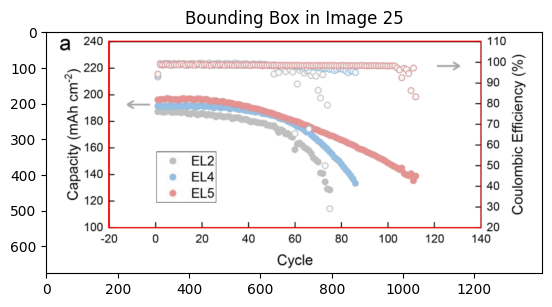

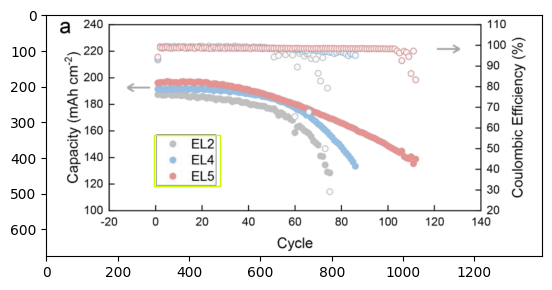

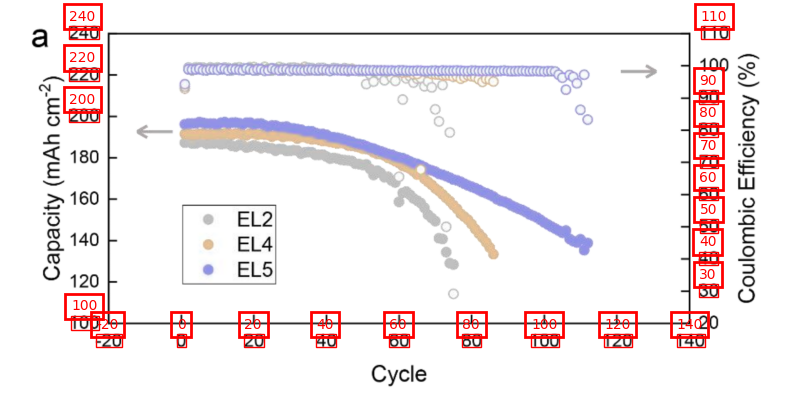

Y MIN 100
Y MAX 240
SEMANTIC Y MIN 100.0
SEMANTIC Y MAX 240.0
Y
OCR DIFF -520.0
SEM DIFF 140.0
OCR RATIO -3.7142857142857144
PIXEL DIFF -1.5
REAL DIFF FROM BASE POINT 0.40384615384615385
Y_MIN 99.59615384615384
Y_MAX 239.8653846153846
SEMANTIC X MIN -20.0
SEMANTIC X MAX 140.0
X
OCR DIFF 1043.5
SEM DIFF 160.0
OCR RATIO 0.15333013895543843
PIXEL DIFF 2.0
REAL DIFF FROM BASE POINT 0.30666027791087686
X_MIN -20.306660277910876
X_MAX 139.77000479156683
X
Predicted [-20.306660277910876, 139.77000479156683]
Chat GPT [-20, 140]
Y
Predicted [99.59615384615384, 239.8653846153846]
Chat GPT [100, 240]


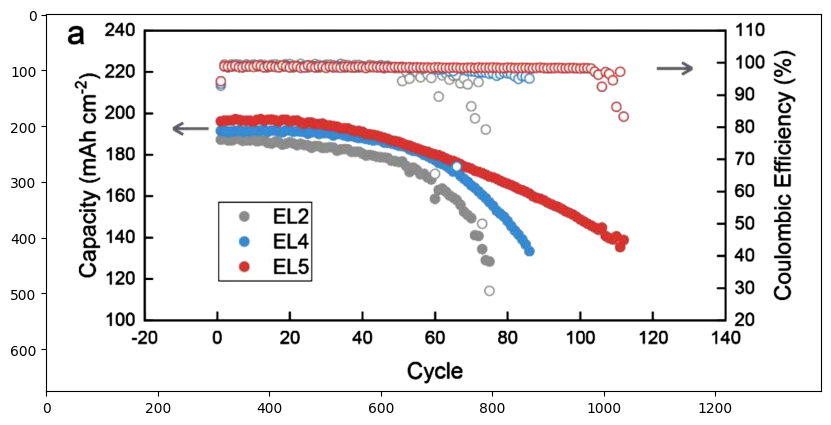

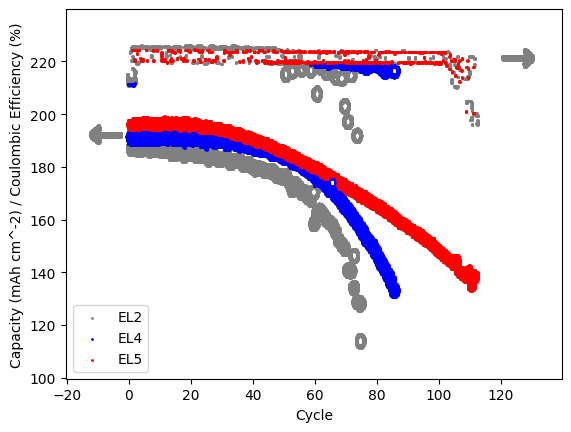

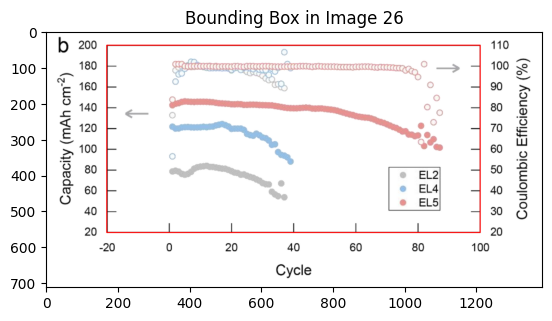

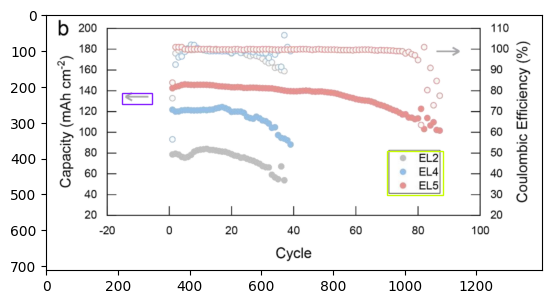

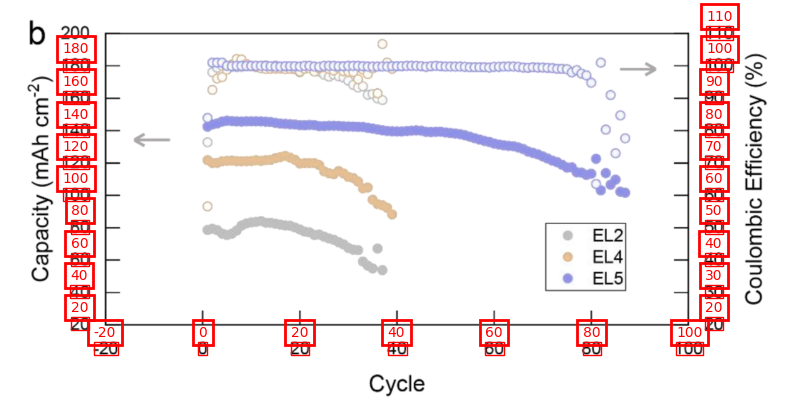

Y MIN 20
Y MAX 180
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 180.0
Y
OCR DIFF -461.5
SEM DIFF 160.0
OCR RATIO -2.884375
PIXEL DIFF -2.5
REAL DIFF FROM BASE POINT 0.866738894907909
Y_MIN 19.133261105092092
Y_MAX 199.76164680390033
SEMANTIC X MIN -20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 1042.5
SEM DIFF 120.0
OCR RATIO 0.11510791366906475
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT 0.17266187050359713
X_MIN -20.172661870503596
X_MAX 99.76978417266187
X
Predicted [-20.172661870503596, 99.76978417266187]
Chat GPT [-20, 100]
Y
Predicted [19.133261105092092, 199.76164680390033]
Chat GPT [20, 200]


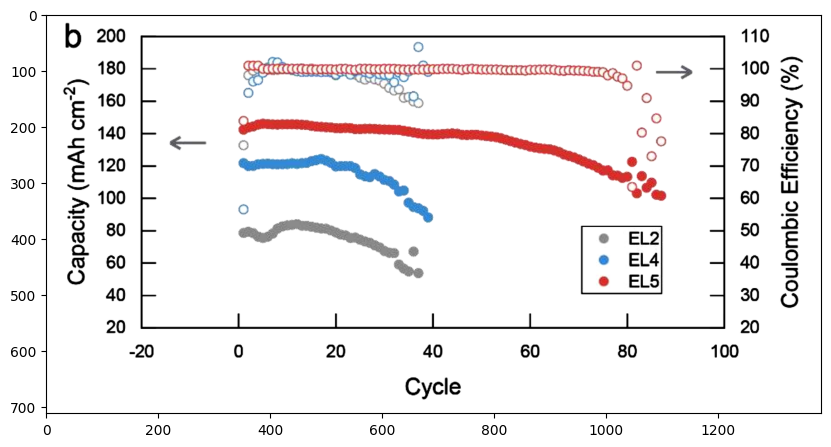

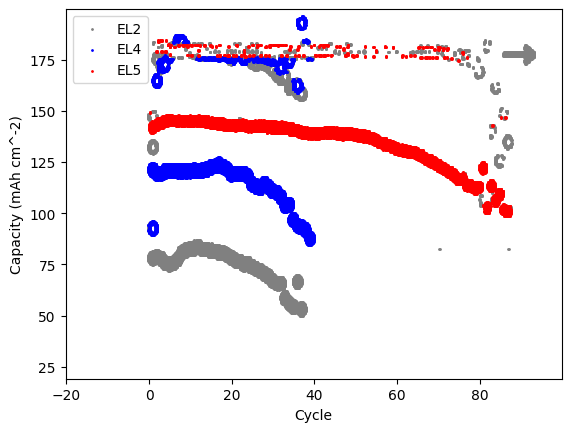

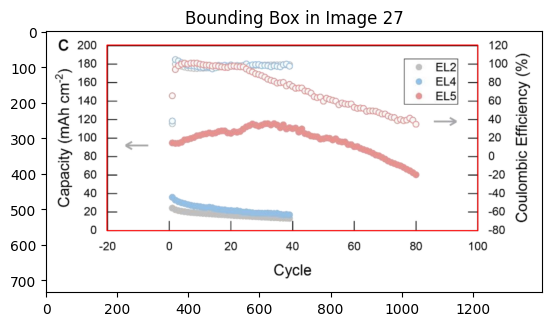

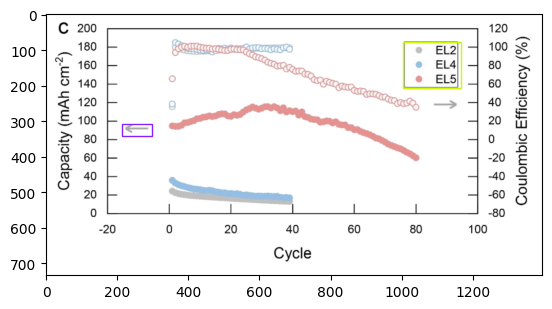

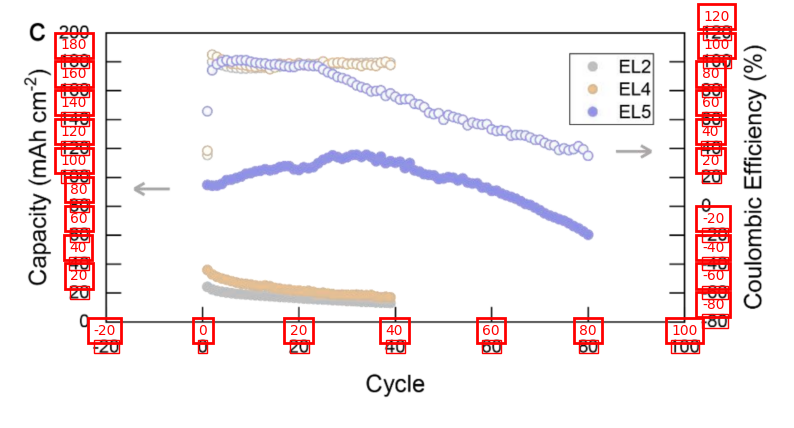

Y MIN 20
Y MAX 180
SEMANTIC Y MIN 20.0
SEMANTIC Y MAX 180.0
Y
OCR DIFF -416.0
SEM DIFF 160.0
OCR RATIO -2.6
PIXEL DIFF -54.0
REAL DIFF FROM BASE POINT 20.76923076923077
Y_MIN -0.76923076923077
Y_MAX 200.0
SEMANTIC X MIN -20.0
SEMANTIC X MAX 100.0
X
OCR DIFF 1043.5
SEM DIFF 120.0
OCR RATIO 0.11499760421657883
PIXEL DIFF 1.5
REAL DIFF FROM BASE POINT 0.17249640632486823
X_MIN -20.172496406324868
X_MAX 99.88500239578343
X
Predicted [-20.172496406324868, 99.88500239578343]
Chat GPT [-20, 100]
Y
Predicted [-0.76923076923077, 200.0]
Chat GPT [0, 200]


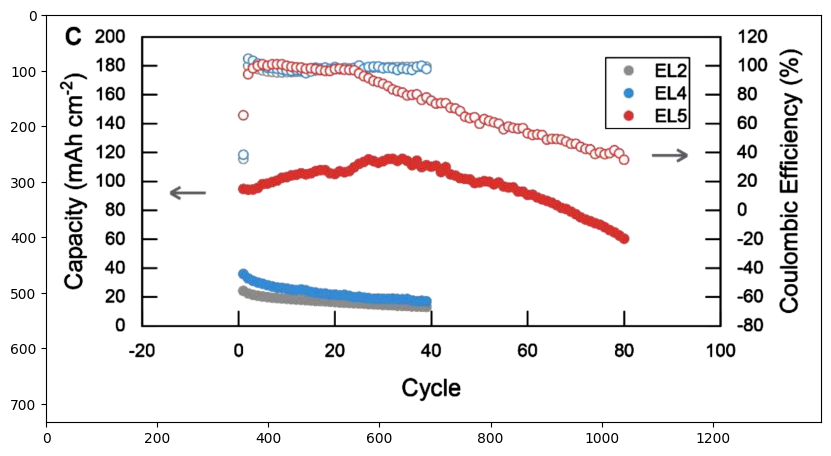

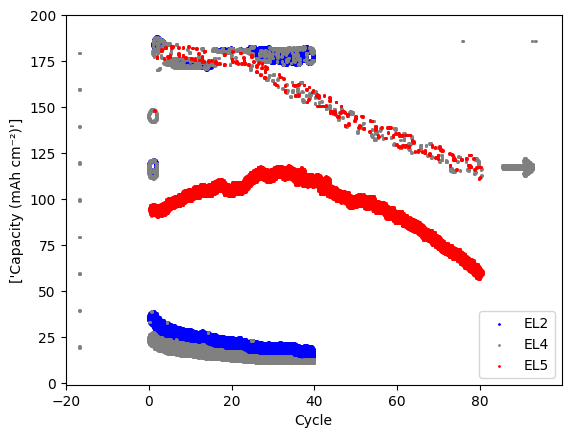

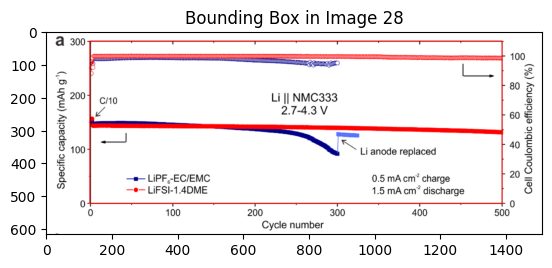

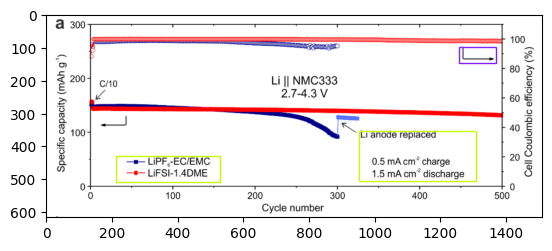

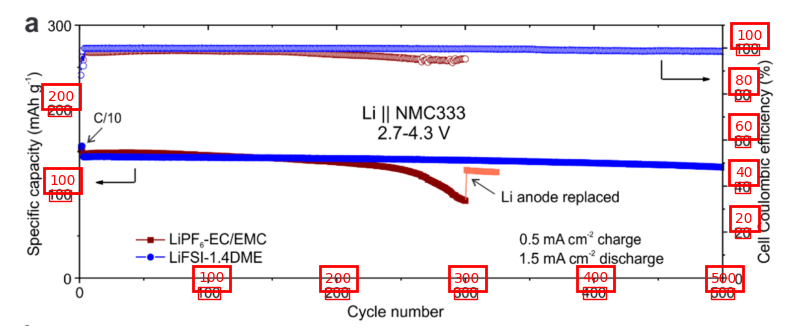

Y MIN 100
Y MAX 200
SEMANTIC Y MIN 100.0
SEMANTIC Y MAX 200.0
Y
OCR DIFF -164.0
SEM DIFF 100.0
OCR RATIO -1.64
PIXEL DIFF -162.5
REAL DIFF FROM BASE POINT 99.08536585365854
Y_MIN 0.9146341463414558
Y_MAX 301.5243902439024
SEMANTIC X MIN 100.0
SEMANTIC X MAX 500.0
X
OCR DIFF 1001.5
SEM DIFF 400.0
OCR RATIO 0.39940089865202194
PIXEL DIFF 254.0
REAL DIFF FROM BASE POINT 101.44782825761358
X_MIN -1.4478282576135797
X_MAX 499.80029955067397
X
Predicted [-1.4478282576135797, 499.80029955067397]
Chat GPT [0, 500]
Y
Predicted [0.9146341463414558, 301.5243902439024]
Chat GPT [0, 300]


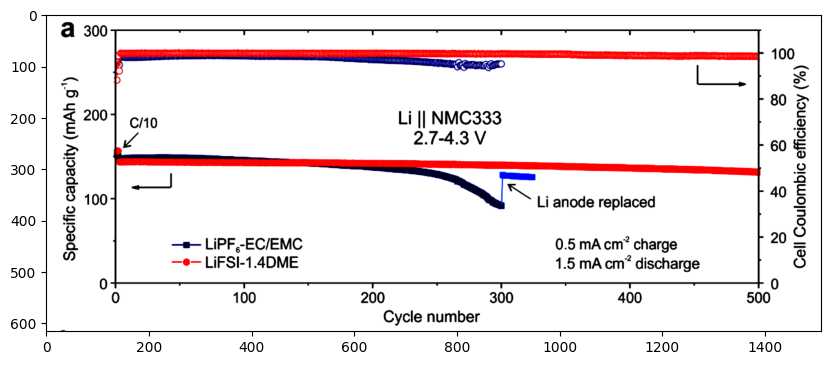

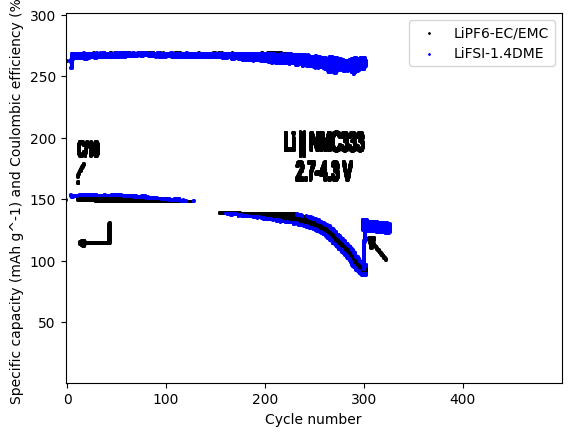

In [12]:
for image_num in range(1,29):
    coordinates, x_axis_title, y_axis_title, axis_labels, rgb_colors, x_range, y_range, memo = get_reconstructed_plot(image_num, predictor, model, pipeline, True, 30)
        
    plt.figure()
    for index, value in enumerate(coordinates):
        x = []
        y = []

        for i in range(len(value)):
            x.append(value[i]["middle"][0])
            y.append(value[i]["middle"][1])

        color_normalized = rgb_colors[index]

        if (is_valid_color(color_normalized)): plt.scatter(x, y, label=axis_labels[index], color=color_normalized, s=1)

    plt.xlim(x_range[0], x_range[1])
    plt.ylim(y_range[0], y_range[1])
    plt.xlabel(x_axis_title)
    plt.ylabel(y_axis_title)
    plt.legend()
    plt.show()